In [10]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import scipy as sp
from scipy.stats import pointbiserialr
import networkx as nx

import warnings
warnings.filterwarnings("ignore")
import random

numberOfTimeStep = 14
norm = "robustNorm"

## Features

In [11]:
folders = ["s1", "s2", "s3"]

keys = ['AMG', 'ATF', 'ATI', 'ATP', 'CAR', 'CF1', 'CF2', 'CF3', 'CF4', 'Falta',
        'GCC', 'GLI', 'LIN', 'LIP', 'MAC', 'MON', 'NTI', 'OTR', 'OXA', 'PAP',
        'PEN', 'POL', 'QUI', 'SUL', 'TTC',
        'MV hours', '# pat$_{atb}$', '# pat$_{MDR}$',
        'CAR$_{n}$', 'PAP$_{n}$', 'Falta$_{n}$',
        'QUI$_{n}$', 'ATF$_{n}$', 'OXA$_{n}$', 'PEN$_{n}$',
        'CF3$_{n}$', 'GLI$_{n}$', 'CF4$_{n}$', 'SUL$_{n}$',
        'NTI$_{n}$', 'LIN$_{n}$', 'AMG$_{n}$', 'MAC$_{n}$',
        'CF1$_{n}$', 'GCC$_{n}$', 'POL$_{n}$', 'ATI$_{n}$',
        'MON$_{n}$', 'LIP$_{n}$', 'TTC$_{n}$', 'OTR$_{n}$',
        'CF2$_{n}$', 'ATP$_{n}$', 
        '# pat$_{tot}$',
        'Post change',
        'Insulin', 'Art nutrition', 'Sedation', 'Relax', 'Hepatic$_{fail}$',
        'Renal$_{fail}$', 'Coagulation$_{fail}$', 'Hemodynamic$_{fail}$',
        'Respiratory$_{fail}$', 'Multiorganic$_{fail}$',  '# transfusions',
        'Vasoactive drug', 'Dosis nems', 'Tracheo$_{hours}$', 'Ulcer$_{hours}$',
        'Hemo$_{hours}$', 'C01 PICC 1',
        'C01 PICC 2', 'C02 CVC - RJ',
        'C02 CVC - RS', 'C02 CVC - LS', 'C02 CVC - RF',
        'C02 CVC - LJ', 'C02 CVC - LF', '# catheters']

binary = ['AMG', 'ATF', 'ATI', 'ATP', 'CAR', 'CF1',
            'CF2', 'CF3', 'CF4', 'Falta', 'GCC', 'GLI', 'LIN', 'LIP', 'MAC',
            'MON', 'NTI', 'OTR', 'OXA', 'PAP', 'PEN', 'POL', 'QUI', 'SUL', 'TTC',
            'Post change',
            'Insulin', 'Art nutrition', 'Sedation', 'Relax', 'Hepatic$_{fail}$',
            'Renal$_{fail}$', 'Coagulation$_{fail}$', 'Hemodynamic$_{fail}$',
            'Respiratory$_{fail}$', 'Multiorganic$_{fail}$',  'Vasoactive drug']

continues =  [variable for variable in keys if variable not in binary]

## Correlations between variables
- B-B: Phi 
- C-C: Pearson
- B-C: Point Biserial

In [12]:
def phi_coefficient(observed):
    """
    This function calculates the Phi coefficient, a measure of association for two binary variables.
    """
    n = observed.sum()
    row_sum = observed.sum(axis=1)
    col_sum = observed.sum(axis=0)
    
    expected = np.outer(row_sum, col_sum) / n
    
    numerator = (observed - expected)**2
    denominator = expected
    
    phi = np.sqrt(numerator.sum() / denominator.sum())
    
    return phi

#### A) Graph by time step

========> Folder s1
==============> Time step 0


<Figure size 432x288 with 0 Axes>

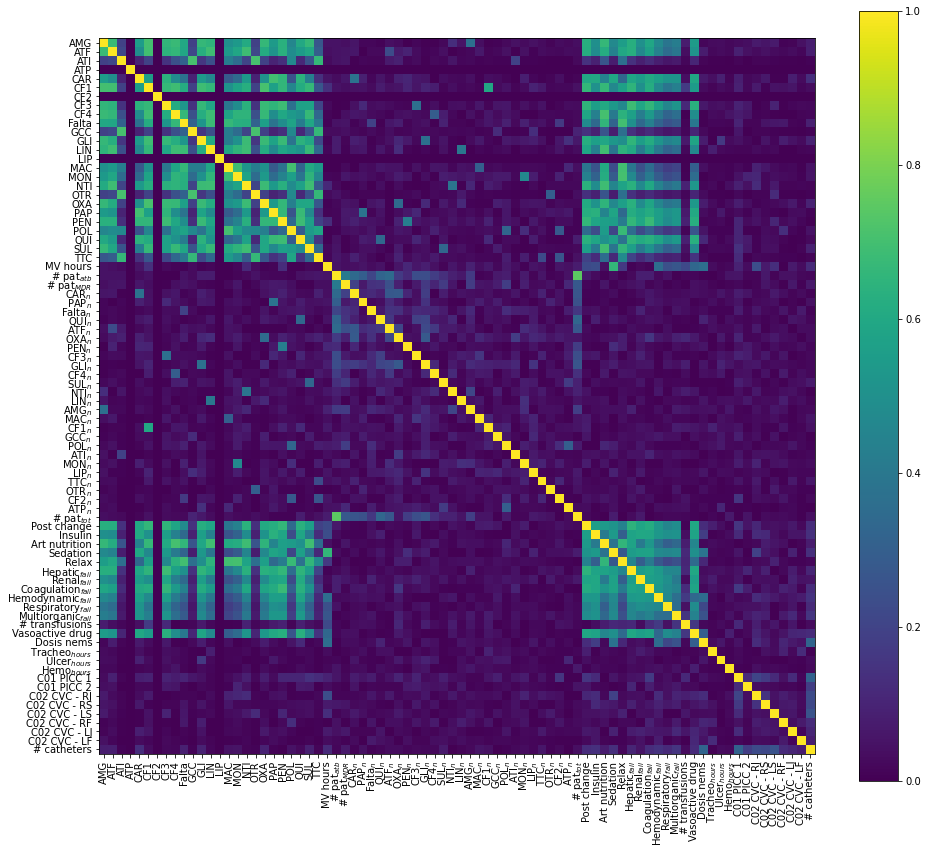

==============> Time step 1


<Figure size 432x288 with 0 Axes>

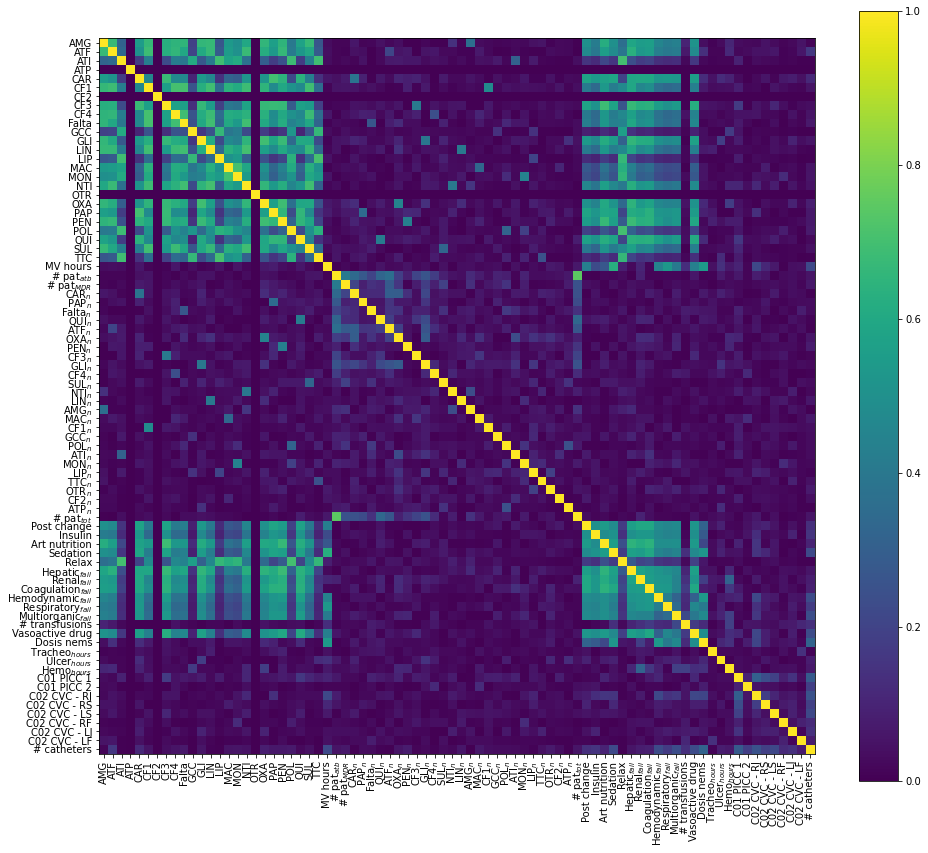

==============> Time step 2


<Figure size 432x288 with 0 Axes>

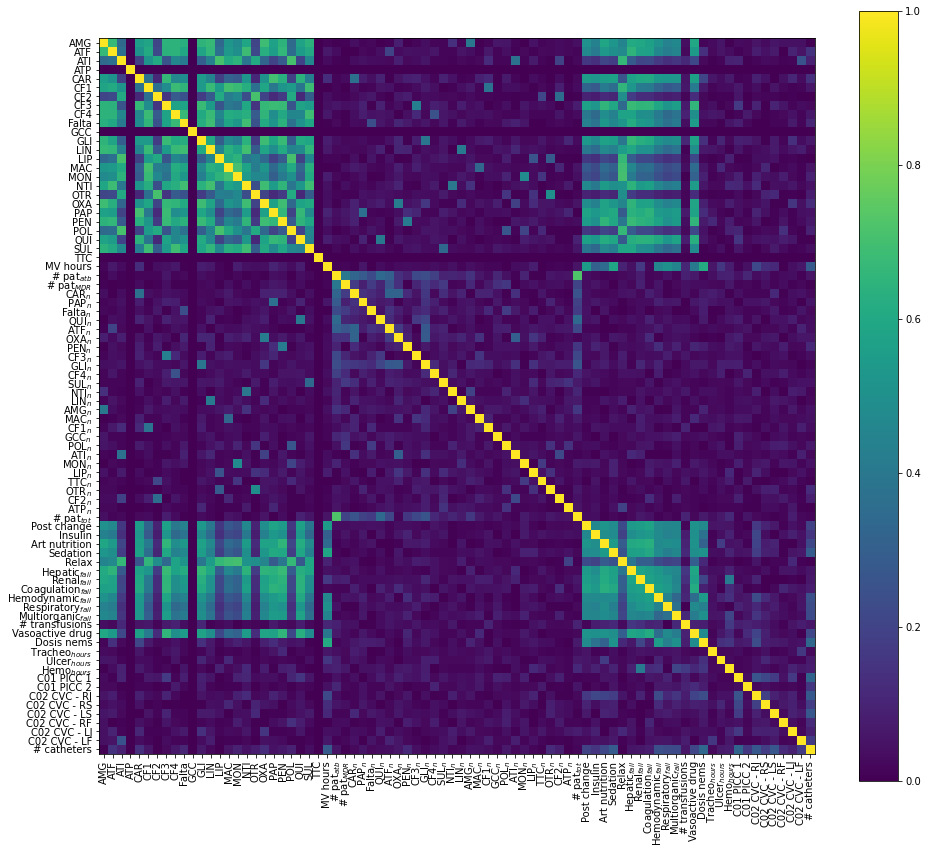

==============> Time step 3


<Figure size 432x288 with 0 Axes>

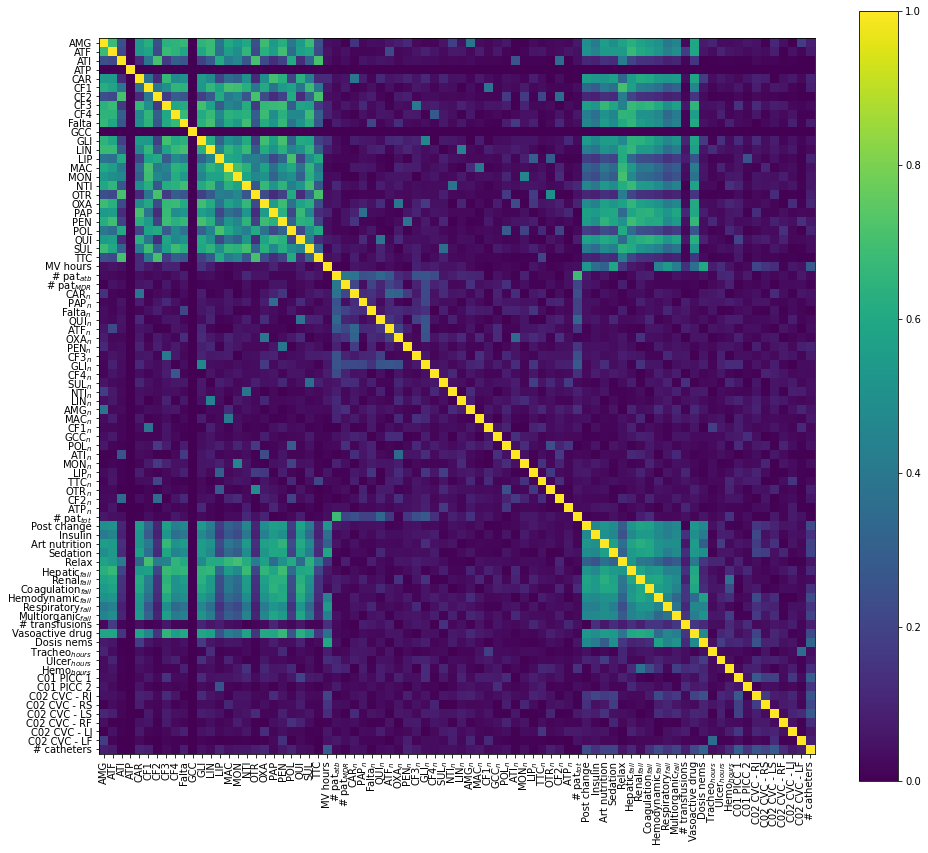

==============> Time step 4


<Figure size 432x288 with 0 Axes>

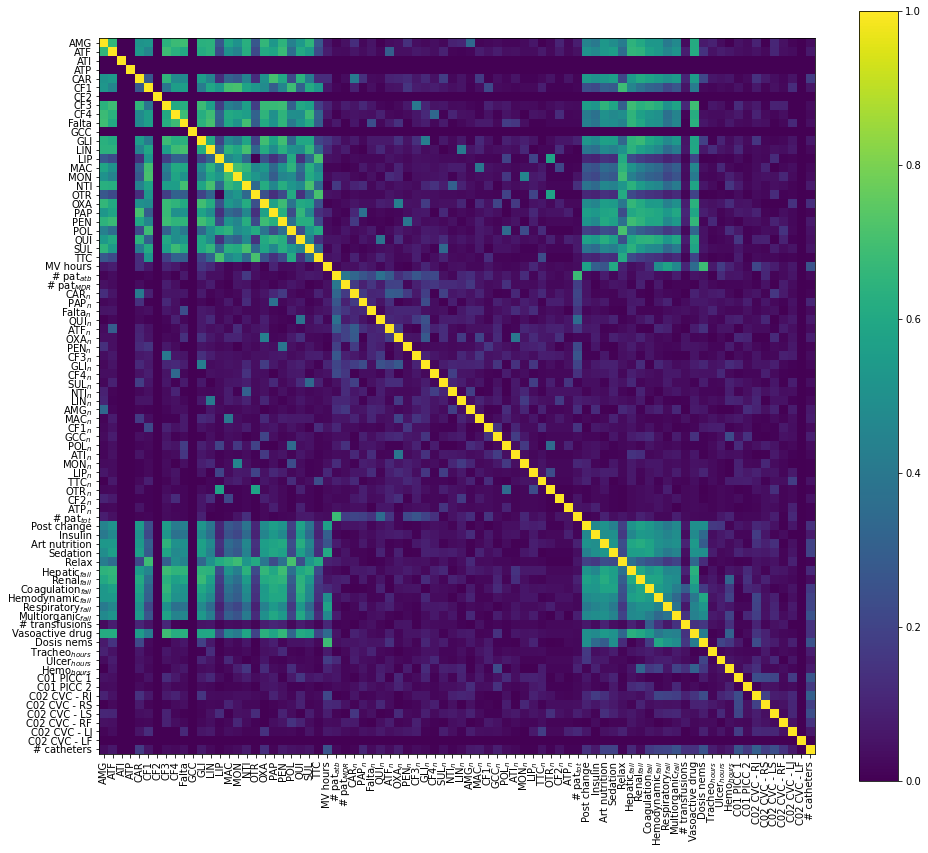

==============> Time step 5


<Figure size 432x288 with 0 Axes>

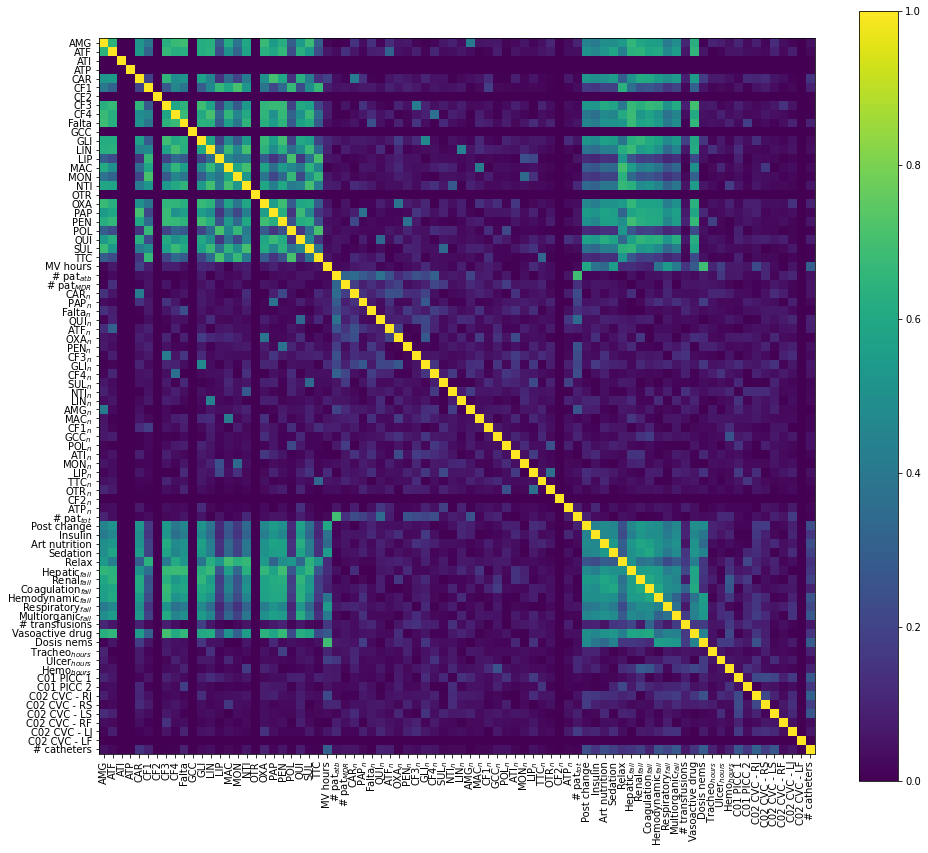

==============> Time step 6


<Figure size 432x288 with 0 Axes>

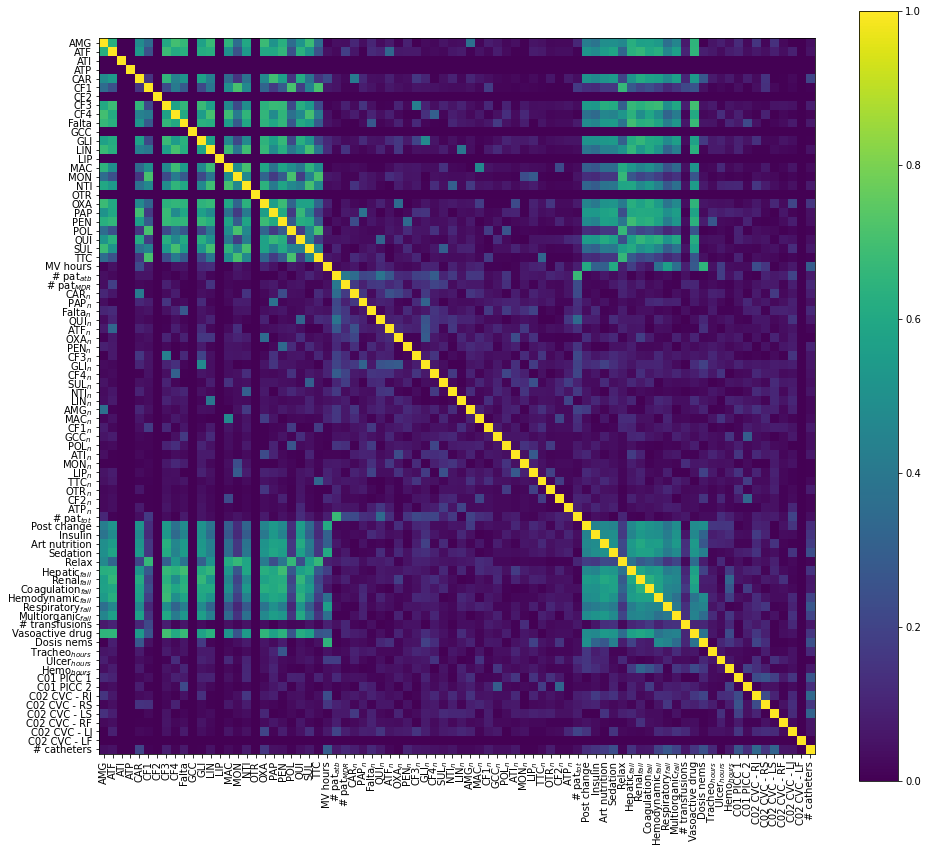

==============> Time step 7


<Figure size 432x288 with 0 Axes>

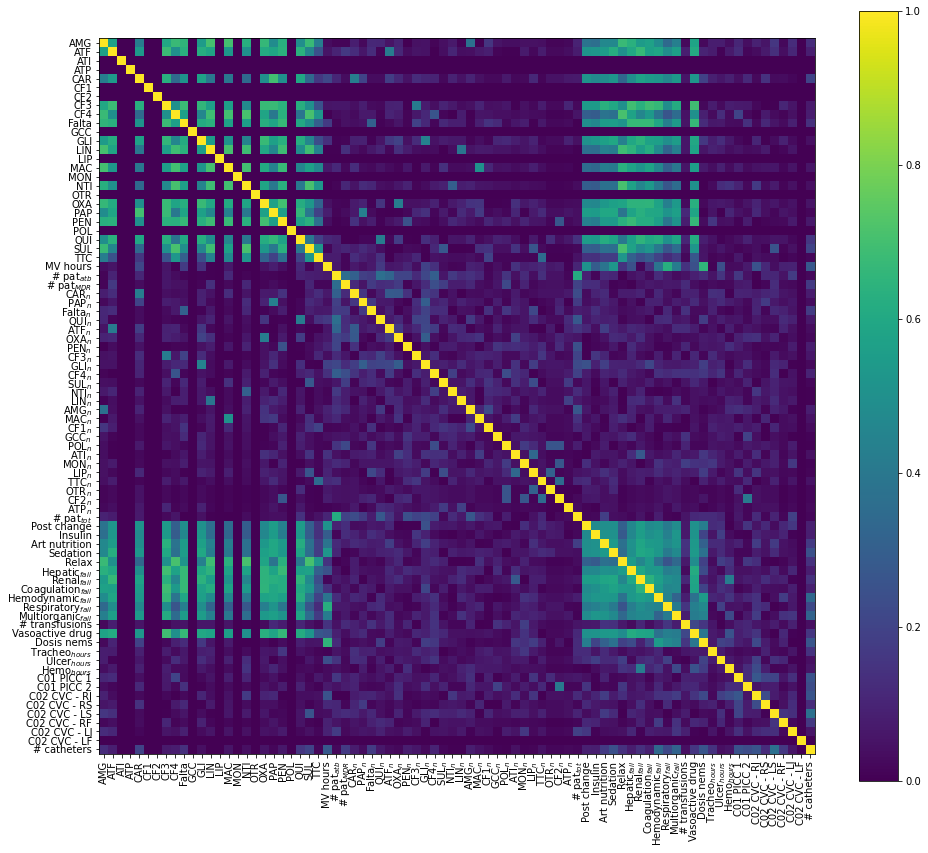

==============> Time step 8


<Figure size 432x288 with 0 Axes>

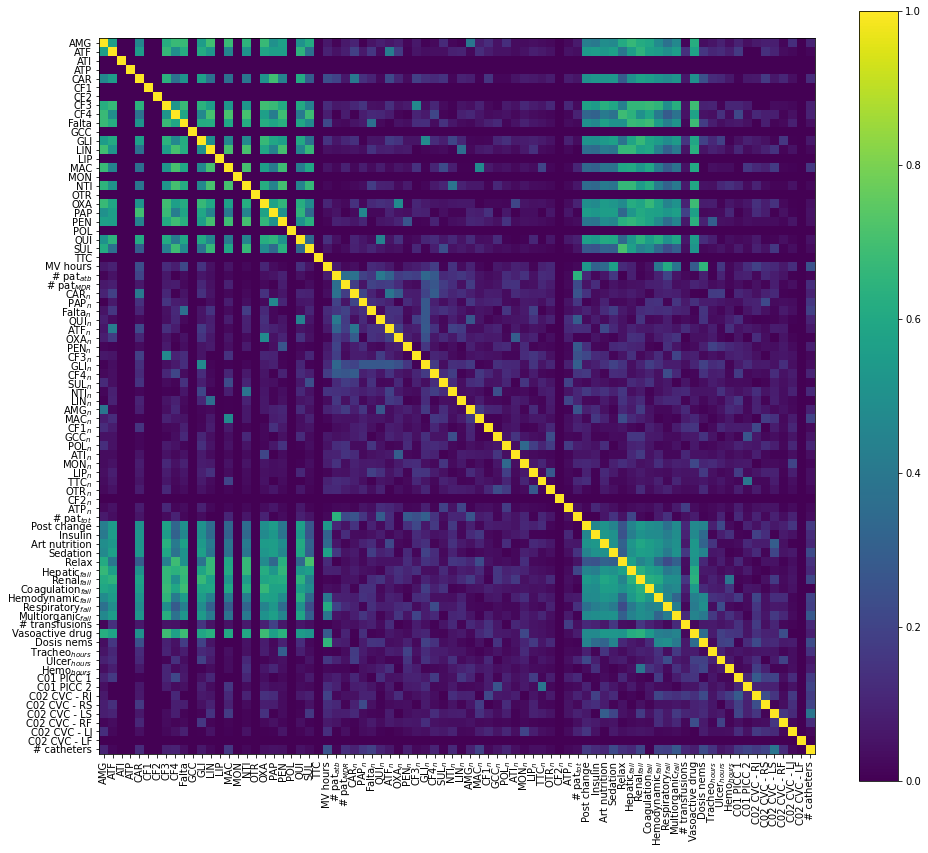

==============> Time step 9


<Figure size 432x288 with 0 Axes>

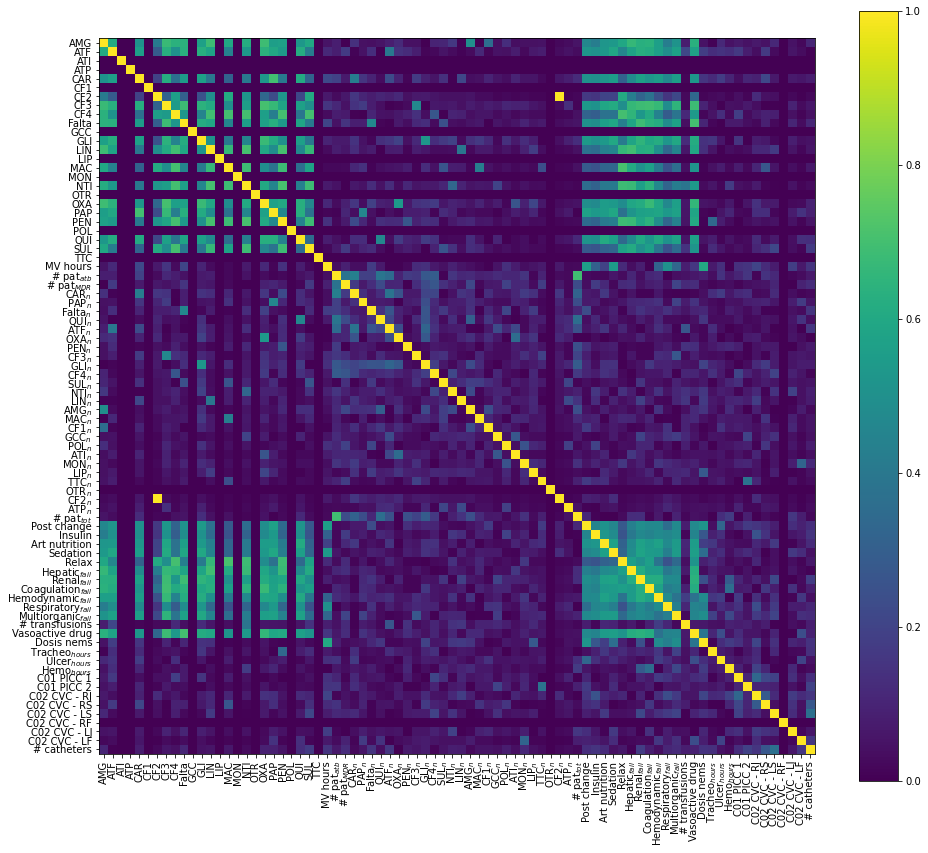

==============> Time step 10


<Figure size 432x288 with 0 Axes>

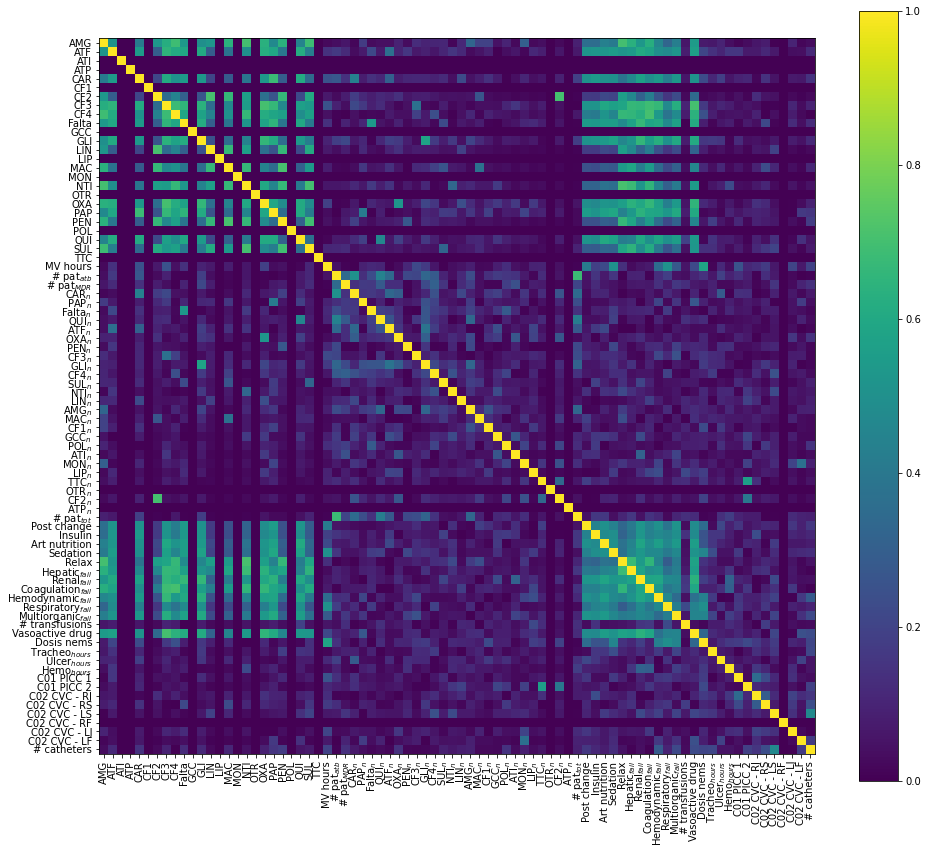

==============> Time step 11


<Figure size 432x288 with 0 Axes>

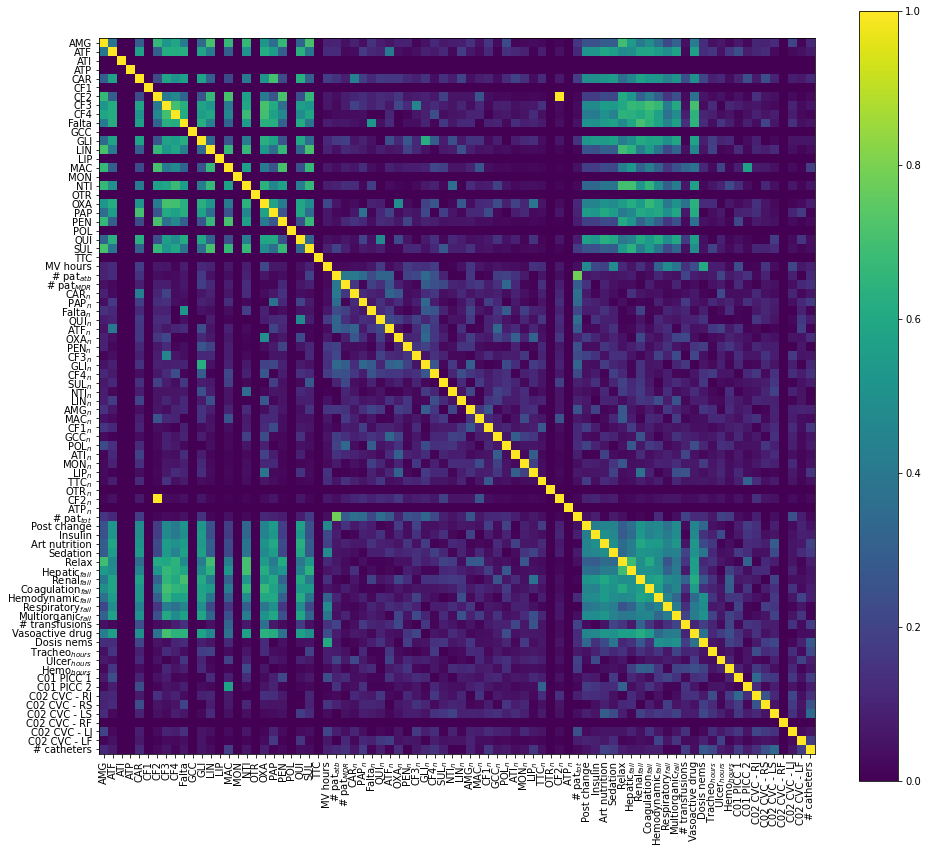

==============> Time step 12


<Figure size 432x288 with 0 Axes>

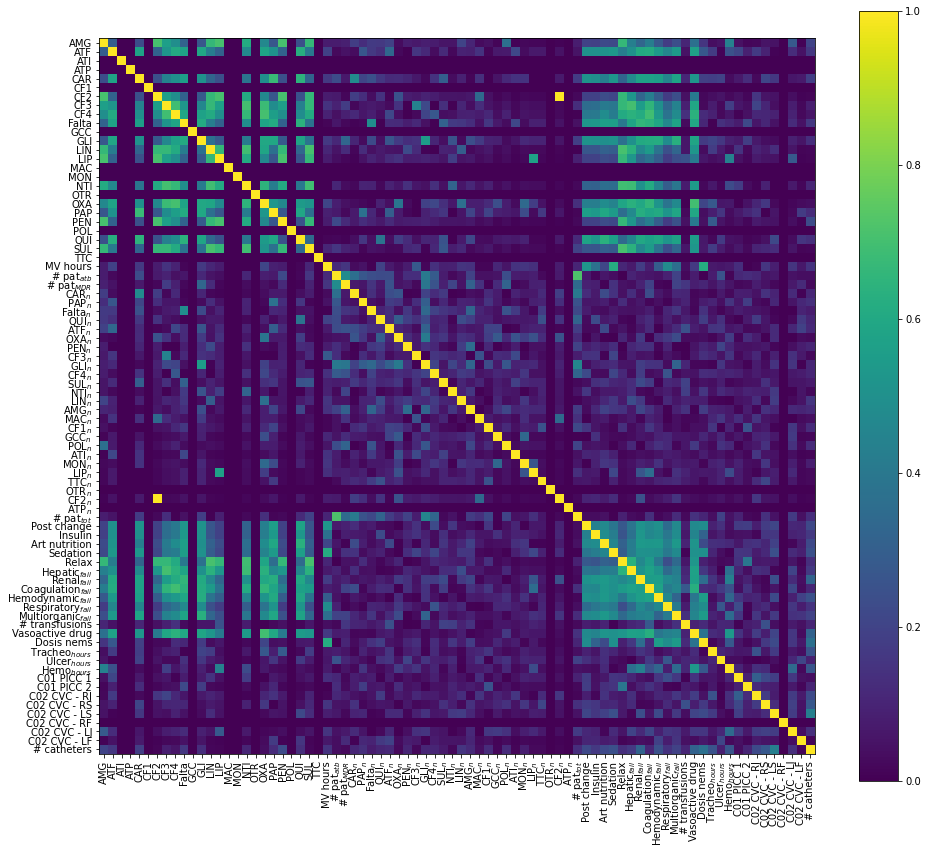

==============> Time step 13


<Figure size 432x288 with 0 Axes>

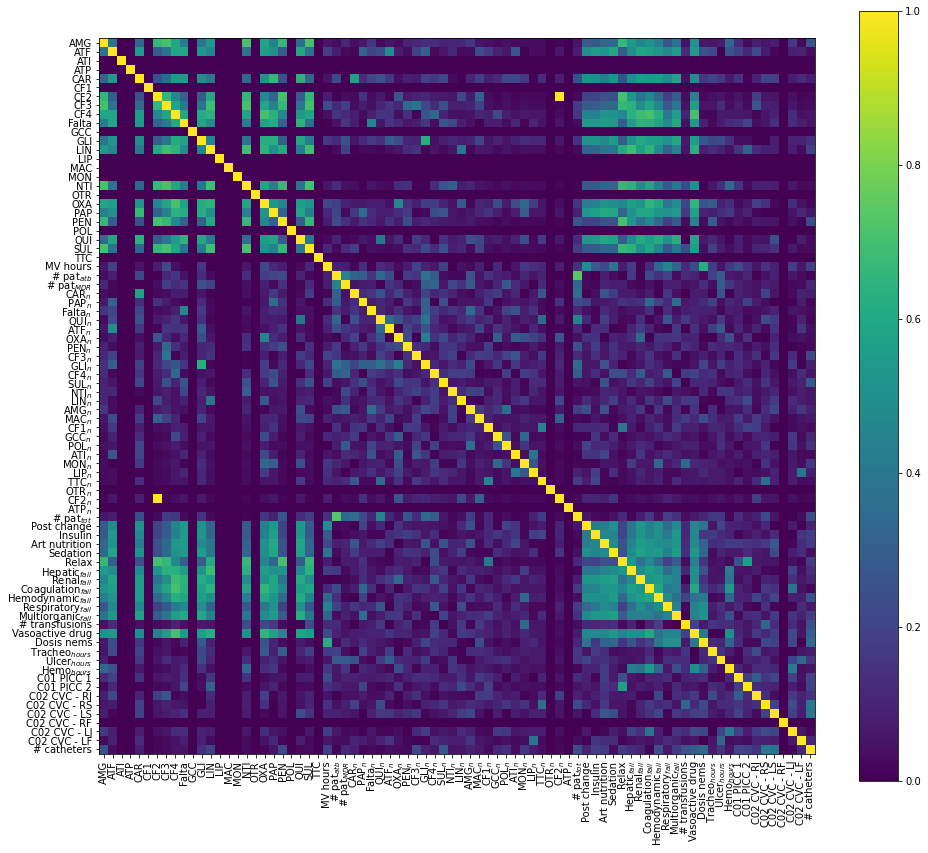

========> Folder s2
==============> Time step 0


<Figure size 432x288 with 0 Axes>

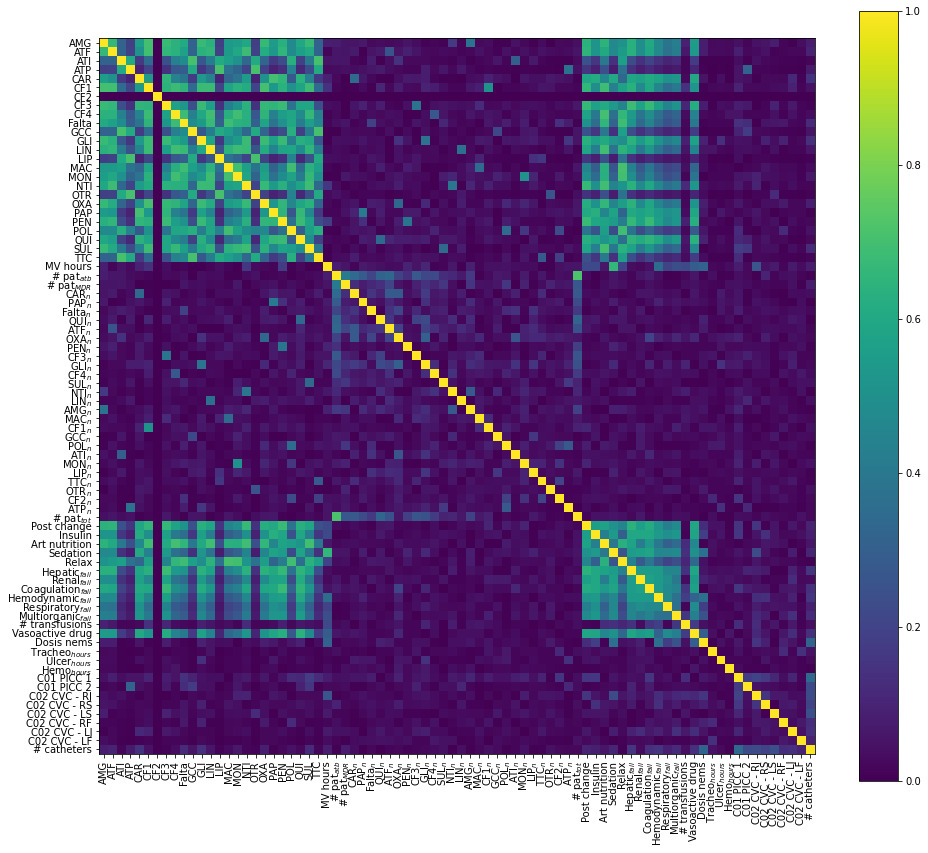

==============> Time step 1


<Figure size 432x288 with 0 Axes>

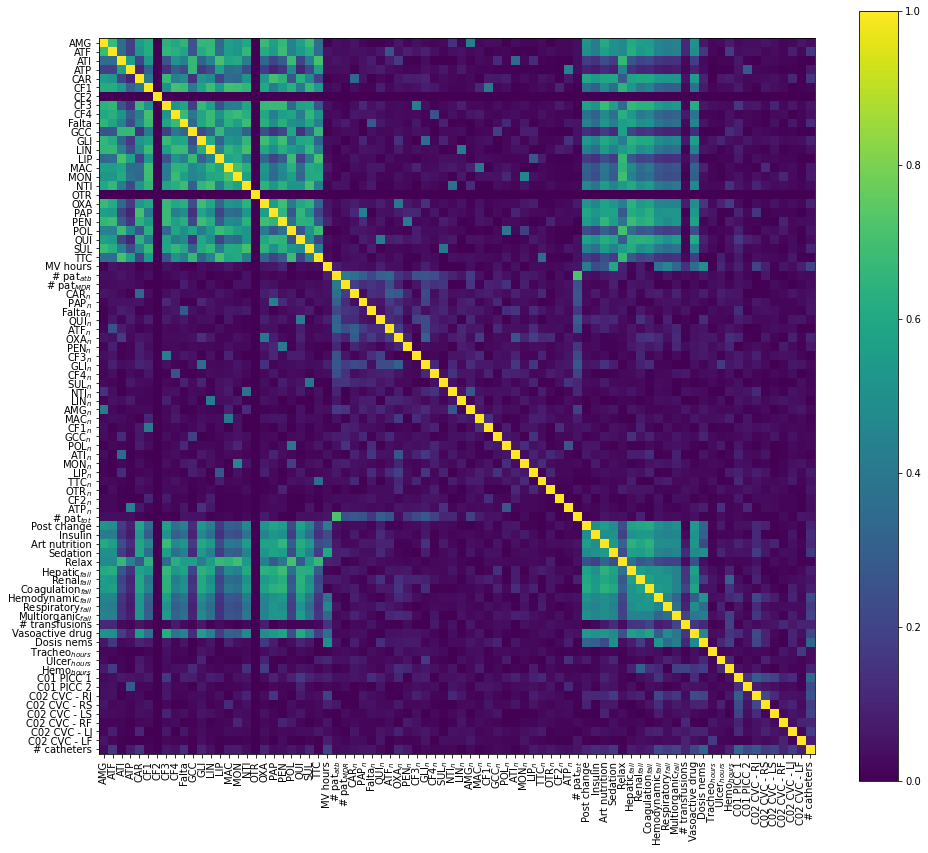

==============> Time step 2


<Figure size 432x288 with 0 Axes>

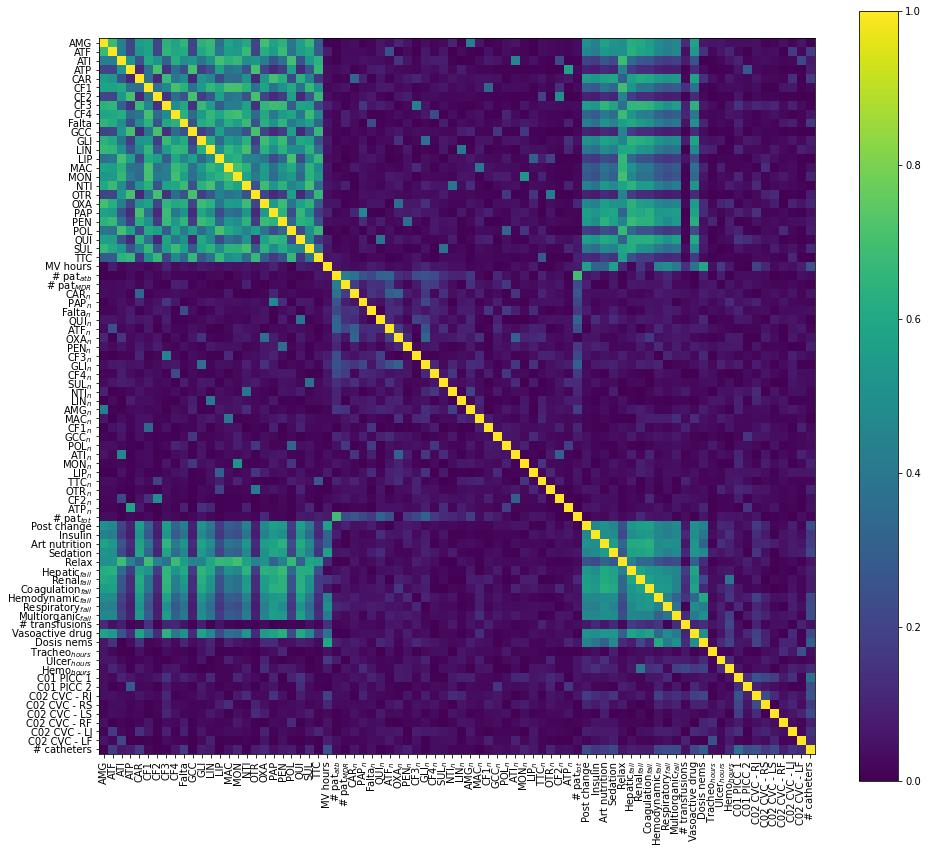

==============> Time step 3


<Figure size 432x288 with 0 Axes>

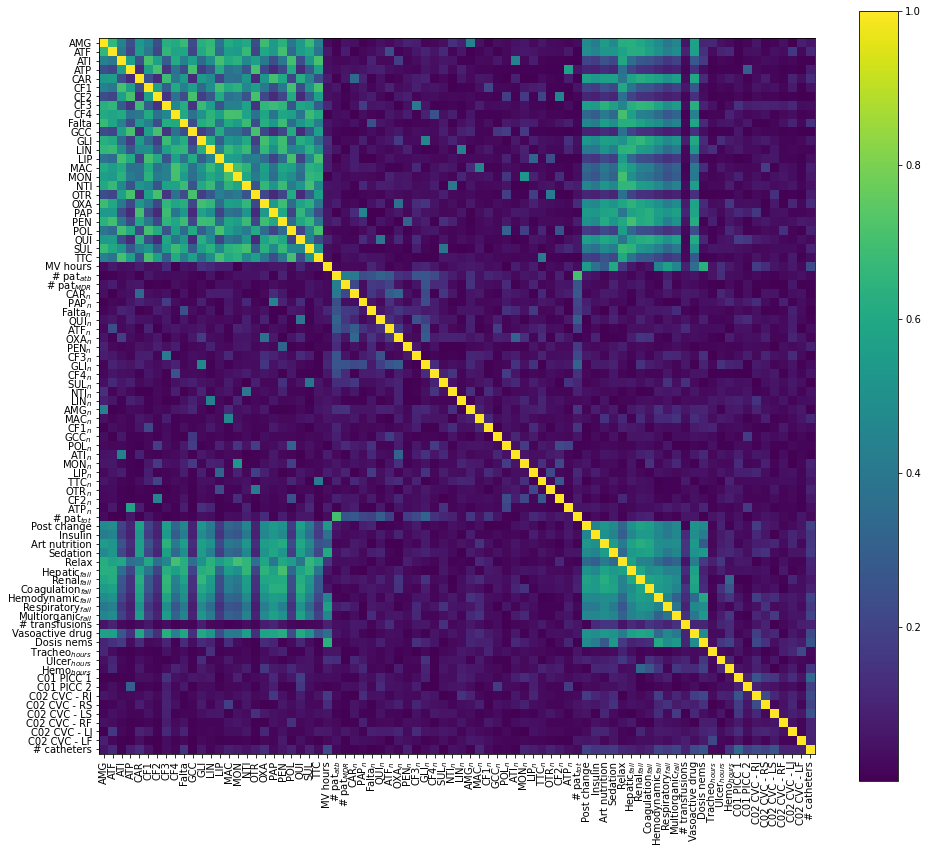

==============> Time step 4


<Figure size 432x288 with 0 Axes>

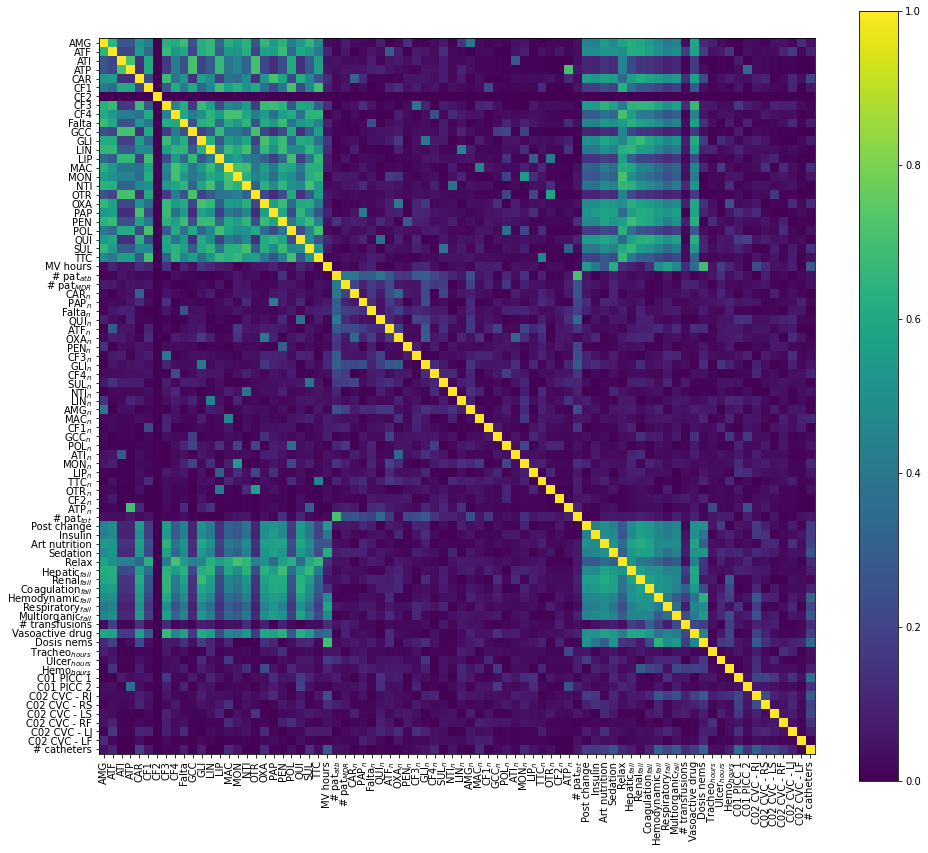

==============> Time step 5


<Figure size 432x288 with 0 Axes>

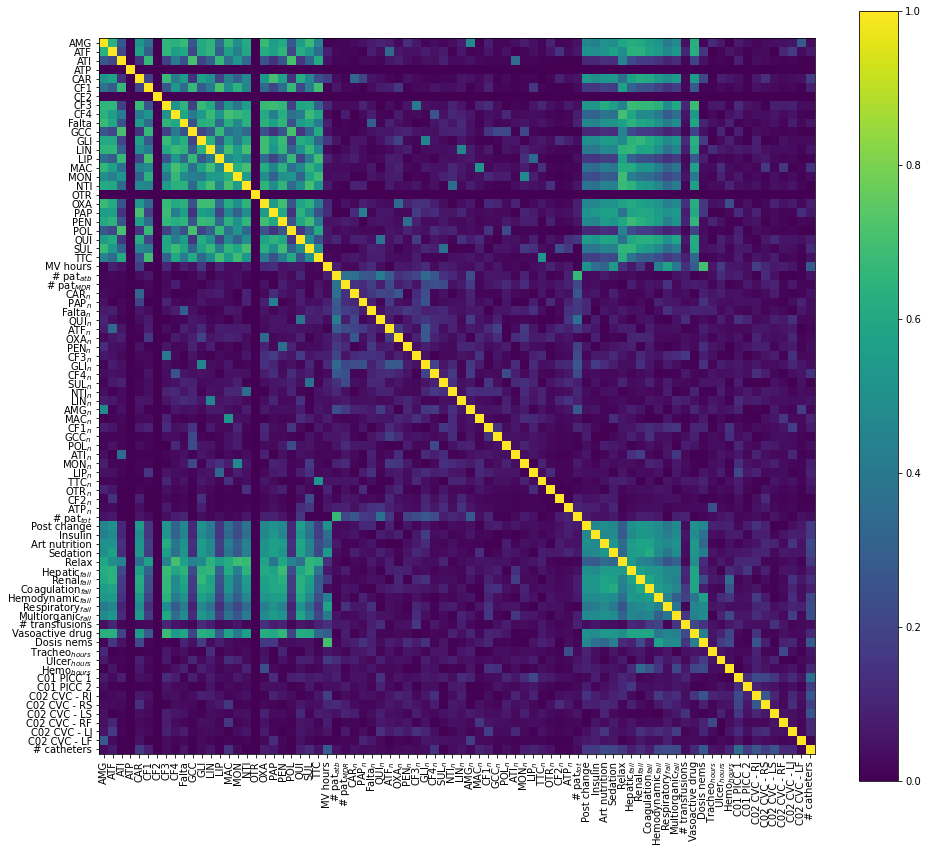

==============> Time step 6


<Figure size 432x288 with 0 Axes>

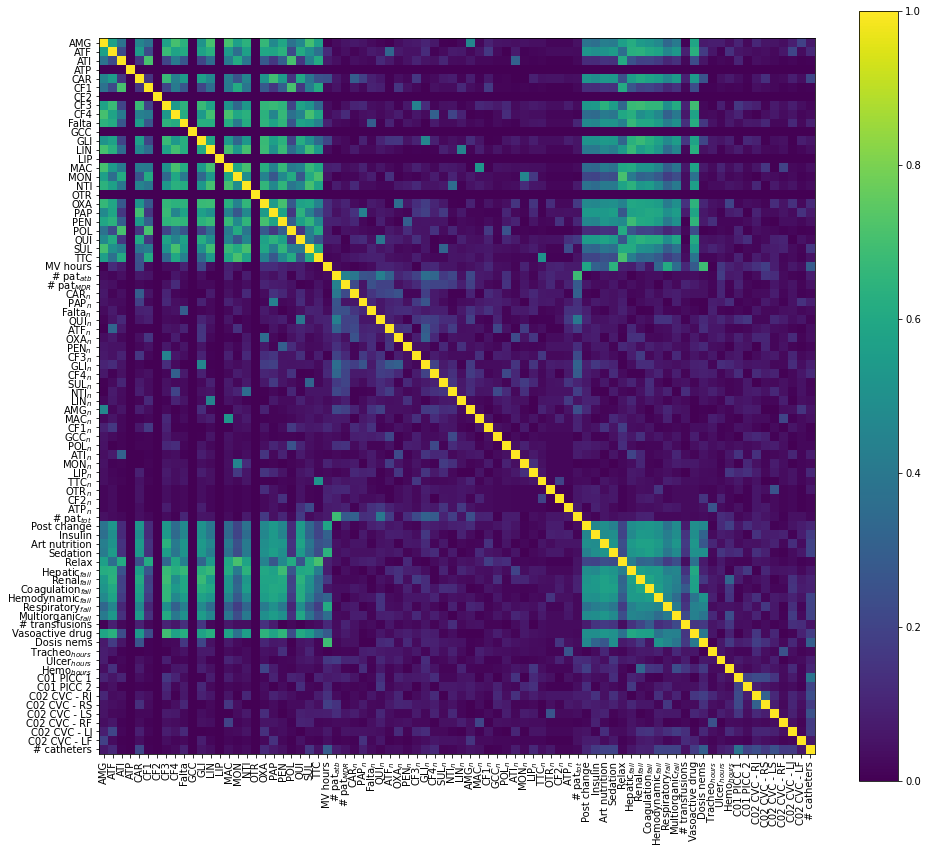

==============> Time step 7


<Figure size 432x288 with 0 Axes>

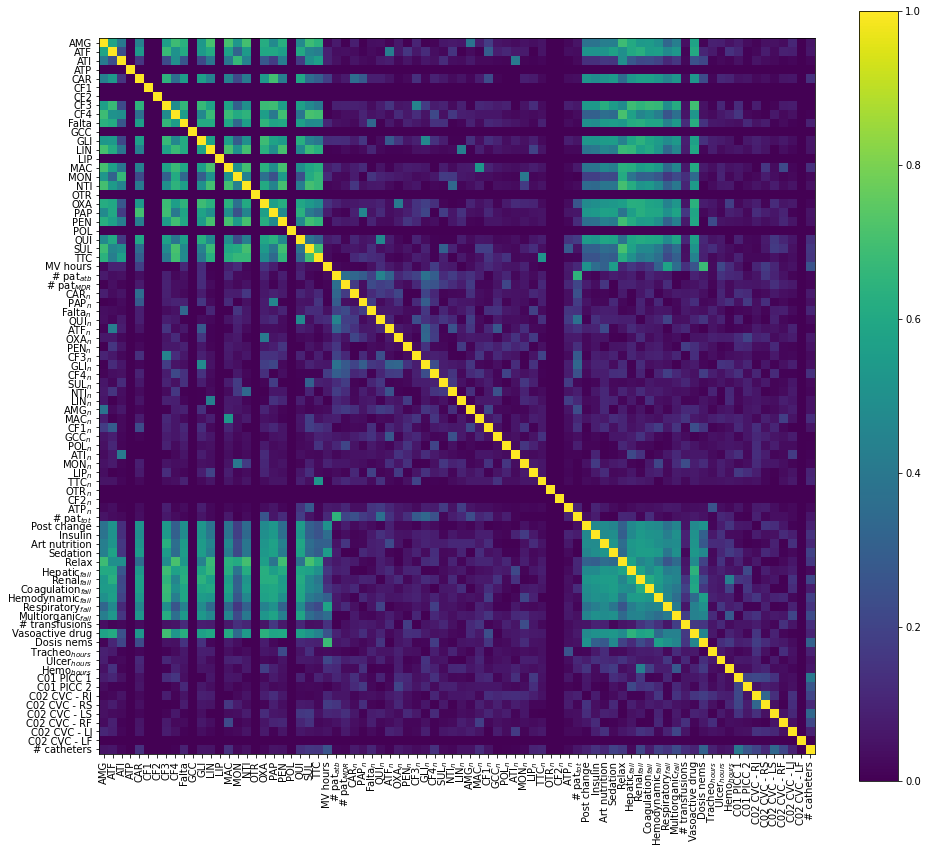

==============> Time step 8


<Figure size 432x288 with 0 Axes>

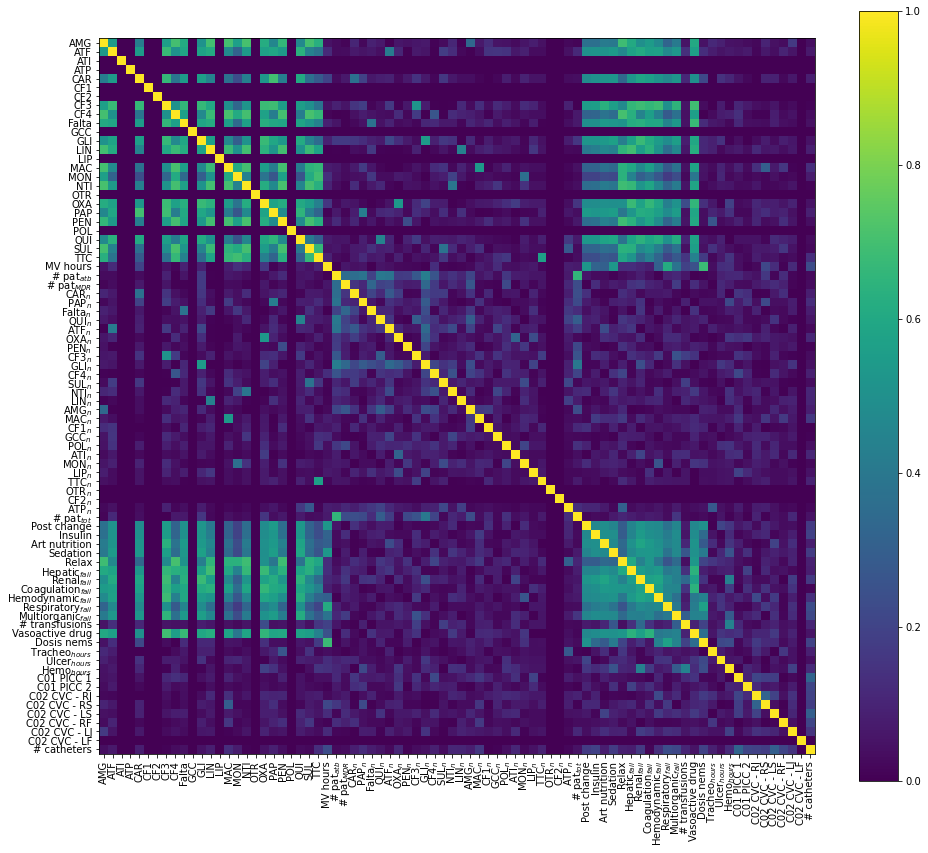

==============> Time step 9


<Figure size 432x288 with 0 Axes>

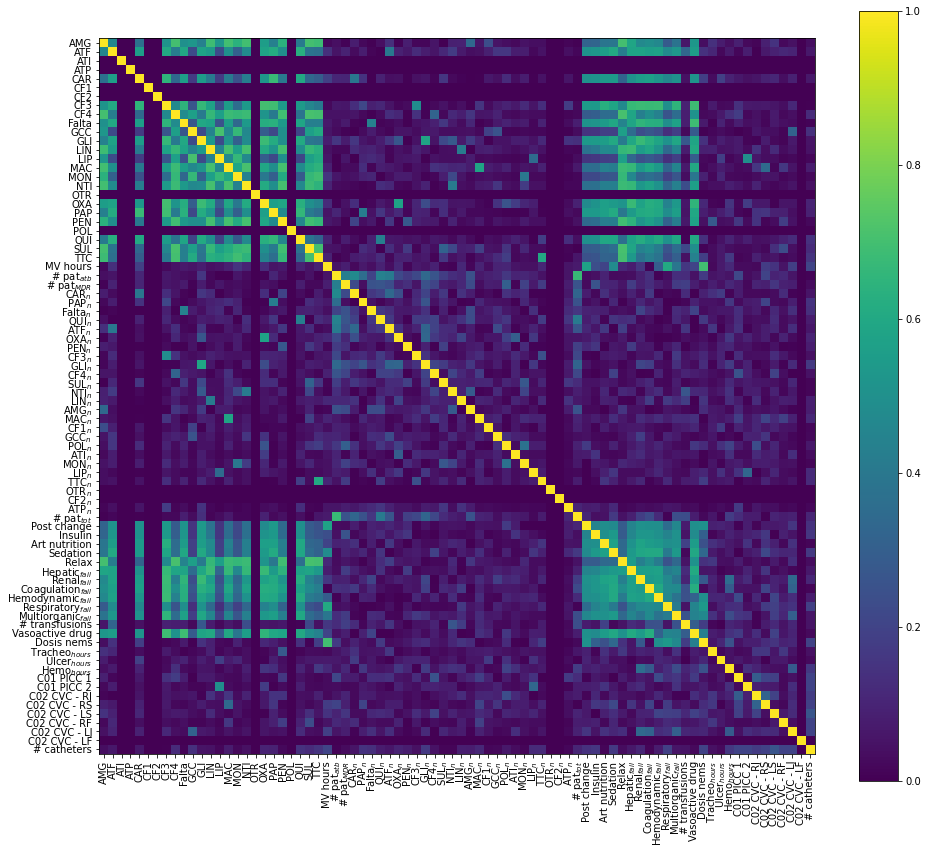

==============> Time step 10


<Figure size 432x288 with 0 Axes>

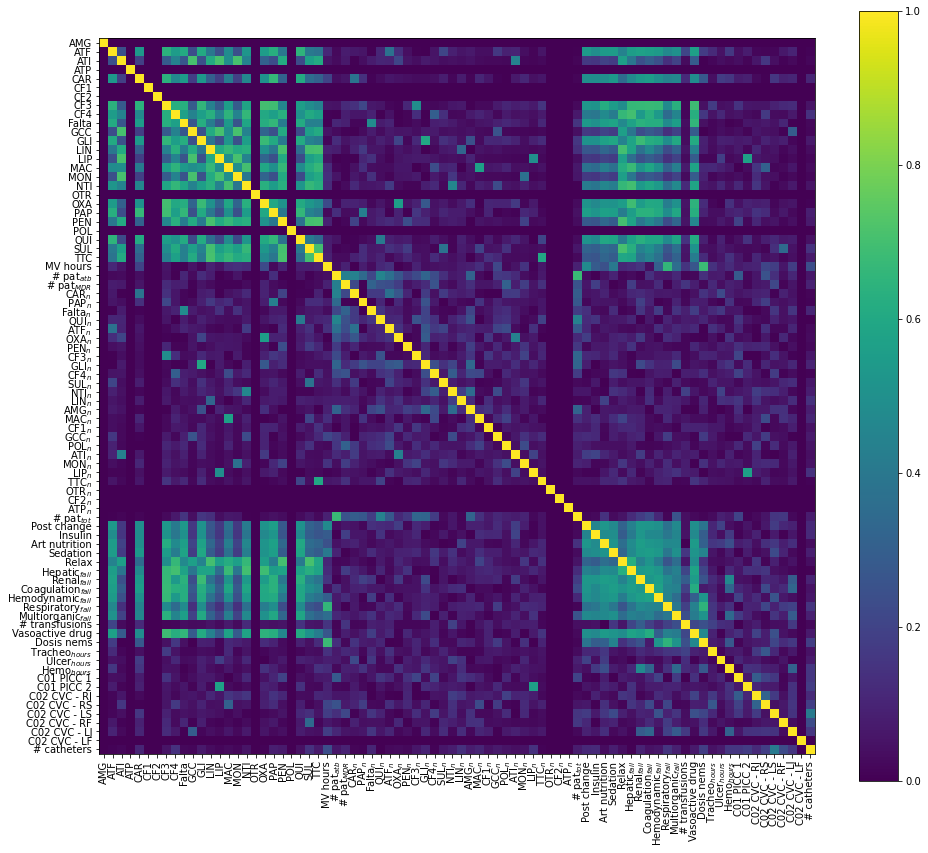

==============> Time step 11


<Figure size 432x288 with 0 Axes>

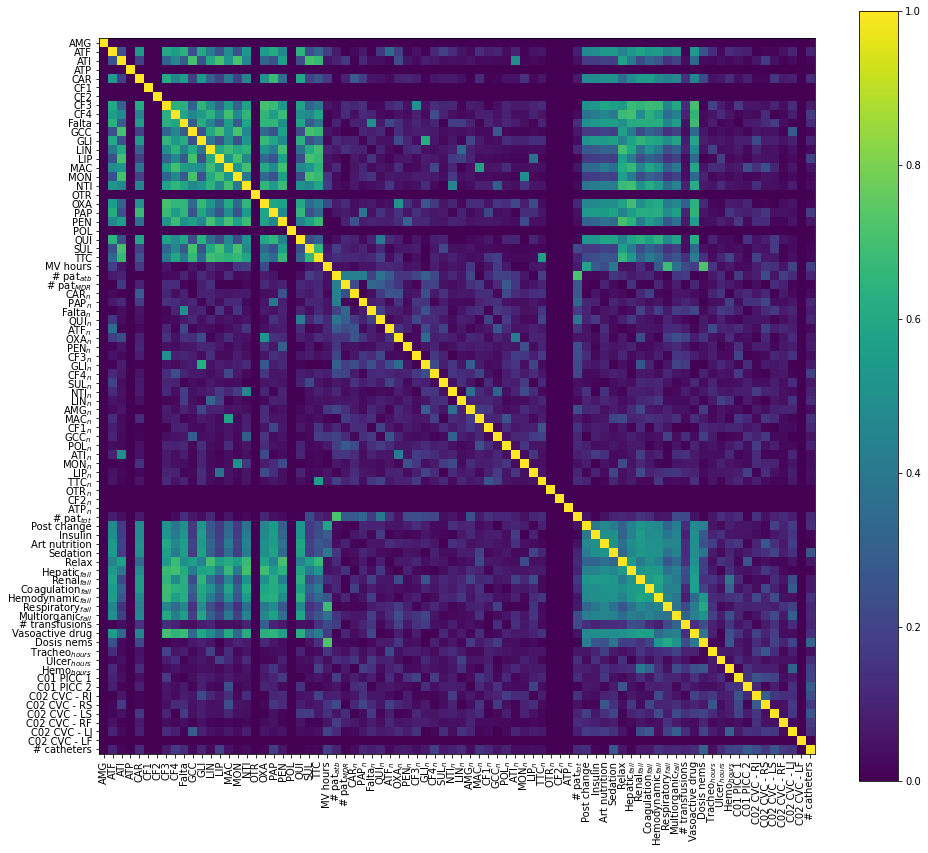

==============> Time step 12


<Figure size 432x288 with 0 Axes>

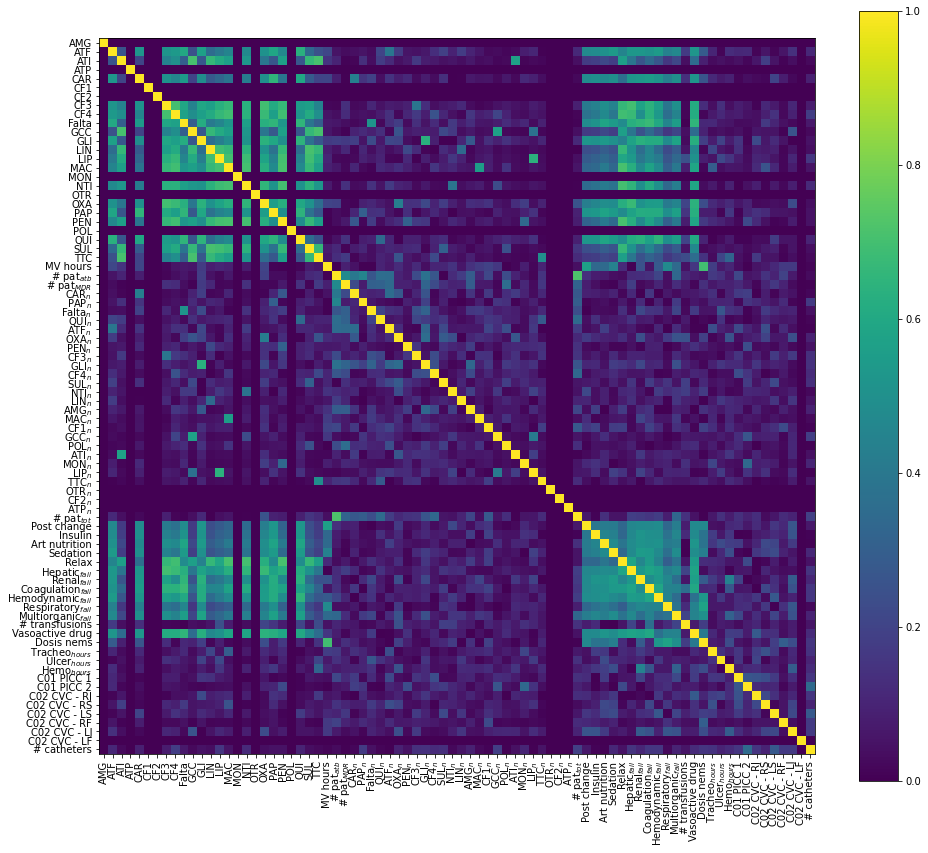

==============> Time step 13


<Figure size 432x288 with 0 Axes>

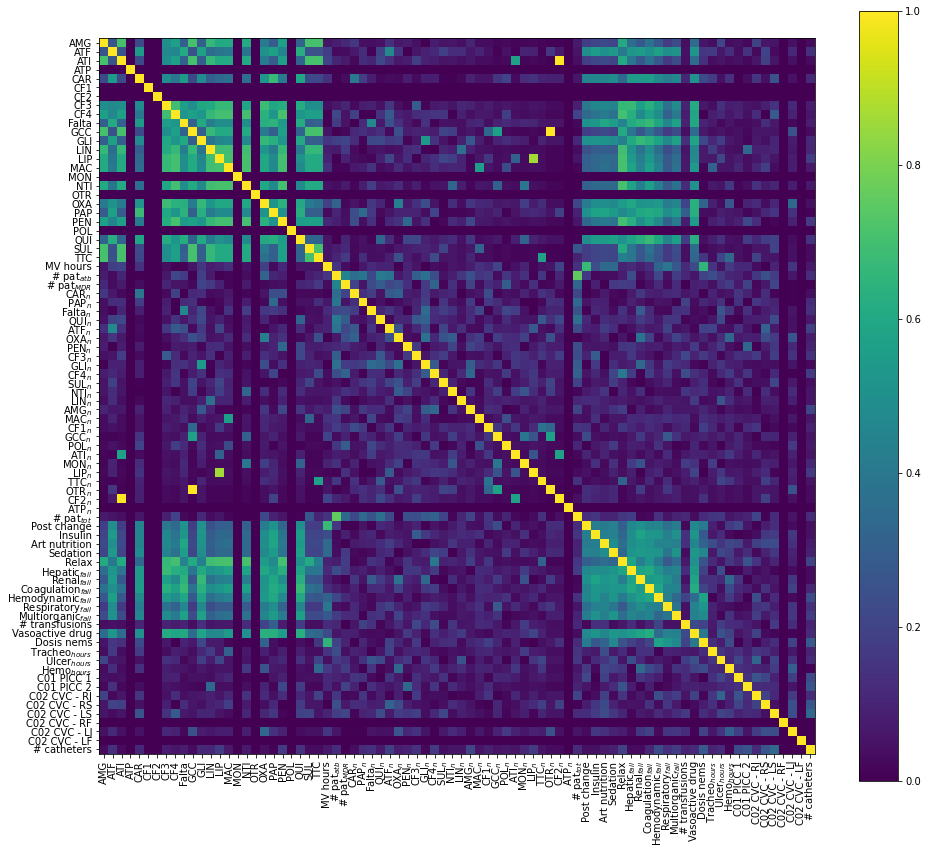

========> Folder s3
==============> Time step 0


<Figure size 432x288 with 0 Axes>

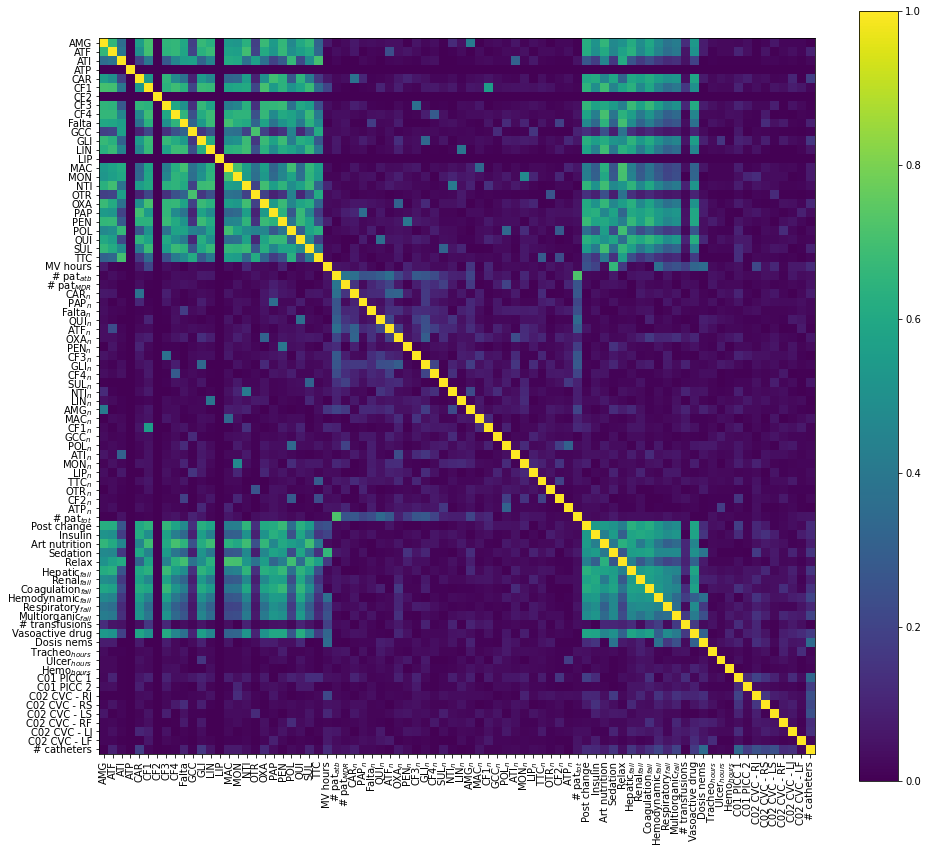

==============> Time step 1


<Figure size 432x288 with 0 Axes>

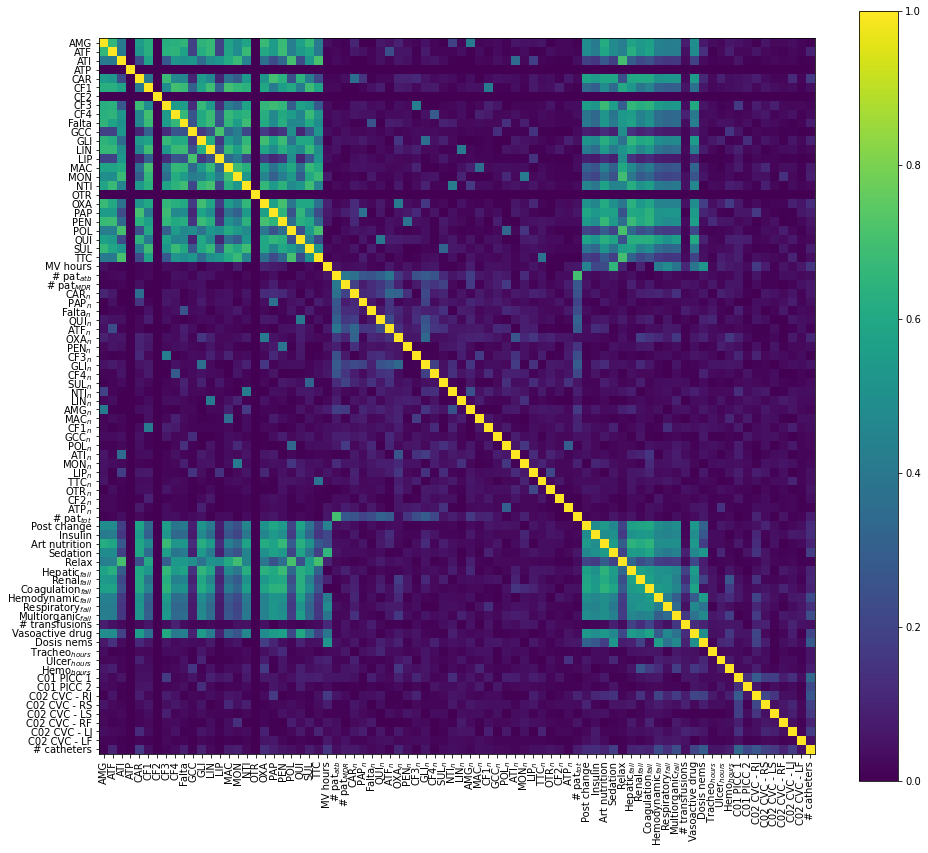

==============> Time step 2


<Figure size 432x288 with 0 Axes>

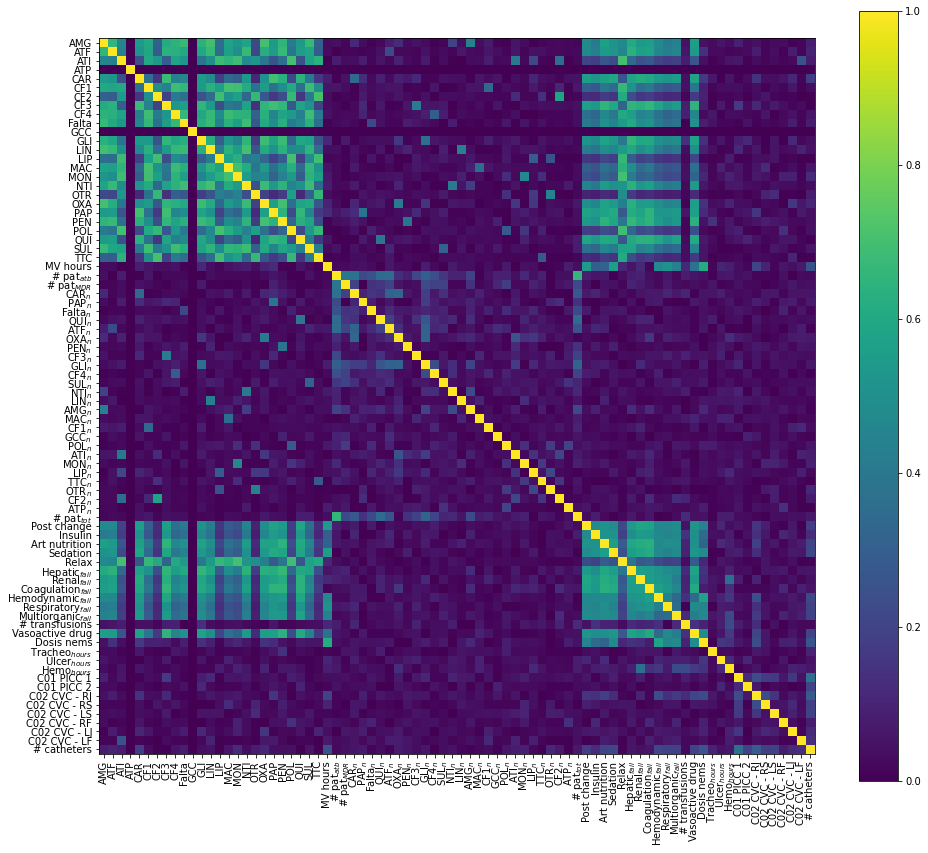

==============> Time step 3


<Figure size 432x288 with 0 Axes>

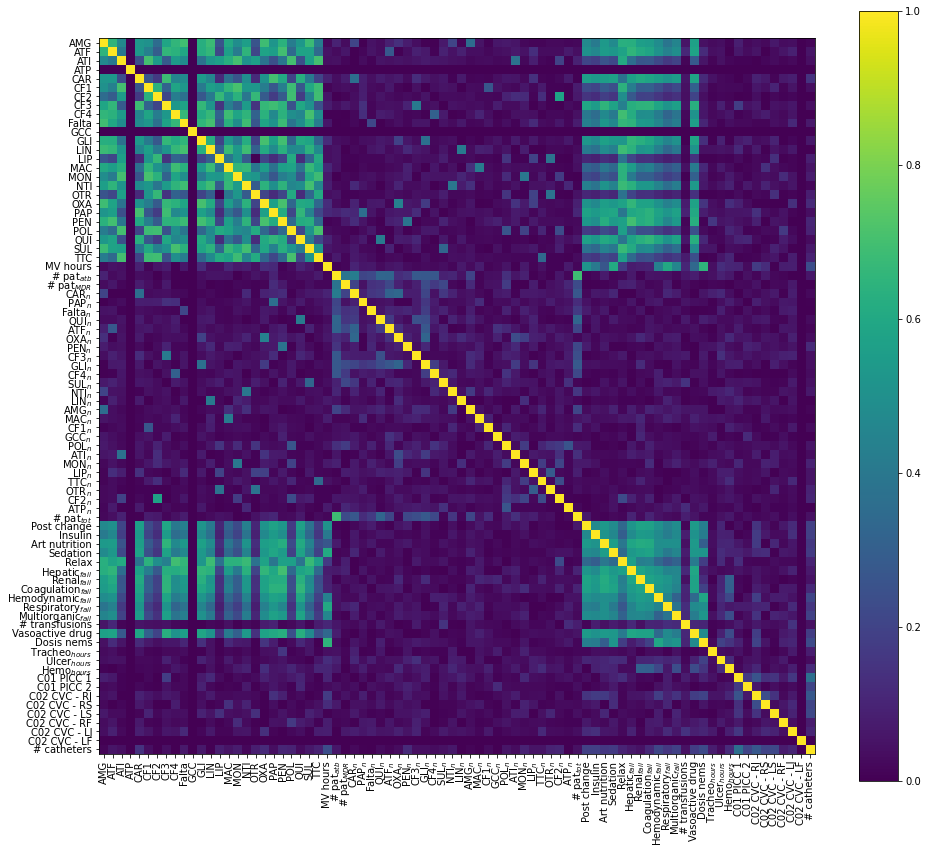

==============> Time step 4


<Figure size 432x288 with 0 Axes>

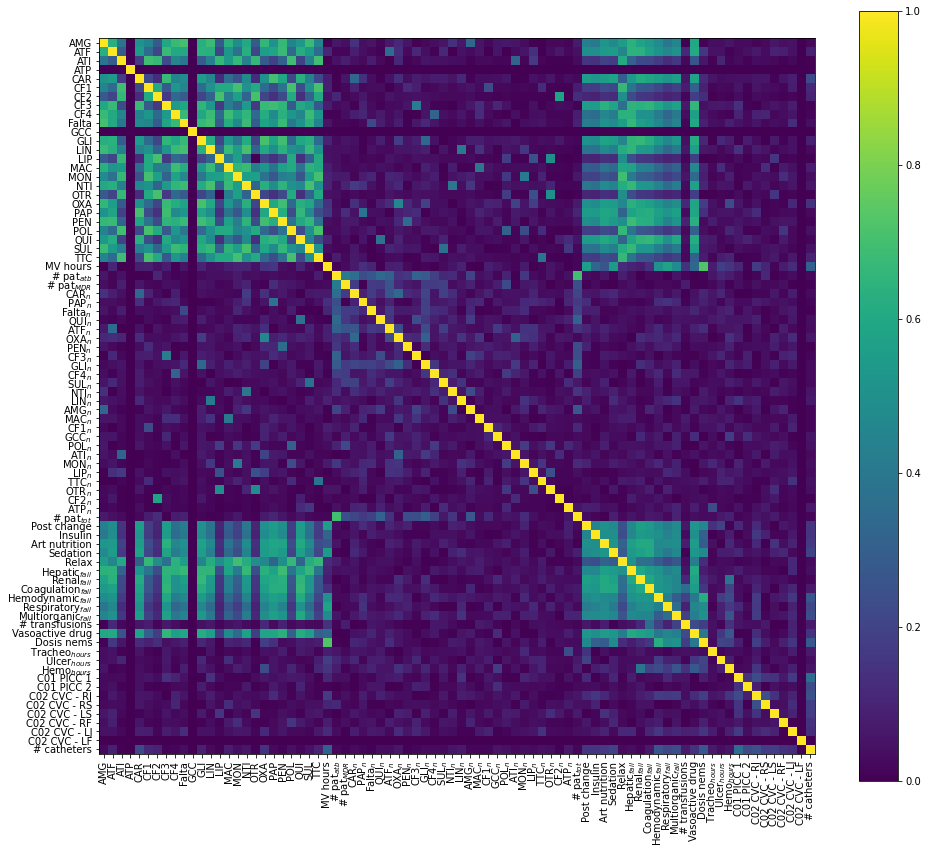

==============> Time step 5


<Figure size 432x288 with 0 Axes>

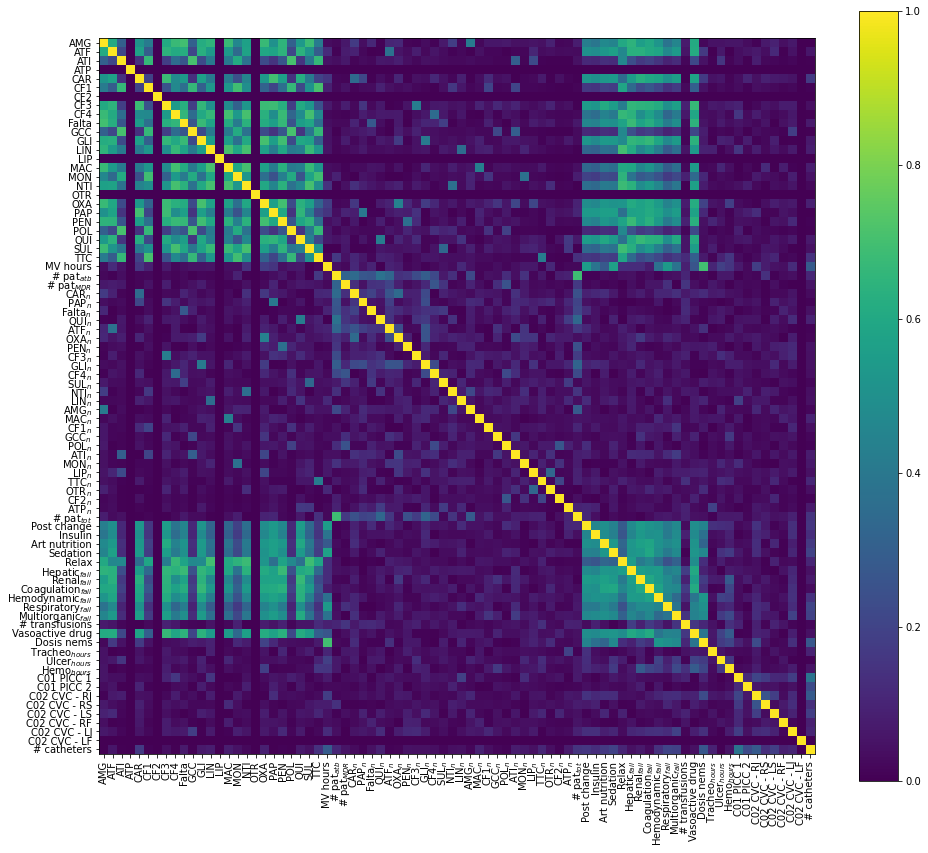

==============> Time step 6


<Figure size 432x288 with 0 Axes>

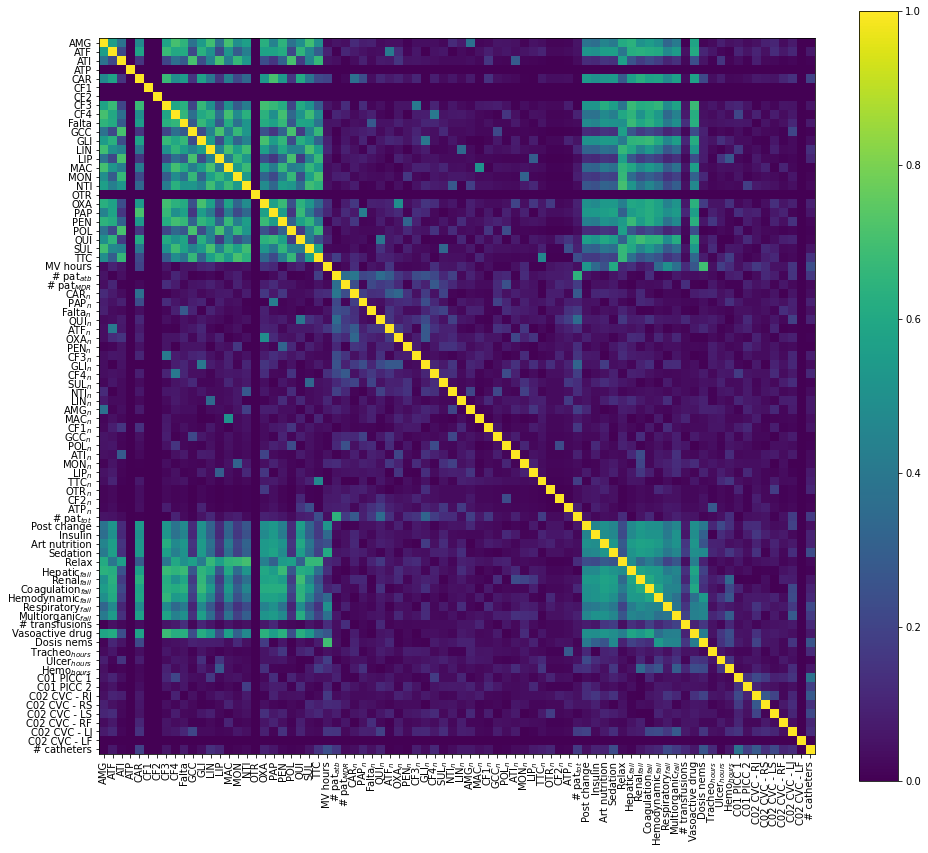

==============> Time step 7


<Figure size 432x288 with 0 Axes>

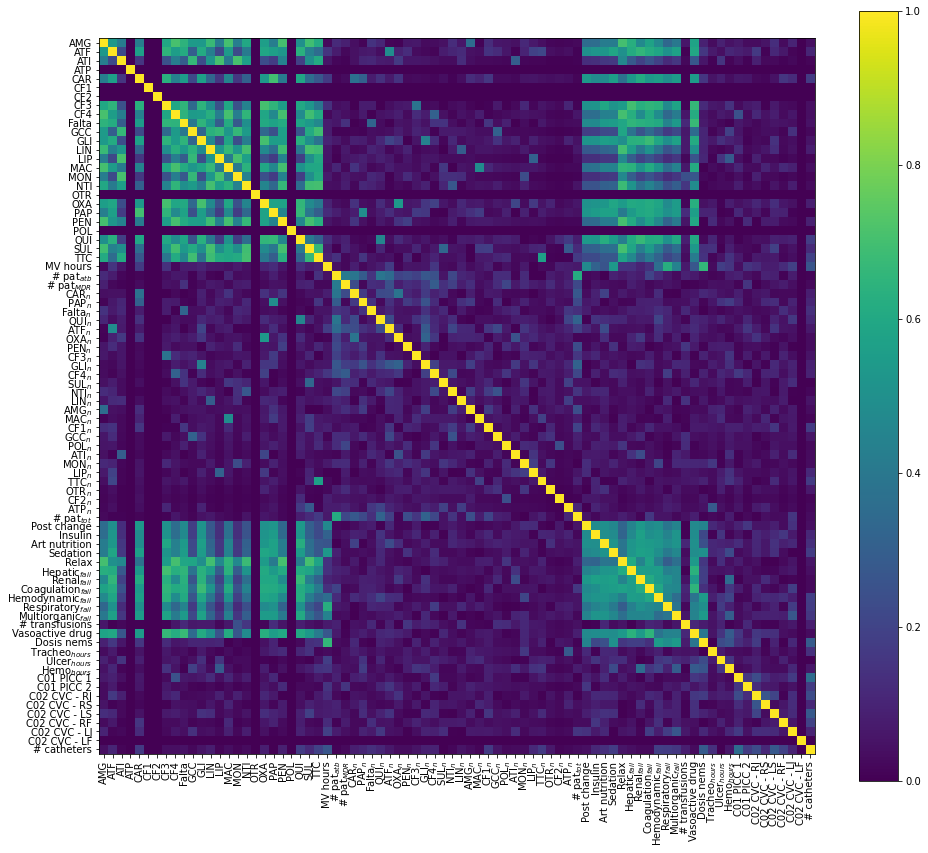

==============> Time step 8


<Figure size 432x288 with 0 Axes>

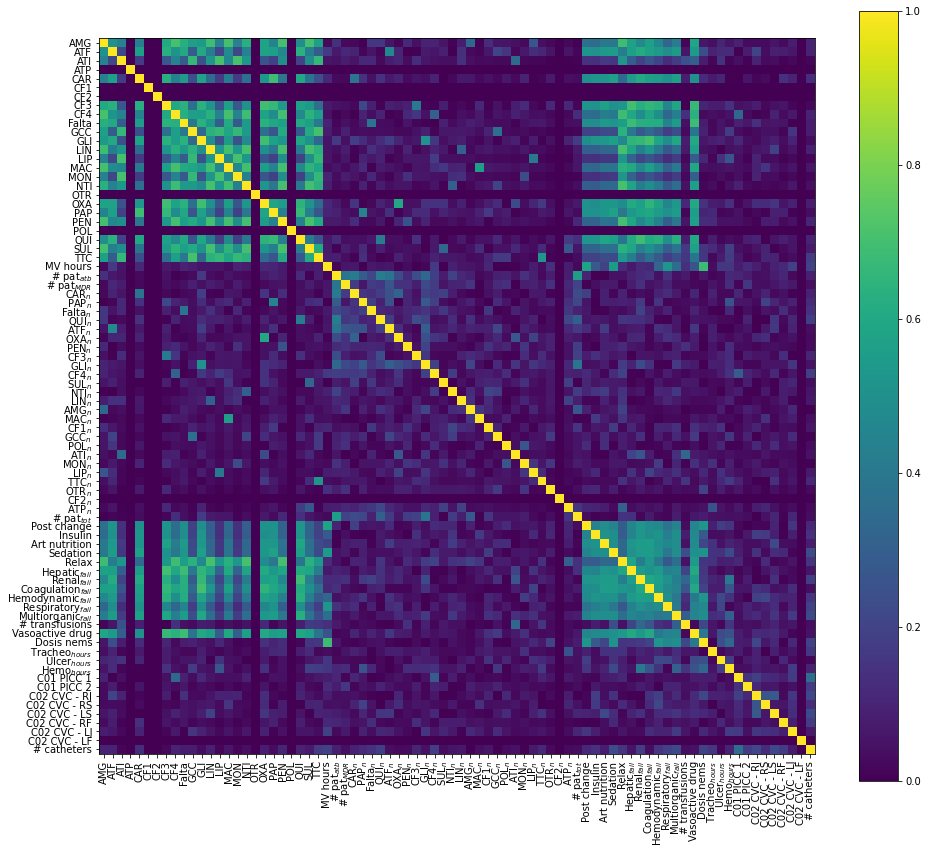

==============> Time step 9


<Figure size 432x288 with 0 Axes>

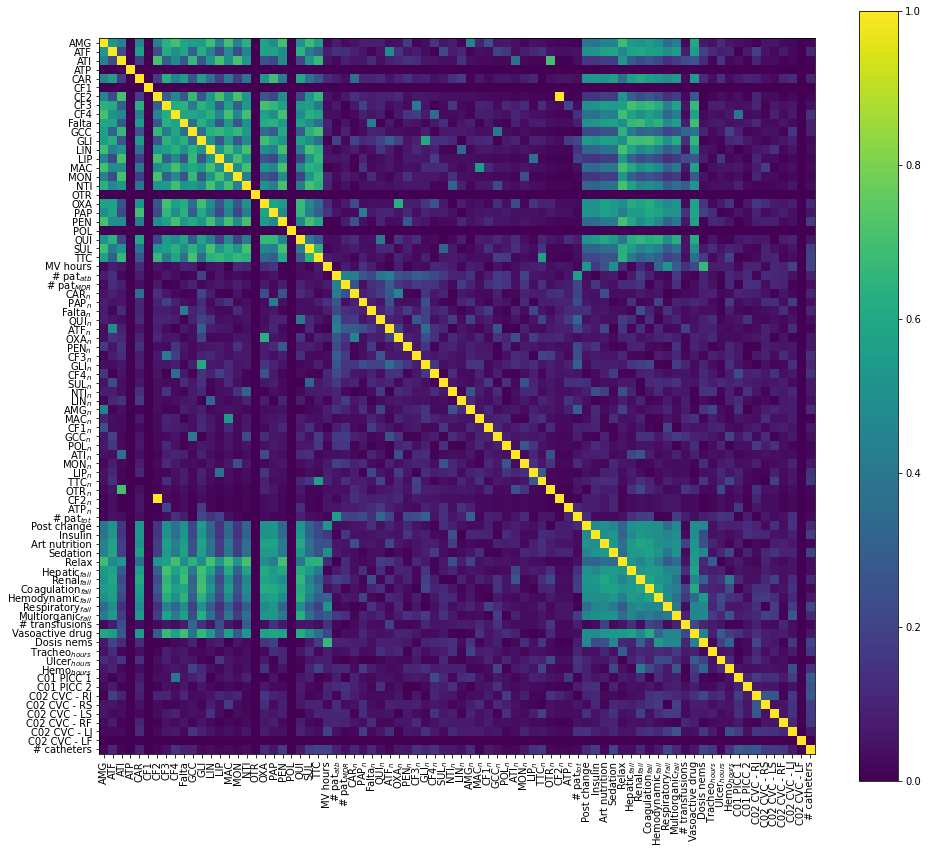

==============> Time step 10


<Figure size 432x288 with 0 Axes>

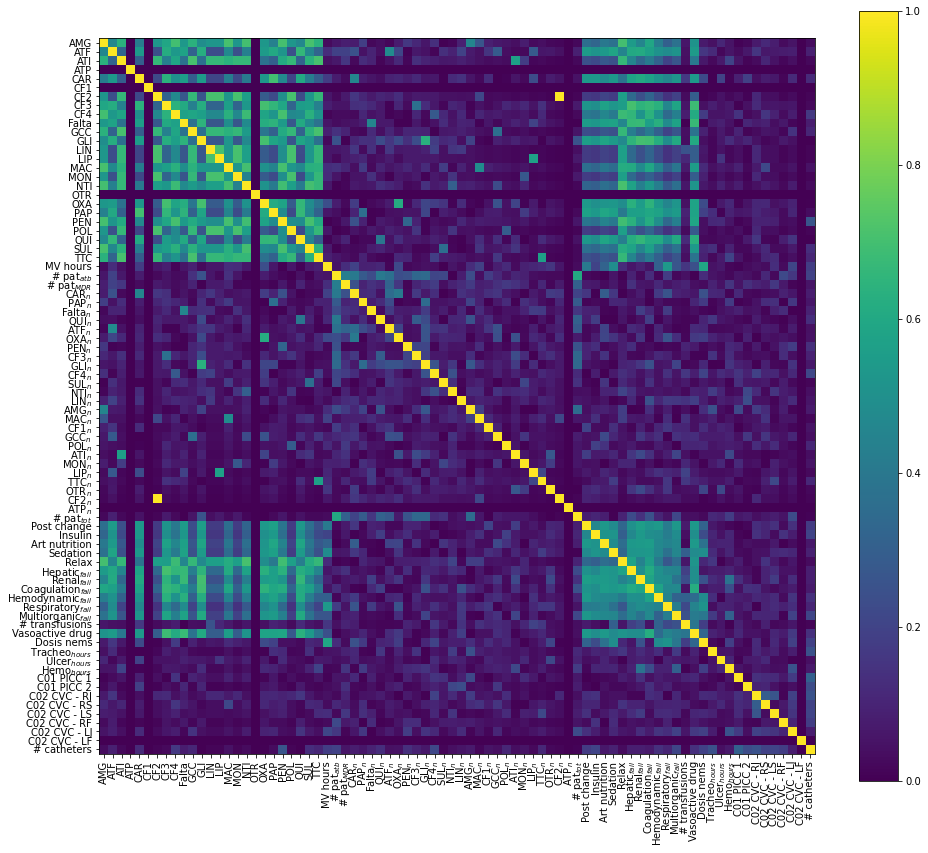

==============> Time step 11


<Figure size 432x288 with 0 Axes>

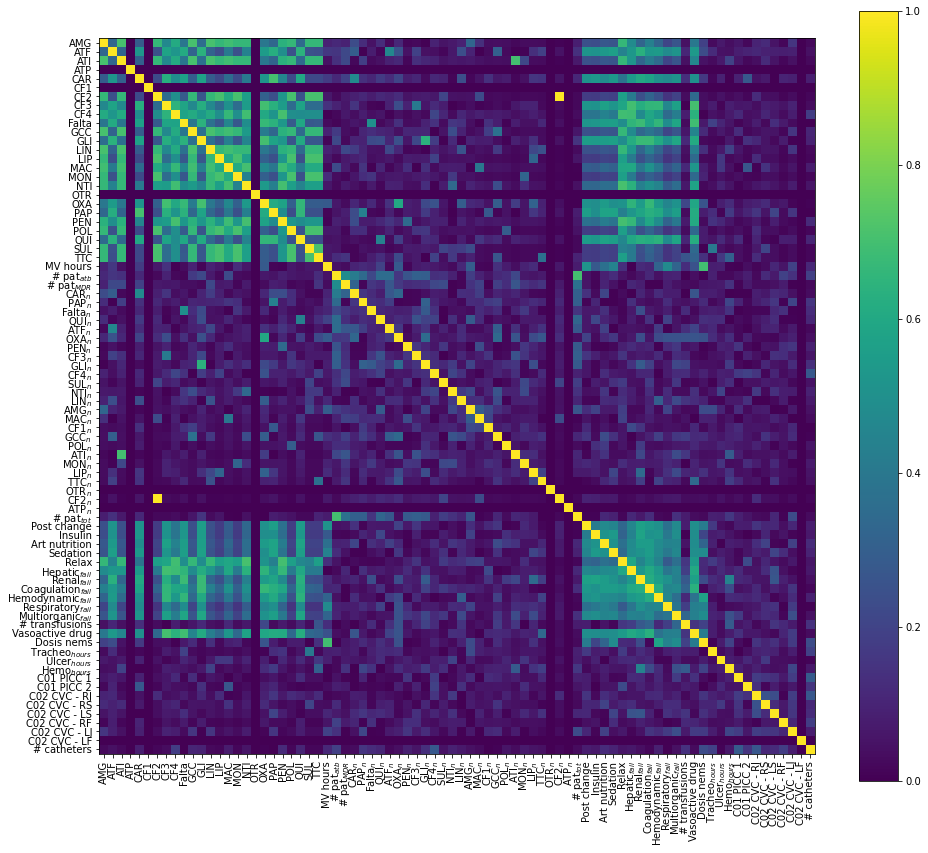

==============> Time step 12


<Figure size 432x288 with 0 Axes>

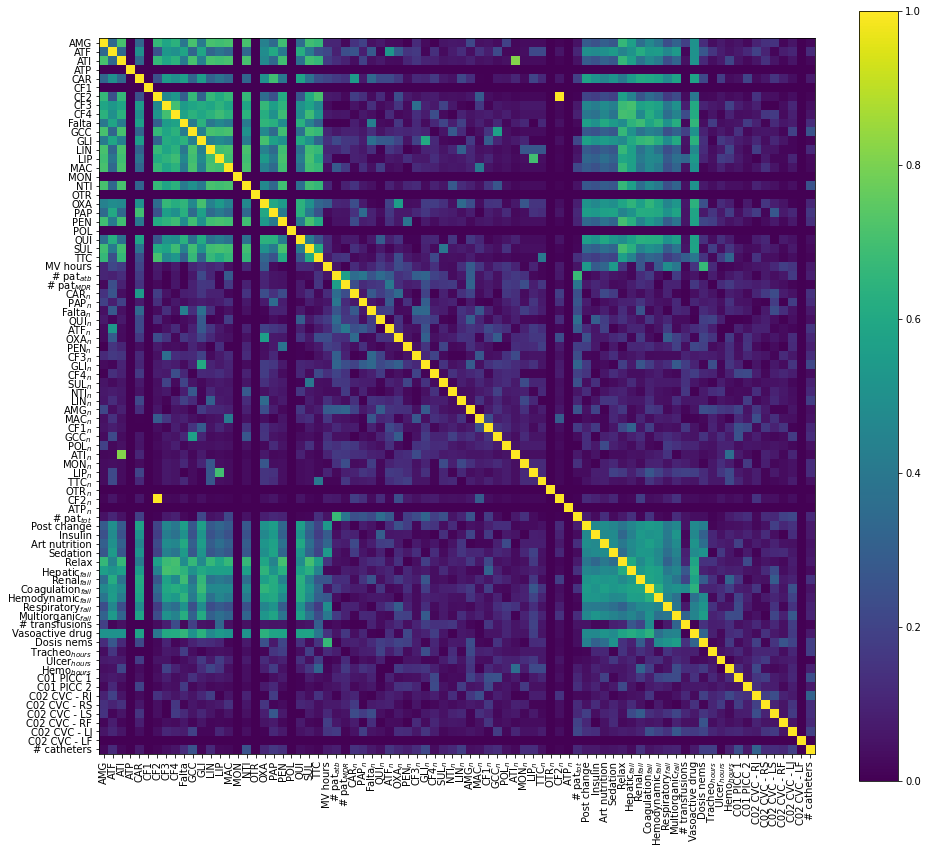

==============> Time step 13


<Figure size 432x288 with 0 Axes>

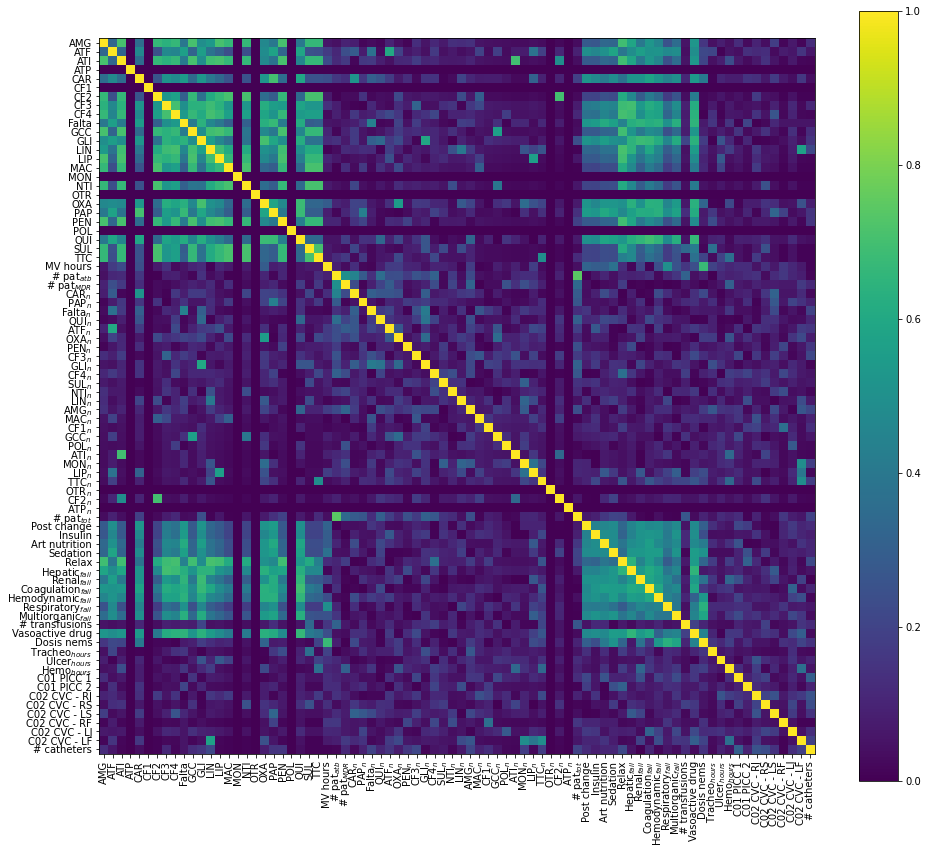

In [4]:
for c in range(len(folders)):
    print("========> Folder " + str(folders[c]))
    
    X_train = np.load("../../DATA/" + folders[c] + "/X_train_tensor_"+norm+".npy")

    ones = np.ones([X_train.shape[2], X_train.shape[2]])
    shiftOperator_by_timeStep = {}
    for nt in range(numberOfTimeStep):
        print("==============> Time step " + str(nt))
        shiftOperator = pd.DataFrame(np.zeros([X_train.shape[2], X_train.shape[2]]), columns=keys)
        data_by_time_step = X_train[:,nt,:]

        for i in range(data_by_time_step.shape[1]):
            for j in range(data_by_time_step.shape[1]):
                # Numeric variables - Pearson
                if (keys[i] not in binary) & (keys[j] not in binary):
                    f1 = data_by_time_step[:, i][data_by_time_step[:, i] != 666]
                    f2 = data_by_time_step[:, j][data_by_time_step[:, j] != 666]
                    pearsonCoef, _ = sp.stats.pearsonr(f1, f2)
                    shiftOperator.iloc[i, j] = pearsonCoef
                # Discrete variables - Phi
                elif (keys[i] in binary) & (keys[j] in binary):   
                    f1 = data_by_time_step[:, i][data_by_time_step[:, i] != 666]
                    f2 = data_by_time_step[:, j][data_by_time_step[:, j] != 666]
                    observed = np.array([f1, f2])
                    phiCoef = phi_coefficient(observed)
                    shiftOperator.iloc[i, j] = phiCoef
                # Binary-continuous or continuous-binary variables - PointBiserial
                elif ((keys[i] in binary) & (keys[j] not in binary)) or ((keys[i] not in binary) & (keys[j] in binary)):  
                    # Binary-numeric links
                    f1 = data_by_time_step[:, i][data_by_time_step[:, i] != 666]
                    f2 = data_by_time_step[:, j][data_by_time_step[:, j] != 666]
                    pointBiseCoef, _ = pointbiserialr(f1, f2)
                    shiftOperator.iloc[i, j] = pointBiseCoef

        shiftOperator = np.abs(np.nan_to_num(shiftOperator, nan=0))
        np.fill_diagonal(shiftOperator, 1)

        %matplotlib inline
        _ = plt.figure()
        fig, ax = plt.subplots(1,1, figsize=(14,14))

        img = ax.imshow(shiftOperator)

        ax.set_xticks(range(len(keys)))  
        ax.set_xticklabels(keys, fontsize=10, rotation=90)  
        ax.set_yticks(range(len(keys)))  
        ax.set_yticklabels(keys, fontsize=10)  

        cbar = fig.colorbar(img, shrink=0.8) 

        plt.tight_layout() 
        plt.show()
        
        pd.DataFrame(shiftOperator, columns=keys, index=keys).to_csv("./estimatedGraphs/correlations/"+folders[c]+"/X_train_TS_"+str(nt)+"_"+norm+".csv", index=False)


#### B) Same graph for all time steps

========> Folder s1


<Figure size 432x288 with 0 Axes>

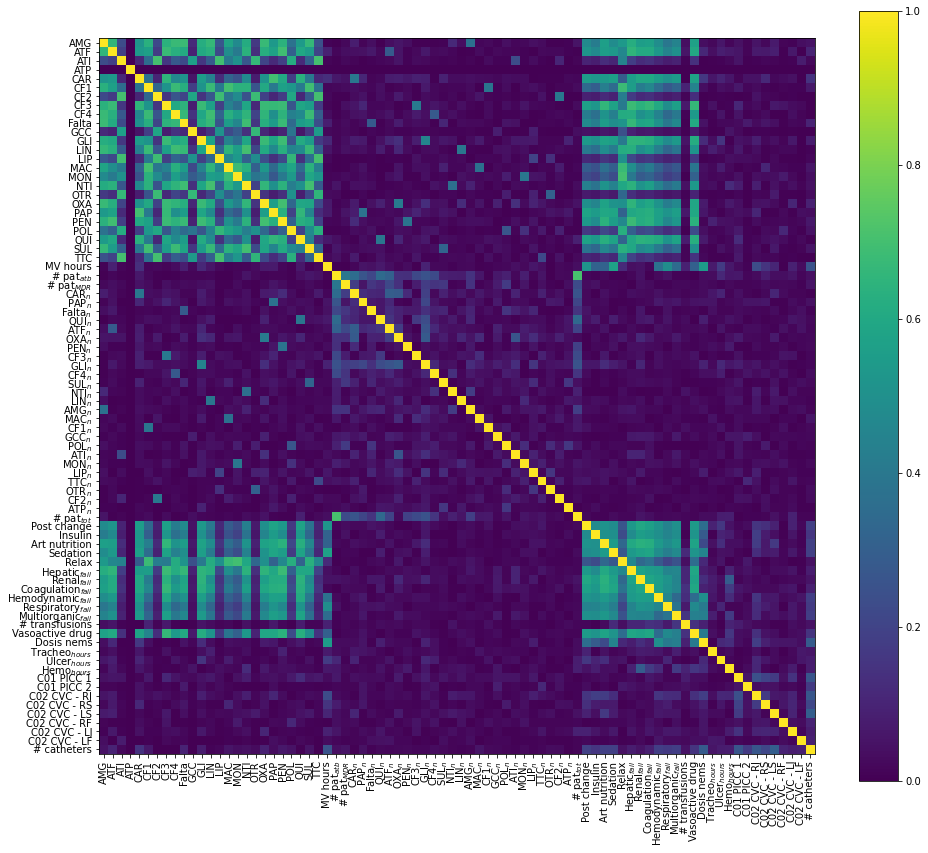

========> Folder s2


<Figure size 432x288 with 0 Axes>

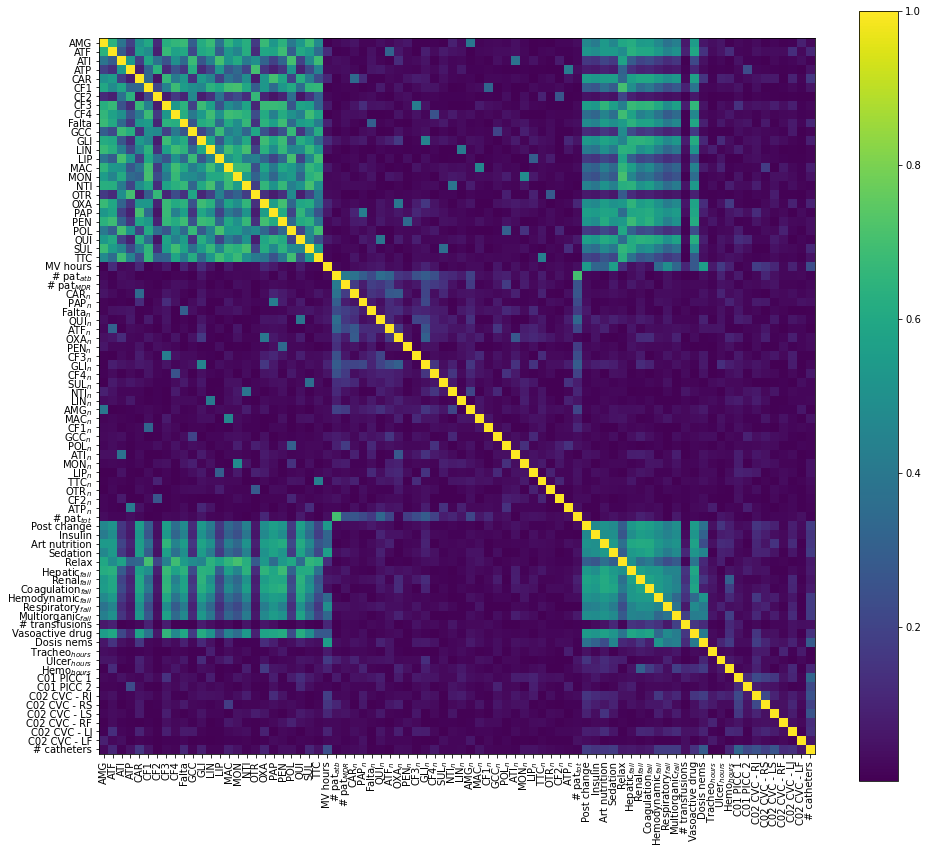

========> Folder s3


<Figure size 432x288 with 0 Axes>

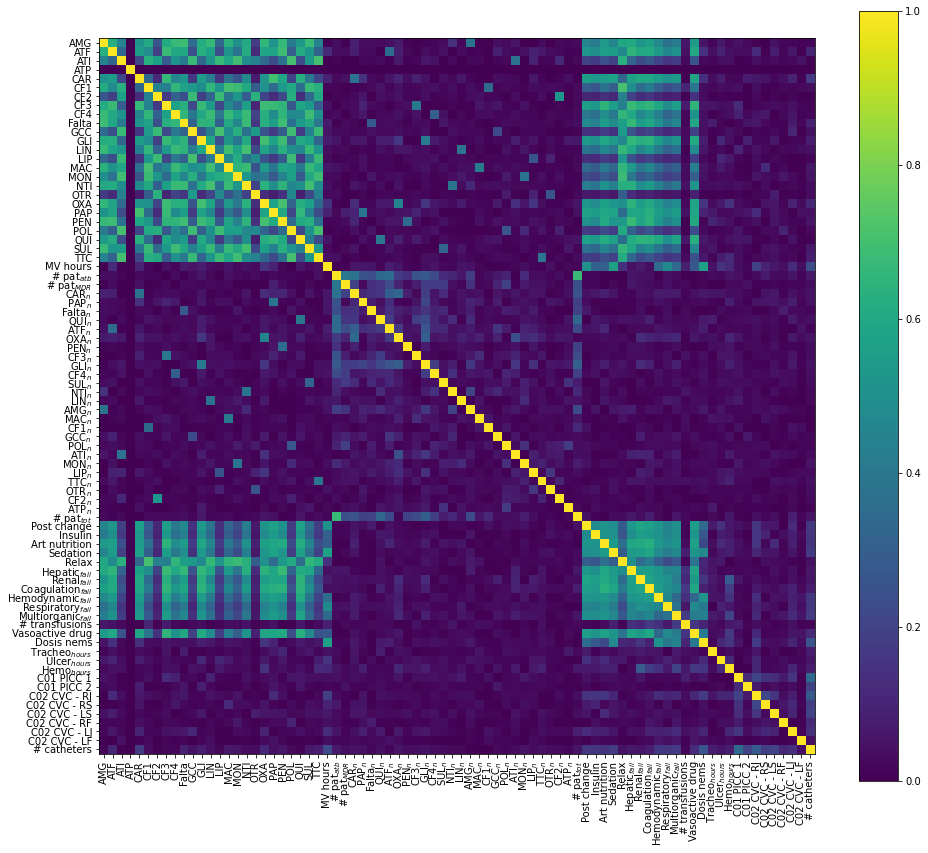

In [5]:
for c in range(len(folders)):
    
    print("========> Folder " + str(folders[c]))
    
    data = np.load("../../DATA/" + folders[c] + "/X_train_tensor_" + norm + ".npy")

    ones = np.ones([data.shape[2], data.shape[2]])
    shiftOperator = pd.DataFrame(np.zeros([data.shape[2], data.shape[2]]), columns=keys)
    for i in range(data.shape[2]):
        for j in range(data.shape[2]):
            # Numeric variables - Pearson
            if (keys[i] not in binary) & (keys[j] not in binary):
                f1 = data[:,:, i][data[:,:, i] != 666].flatten()
                f2 = data[:,:, j][data[:,:, j] != 666].flatten()
                pearsonCoef, _ = sp.stats.pearsonr(f1, f2)
                shiftOperator.iloc[i, j] = pearsonCoef
            # Discrete variables - Phi
            elif (keys[i] in binary) & (keys[j] in binary):   
                f1 = data[:,:, i][data[:,:, i] != 666].flatten()
                f2 = data[:,:, j][data[:,:, j] != 666].flatten()
                observed = np.array([f1, f2])
                phiCoef = phi_coefficient(observed)
                shiftOperator.iloc[i, j] = phiCoef
            # Binary-continuous or continuous-binary variables - PointBiserial
            elif ((keys[i] in binary) & (keys[j] not in binary)) or ((keys[i] not in binary) & (keys[j] in binary)):  
                # Binary-numeric links
                f1 = data[:,:, i][data[:,:, i] != 666].flatten()
                f2 = data[:,:, j][data[:,:, j] != 666].flatten()
                pointBiseCoef, _ = pointbiserialr(f1, f2)
                shiftOperator.iloc[i, j] = pointBiseCoef

    shiftOperator = np.abs(np.nan_to_num(shiftOperator, nan=0))
    np.fill_diagonal(shiftOperator, 1)

    %matplotlib inline
    _ = plt.figure()
    fig, ax = plt.subplots(1,1, figsize=(14,14))

    img = ax.imshow(shiftOperator)

    ax.set_xticks(range(len(keys)))  
    ax.set_xticklabels(keys, fontsize=10, rotation=90)  
    ax.set_yticks(range(len(keys)))  
    ax.set_yticklabels(keys, fontsize=10)  

    cbar = fig.colorbar(img, shrink=0.8) 

    plt.tight_layout() 
    plt.show()
    
    pd.DataFrame(shiftOperator, columns=keys, index=keys).to_csv("./estimatedGraphs/correlations/" + folders[c] + "/X_train_allMTS_" + norm + ".csv", index=False)


## We impose smoothness

#### A) Graph by time step

In [6]:
threshold_val = 0.975
max_E_arr = [
 [298, 116, 136, 104, 216, 304, 220, 272, 356, 334, 440, 482, 524, 398],
 [165, 94, 114, 72, 130, 110, 150, 384, 388, 360, 482, 514, 502, 432],
 [283, 98, 110, 176, 200, 204, 254, 204, 302, 164, 242, 350, 343, 301]
]

# threshold_val = 0.85
# max_E_arr = [
#  [505, 272, 308, 292, 356, 450, 384, 410, 514, 532, 624, 696, 657, 672],
#  [403, 287, 336, 268, 286, 298, 270, 524, 489, 506, 678, 612, 653, 513],
#  [497, 289, 312, 368, 366, 328, 414, 362, 424, 304, 456, 518, 558, 431]
# ]

# threshold_val = 0.725
# max_E_arr = [
#  [666, 386, 450, 410, 460, 596, 554, 570, 672, 658, 744, 798, 793, 823],
#  [578, 384, 412, 368, 370, 392, 432, 654, 598, 602, 724, 773, 781, 653],
#  [648, 414, 423, 462, 458, 506, 531, 512, 569, 438, 528, 684, 656, 562]
# ]

# threshold_val = 0.6
# max_E_arr = [
#  [833, 576, 600, 534, 645, 705, 676, 676, 799, 770, 878, 921, 913, 949],
#  [751, 566, 545, 504, 520, 505, 610, 774, 786, 782, 826, 822, 867, 814],
#  [825, 533, 535, 594, 602, 608, 690, 638, 704, 613, 713, 755, 745, 685]
# ]

# of edges: 3160 - # of features: 80 - # of max edges: 298


<Figure size 432x288 with 0 Axes>

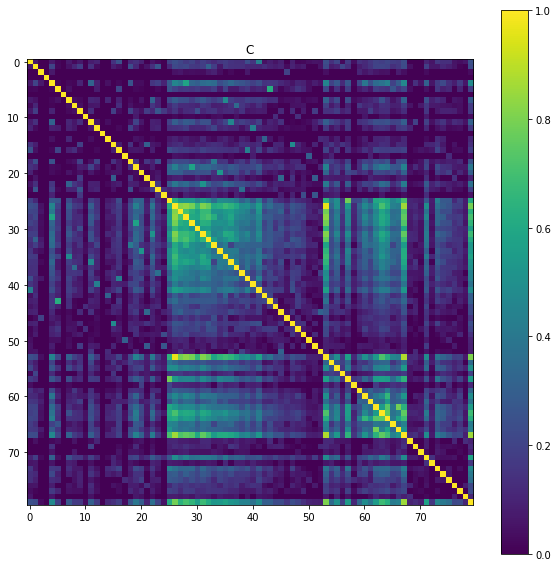

Shape A: (80, 80)
Shape A (1's except diagonal to 0): (80, 80)
1. Create a graph based on previous matrix (1's matrix)
(80, 80)
2. Get the incidence matrix of the previous graph
	shape B01: (3160, 80)
3. Compute C0 as incidence matrix T by covariance matrix by incidence matrix.
C0 shape: (3160, 3160)
4. Obtain the diagonal from the previous calculation
5. Sort the diagonal from smallest to largest, and select the smallest max_E's
6. Obtain a vector of 0's and 1's
7. Get B1_hat as B01 * diag(vec)
8. Obtain A as D - L


<Figure size 432x288 with 0 Axes>

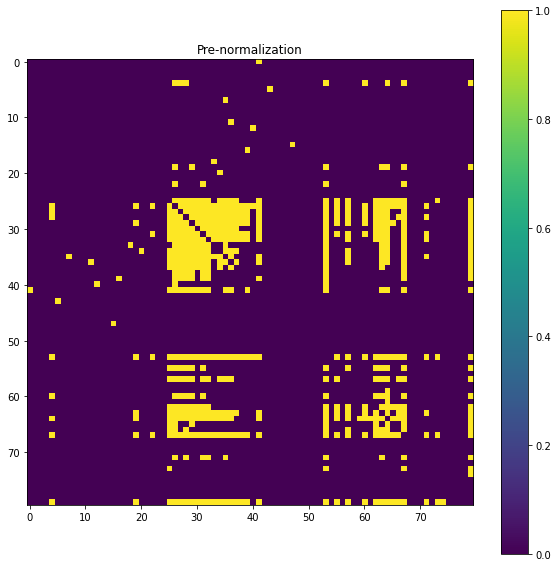

<Figure size 432x288 with 0 Axes>

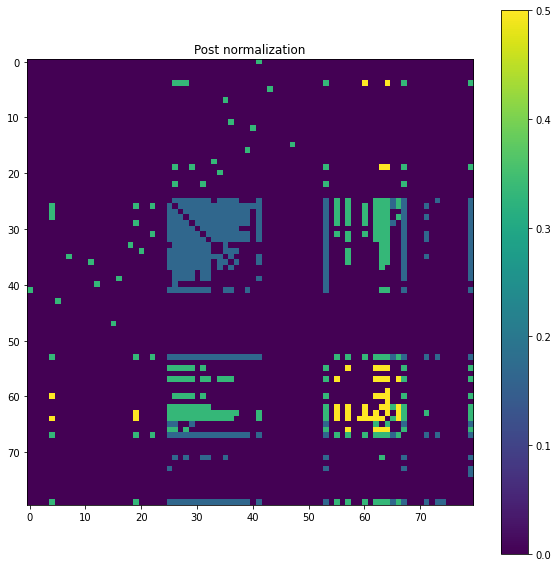

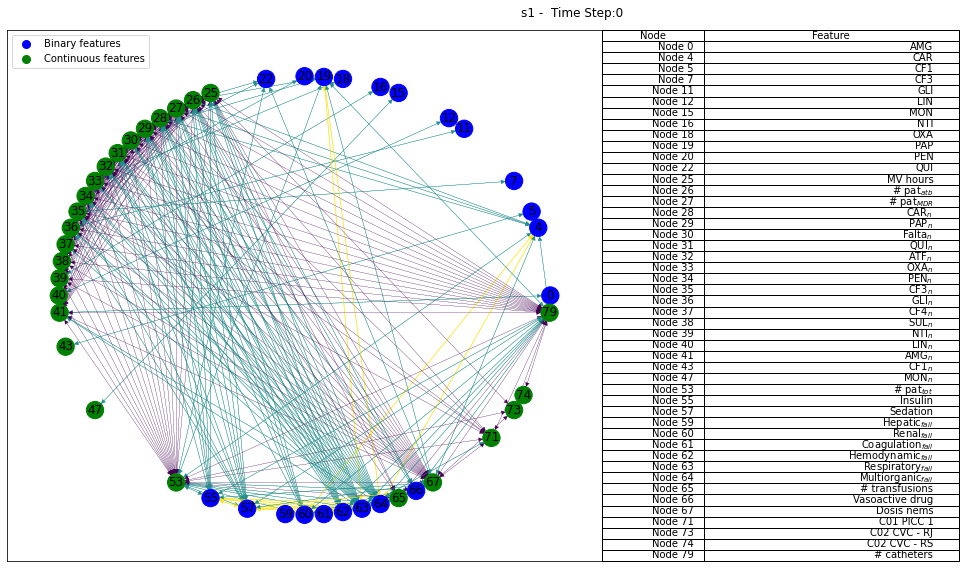

# of edges: 3160 - # of features: 80 - # of max edges: 116


<Figure size 432x288 with 0 Axes>

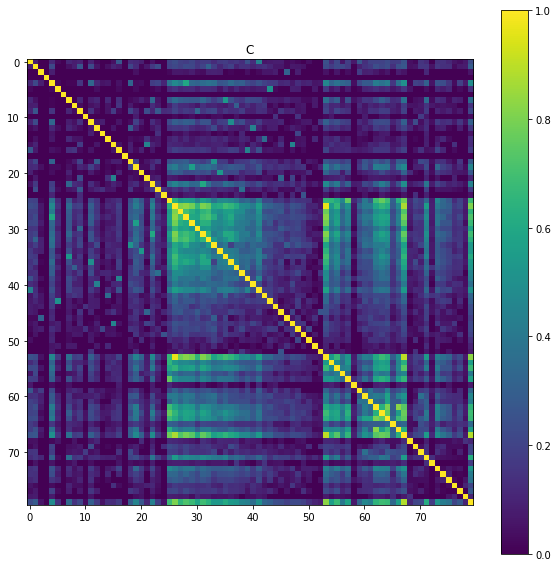

Shape A: (80, 80)
Shape A (1's except diagonal to 0): (80, 80)
1. Create a graph based on previous matrix (1's matrix)
(80, 80)
2. Get the incidence matrix of the previous graph
	shape B01: (3160, 80)
3. Compute C0 as incidence matrix T by covariance matrix by incidence matrix.
C0 shape: (3160, 3160)
4. Obtain the diagonal from the previous calculation
5. Sort the diagonal from smallest to largest, and select the smallest max_E's
6. Obtain a vector of 0's and 1's
7. Get B1_hat as B01 * diag(vec)
8. Obtain A as D - L


<Figure size 432x288 with 0 Axes>

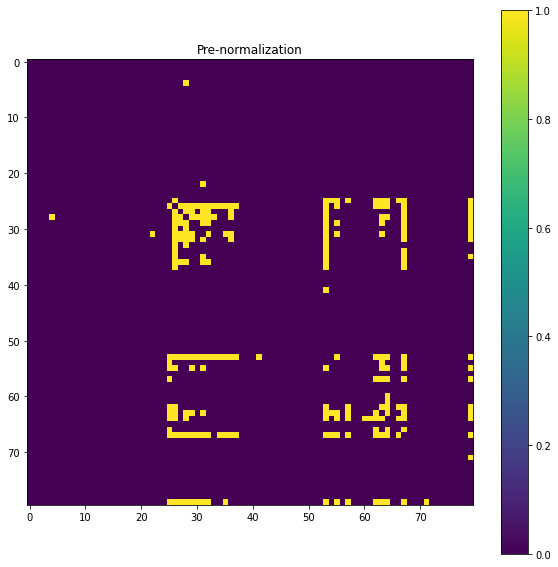

<Figure size 432x288 with 0 Axes>

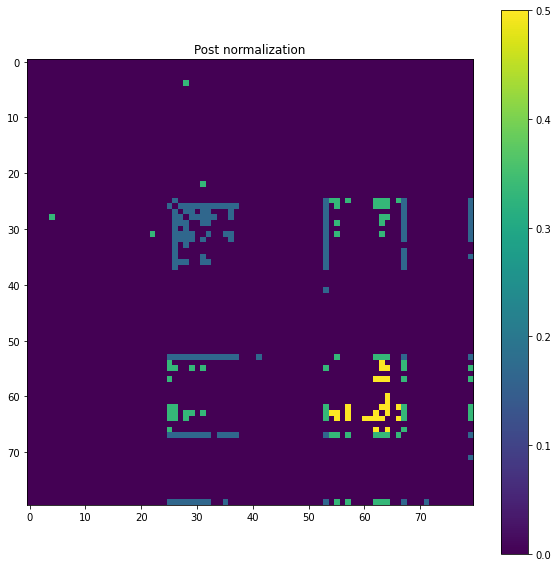

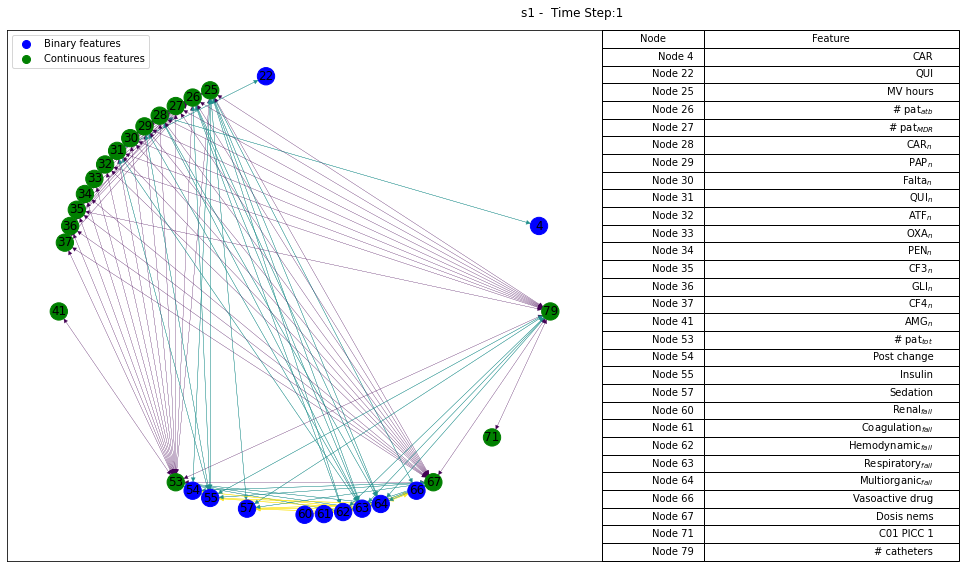

# of edges: 3160 - # of features: 80 - # of max edges: 136


<Figure size 432x288 with 0 Axes>

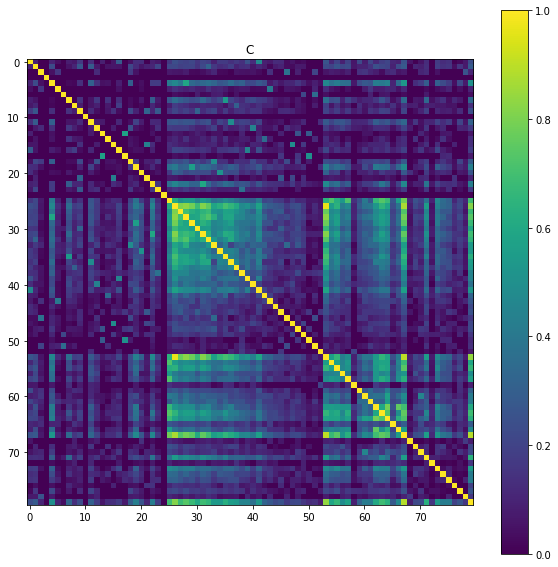

Shape A: (80, 80)
Shape A (1's except diagonal to 0): (80, 80)
1. Create a graph based on previous matrix (1's matrix)
(80, 80)
2. Get the incidence matrix of the previous graph
	shape B01: (3160, 80)
3. Compute C0 as incidence matrix T by covariance matrix by incidence matrix.
C0 shape: (3160, 3160)
4. Obtain the diagonal from the previous calculation
5. Sort the diagonal from smallest to largest, and select the smallest max_E's
6. Obtain a vector of 0's and 1's
7. Get B1_hat as B01 * diag(vec)
8. Obtain A as D - L


<Figure size 432x288 with 0 Axes>

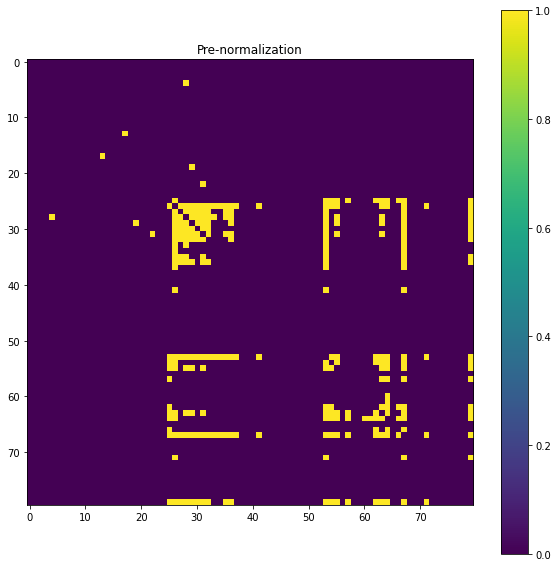

<Figure size 432x288 with 0 Axes>

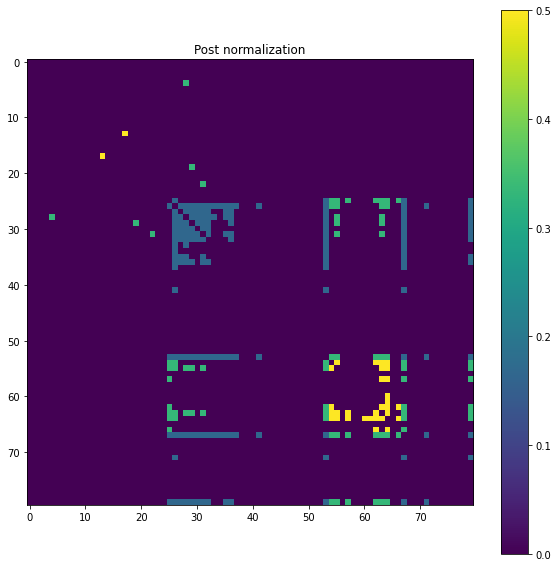

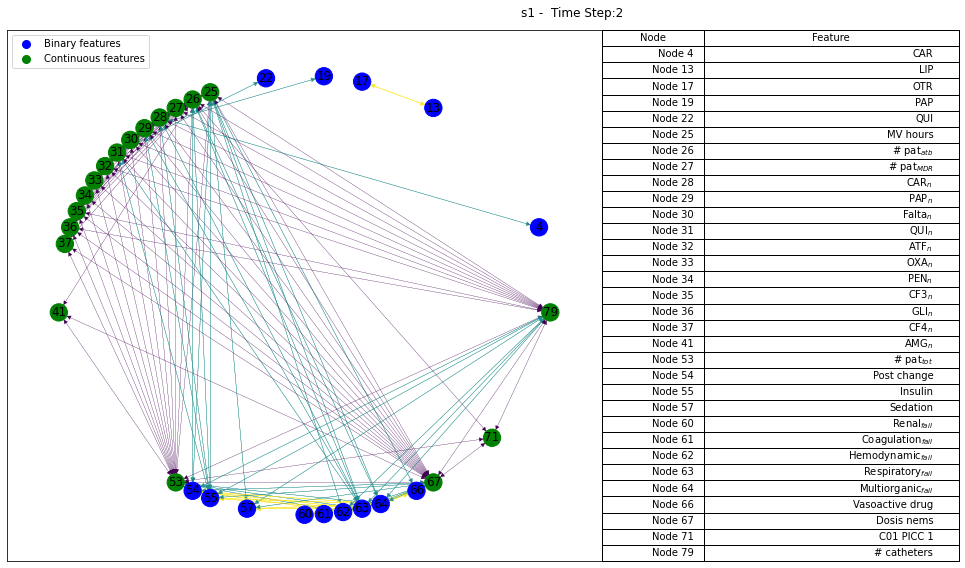

# of edges: 3160 - # of features: 80 - # of max edges: 104


<Figure size 432x288 with 0 Axes>

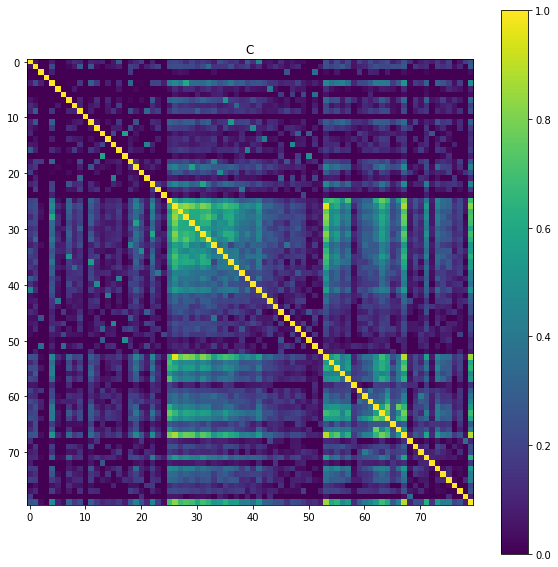

Shape A: (80, 80)
Shape A (1's except diagonal to 0): (80, 80)
1. Create a graph based on previous matrix (1's matrix)
(80, 80)
2. Get the incidence matrix of the previous graph
	shape B01: (3160, 80)
3. Compute C0 as incidence matrix T by covariance matrix by incidence matrix.
C0 shape: (3160, 3160)
4. Obtain the diagonal from the previous calculation
5. Sort the diagonal from smallest to largest, and select the smallest max_E's
6. Obtain a vector of 0's and 1's
7. Get B1_hat as B01 * diag(vec)
8. Obtain A as D - L


<Figure size 432x288 with 0 Axes>

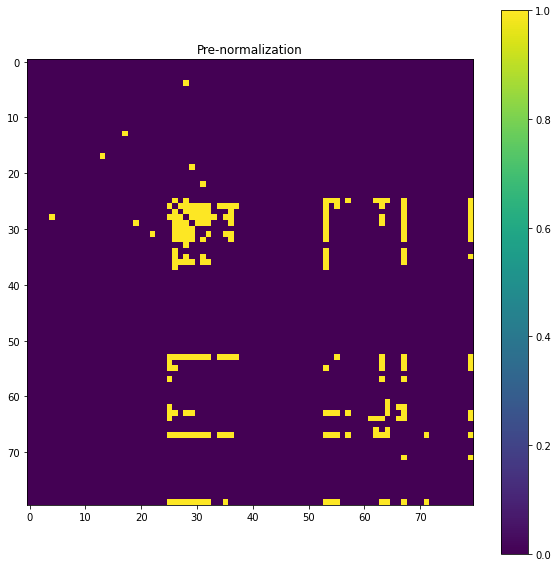

<Figure size 432x288 with 0 Axes>

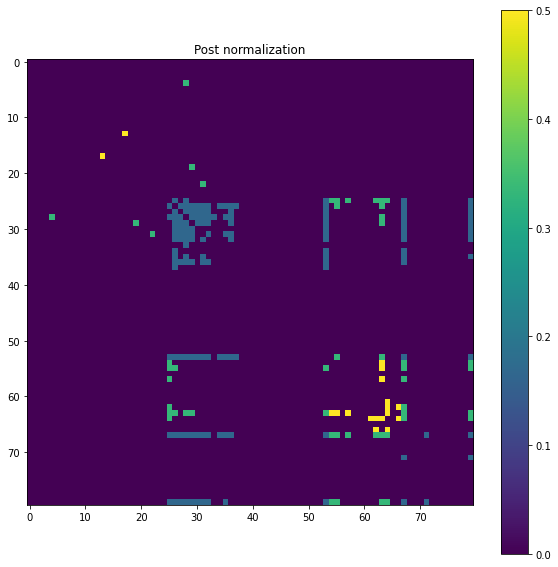

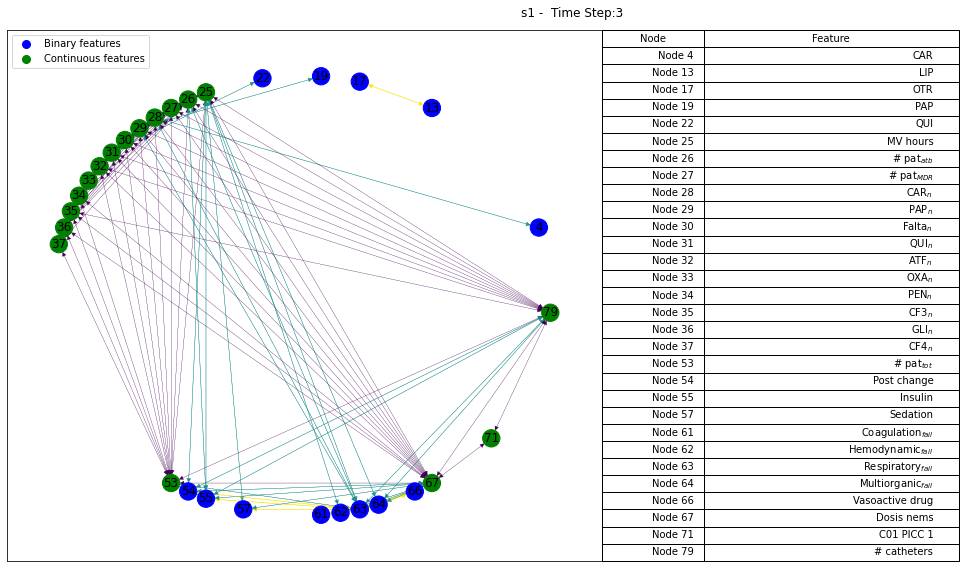

# of edges: 3160 - # of features: 80 - # of max edges: 216


<Figure size 432x288 with 0 Axes>

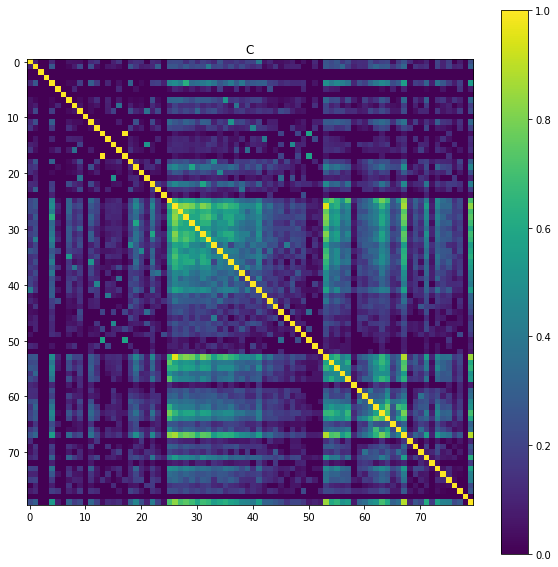

Shape A: (80, 80)
Shape A (1's except diagonal to 0): (80, 80)
1. Create a graph based on previous matrix (1's matrix)
(80, 80)
2. Get the incidence matrix of the previous graph
	shape B01: (3160, 80)
3. Compute C0 as incidence matrix T by covariance matrix by incidence matrix.
C0 shape: (3160, 3160)
4. Obtain the diagonal from the previous calculation
5. Sort the diagonal from smallest to largest, and select the smallest max_E's
6. Obtain a vector of 0's and 1's
7. Get B1_hat as B01 * diag(vec)
8. Obtain A as D - L


<Figure size 432x288 with 0 Axes>

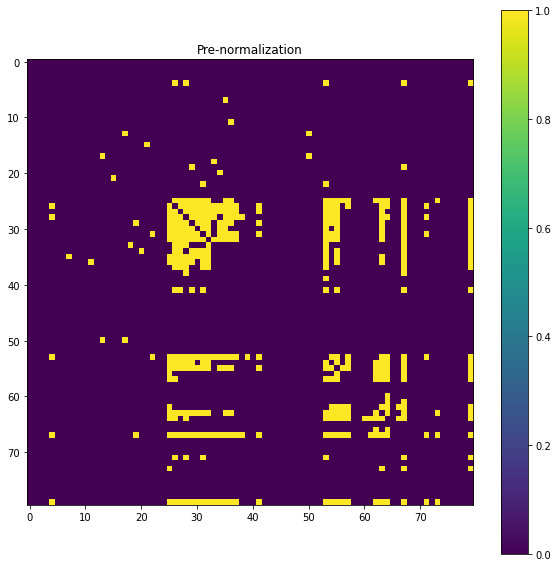

<Figure size 432x288 with 0 Axes>

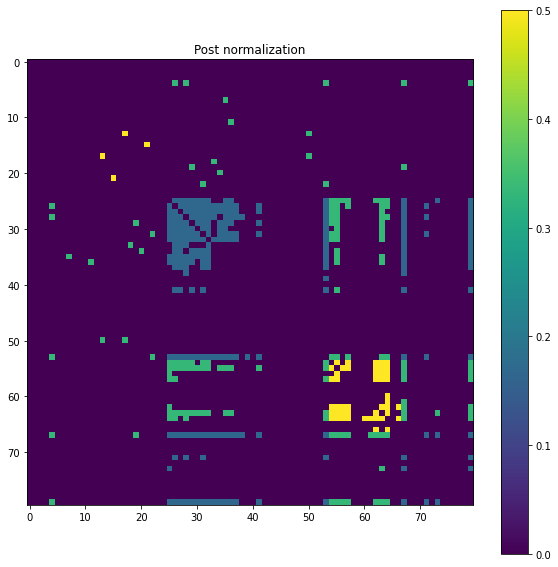

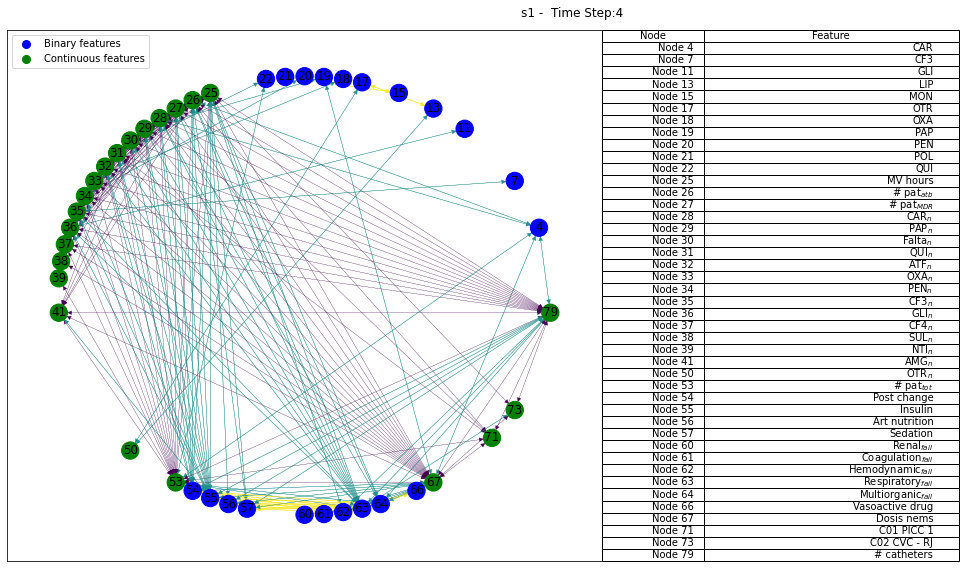

# of edges: 3160 - # of features: 80 - # of max edges: 304


<Figure size 432x288 with 0 Axes>

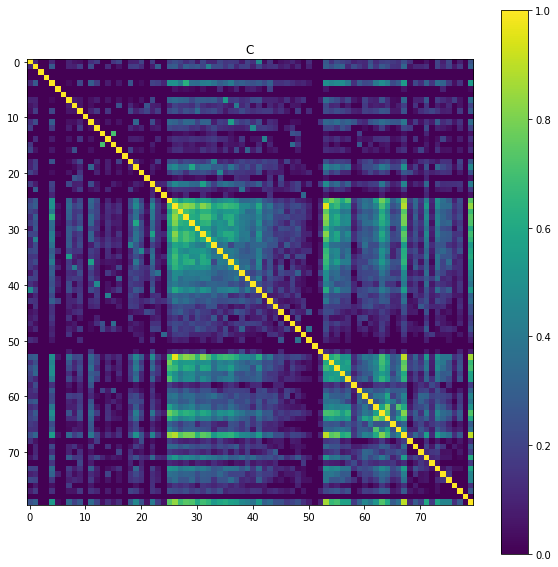

Shape A: (80, 80)
Shape A (1's except diagonal to 0): (80, 80)
1. Create a graph based on previous matrix (1's matrix)
(80, 80)
2. Get the incidence matrix of the previous graph
	shape B01: (3160, 80)
3. Compute C0 as incidence matrix T by covariance matrix by incidence matrix.
C0 shape: (3160, 3160)
4. Obtain the diagonal from the previous calculation
5. Sort the diagonal from smallest to largest, and select the smallest max_E's
6. Obtain a vector of 0's and 1's
7. Get B1_hat as B01 * diag(vec)
8. Obtain A as D - L


<Figure size 432x288 with 0 Axes>

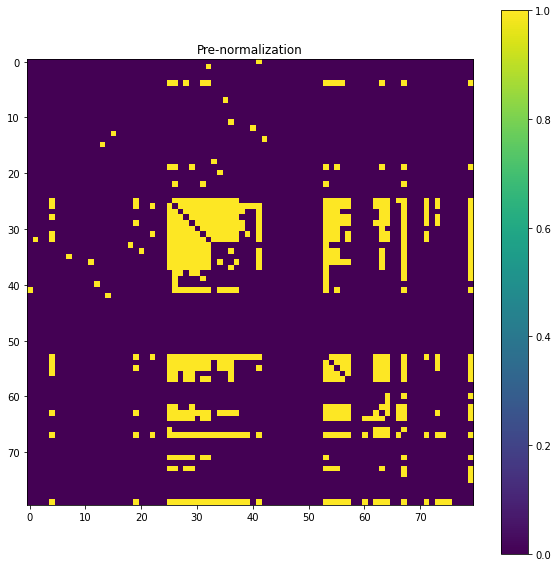

<Figure size 432x288 with 0 Axes>

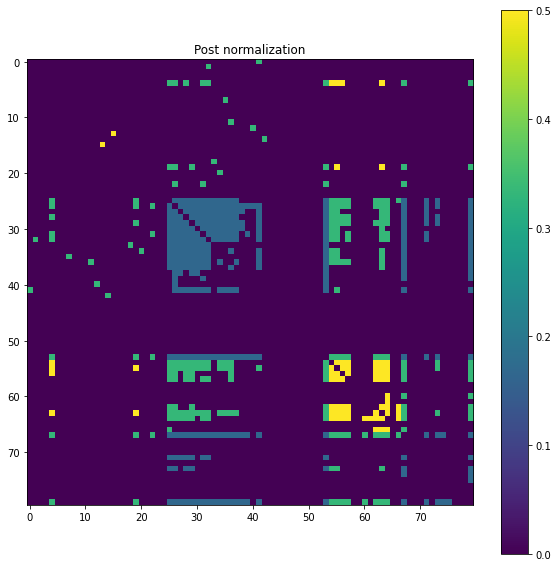

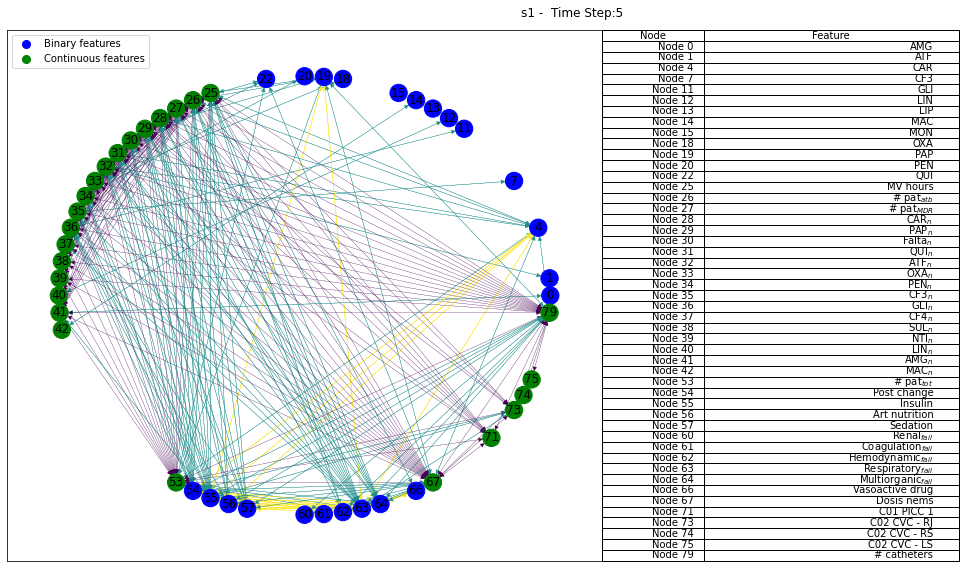

# of edges: 3160 - # of features: 80 - # of max edges: 220


<Figure size 432x288 with 0 Axes>

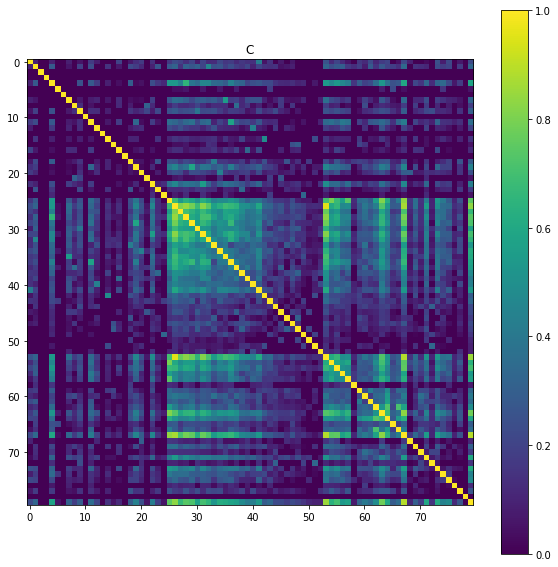

Shape A: (80, 80)
Shape A (1's except diagonal to 0): (80, 80)
1. Create a graph based on previous matrix (1's matrix)
(80, 80)
2. Get the incidence matrix of the previous graph
	shape B01: (3160, 80)
3. Compute C0 as incidence matrix T by covariance matrix by incidence matrix.
C0 shape: (3160, 3160)
4. Obtain the diagonal from the previous calculation
5. Sort the diagonal from smallest to largest, and select the smallest max_E's
6. Obtain a vector of 0's and 1's
7. Get B1_hat as B01 * diag(vec)
8. Obtain A as D - L


<Figure size 432x288 with 0 Axes>

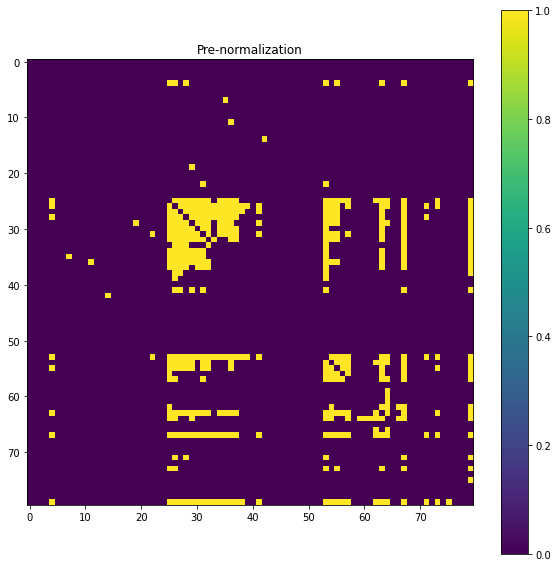

<Figure size 432x288 with 0 Axes>

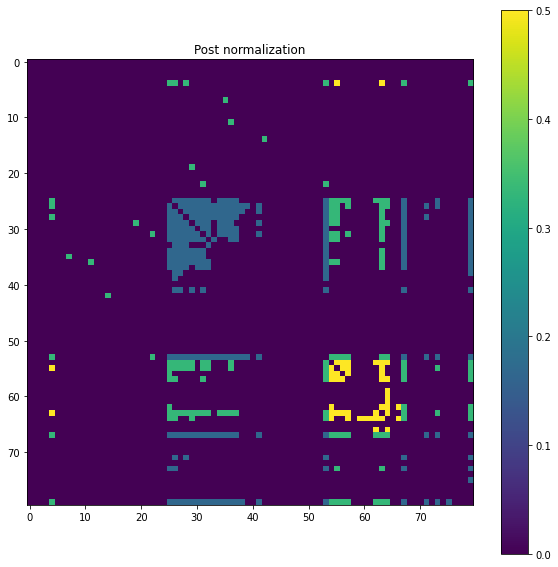

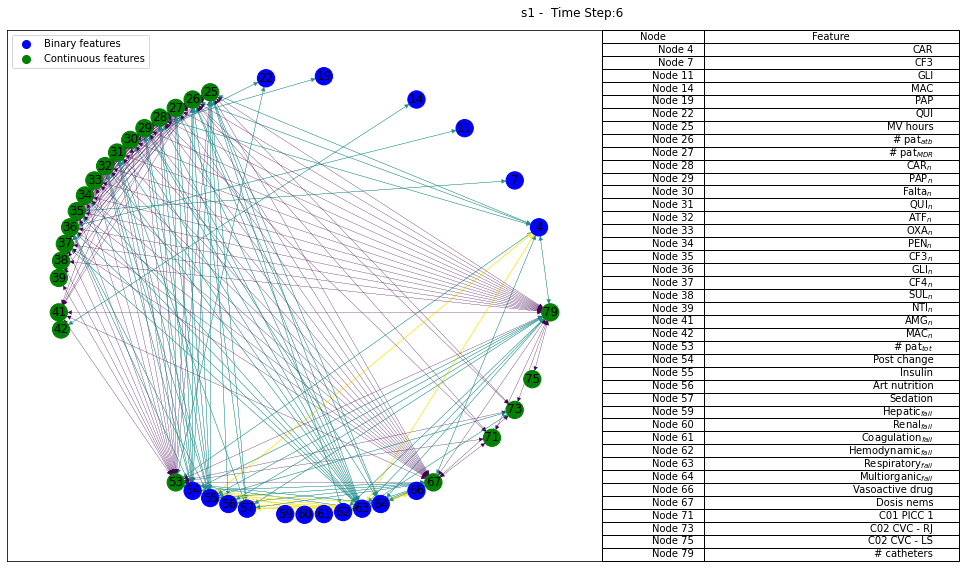

# of edges: 3160 - # of features: 80 - # of max edges: 272


<Figure size 432x288 with 0 Axes>

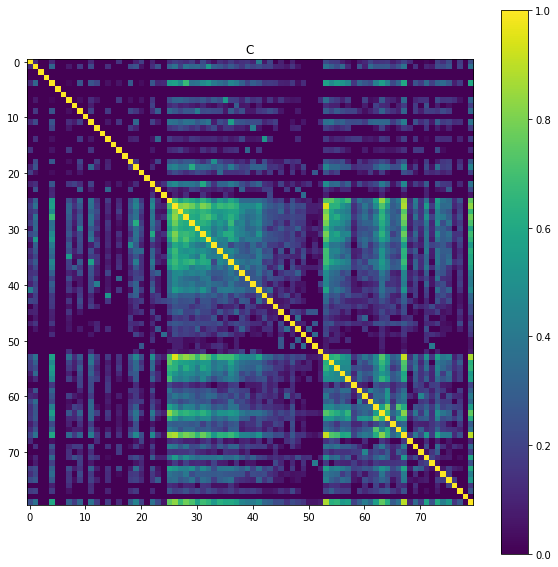

Shape A: (80, 80)
Shape A (1's except diagonal to 0): (80, 80)
1. Create a graph based on previous matrix (1's matrix)
(80, 80)
2. Get the incidence matrix of the previous graph
	shape B01: (3160, 80)
3. Compute C0 as incidence matrix T by covariance matrix by incidence matrix.
C0 shape: (3160, 3160)
4. Obtain the diagonal from the previous calculation
5. Sort the diagonal from smallest to largest, and select the smallest max_E's
6. Obtain a vector of 0's and 1's
7. Get B1_hat as B01 * diag(vec)
8. Obtain A as D - L


<Figure size 432x288 with 0 Axes>

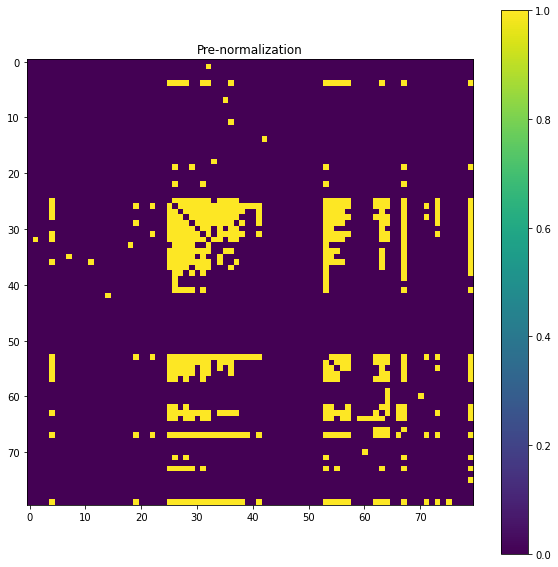

<Figure size 432x288 with 0 Axes>

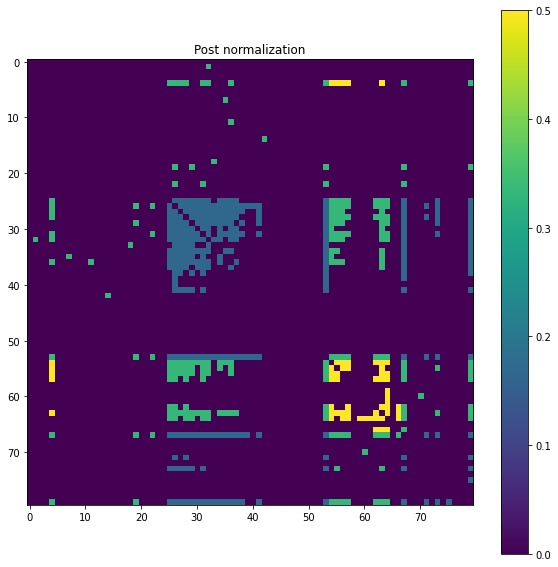

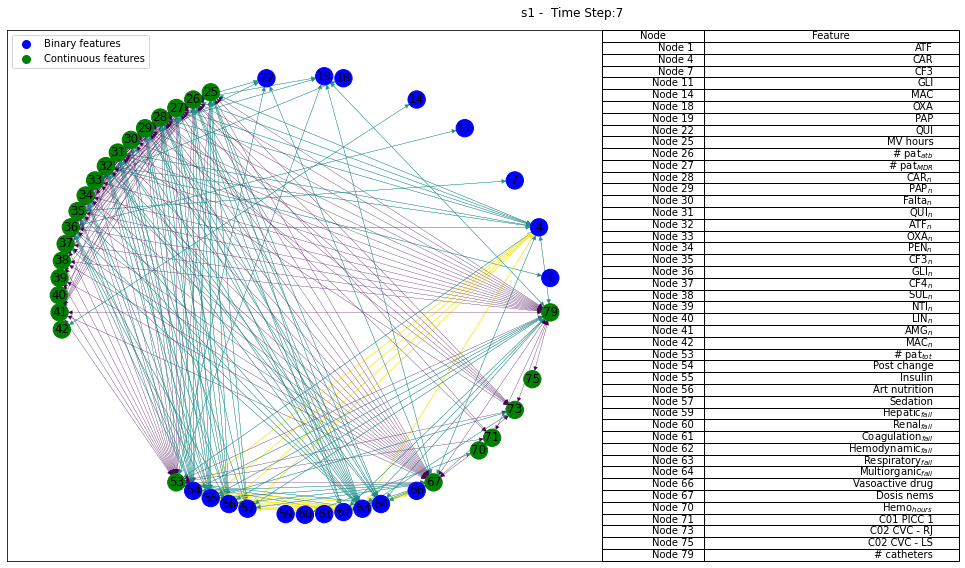

# of edges: 3160 - # of features: 80 - # of max edges: 356


<Figure size 432x288 with 0 Axes>

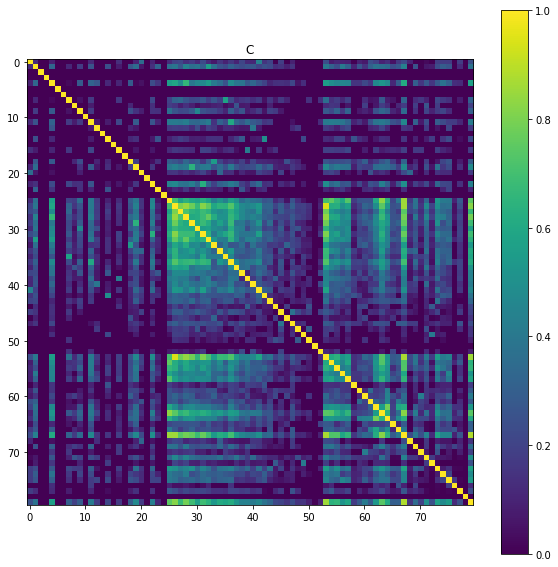

Shape A: (80, 80)
Shape A (1's except diagonal to 0): (80, 80)
1. Create a graph based on previous matrix (1's matrix)
(80, 80)
2. Get the incidence matrix of the previous graph
	shape B01: (3160, 80)
3. Compute C0 as incidence matrix T by covariance matrix by incidence matrix.
C0 shape: (3160, 3160)
4. Obtain the diagonal from the previous calculation
5. Sort the diagonal from smallest to largest, and select the smallest max_E's
6. Obtain a vector of 0's and 1's
7. Get B1_hat as B01 * diag(vec)
8. Obtain A as D - L


<Figure size 432x288 with 0 Axes>

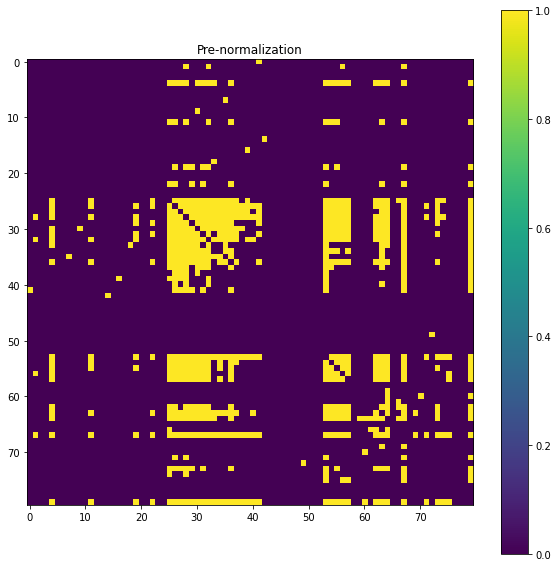

<Figure size 432x288 with 0 Axes>

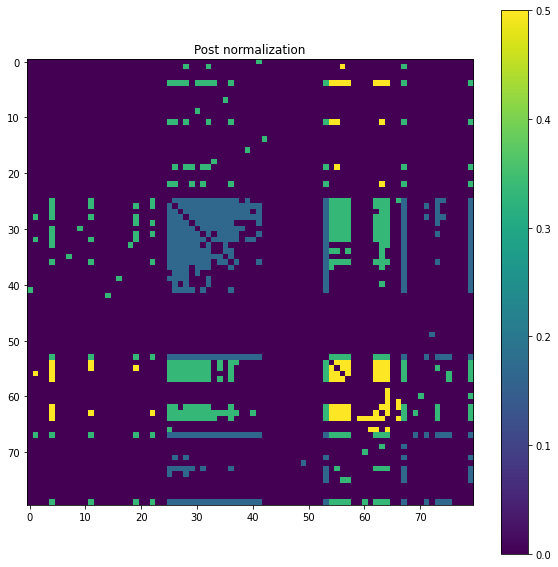

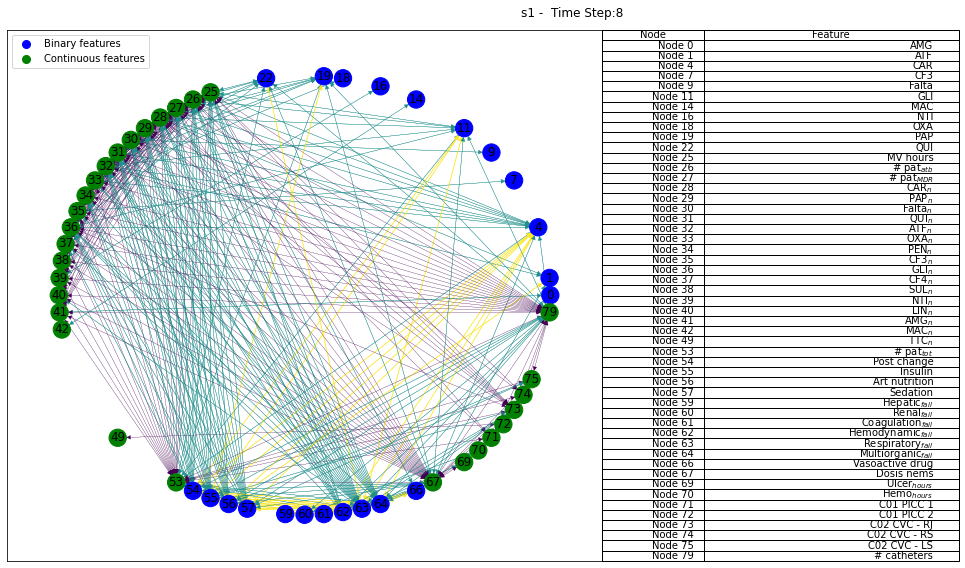

# of edges: 3160 - # of features: 80 - # of max edges: 334


<Figure size 432x288 with 0 Axes>

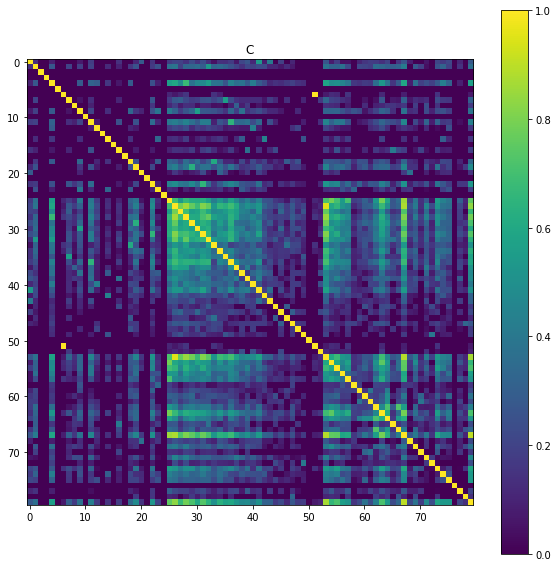

Shape A: (80, 80)
Shape A (1's except diagonal to 0): (80, 80)
1. Create a graph based on previous matrix (1's matrix)
(80, 80)
2. Get the incidence matrix of the previous graph
	shape B01: (3160, 80)
3. Compute C0 as incidence matrix T by covariance matrix by incidence matrix.
C0 shape: (3160, 3160)
4. Obtain the diagonal from the previous calculation
5. Sort the diagonal from smallest to largest, and select the smallest max_E's
6. Obtain a vector of 0's and 1's
7. Get B1_hat as B01 * diag(vec)
8. Obtain A as D - L


<Figure size 432x288 with 0 Axes>

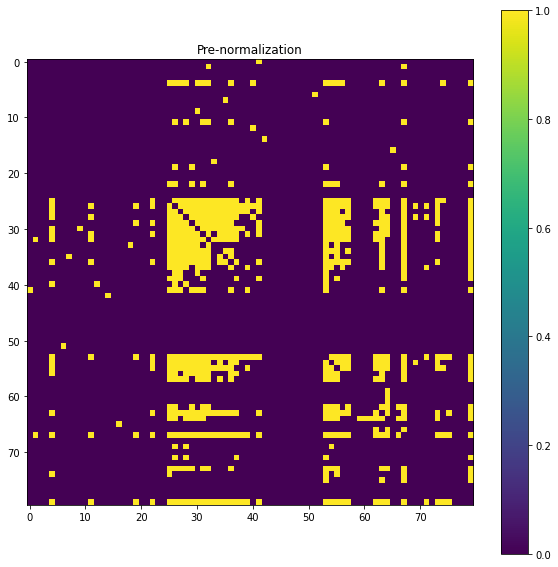

<Figure size 432x288 with 0 Axes>

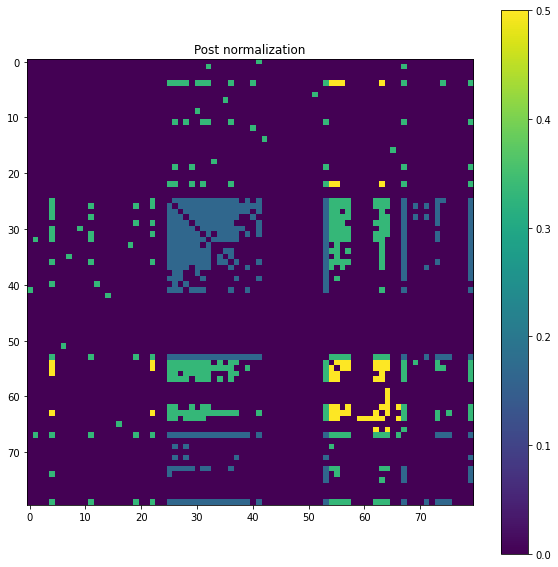

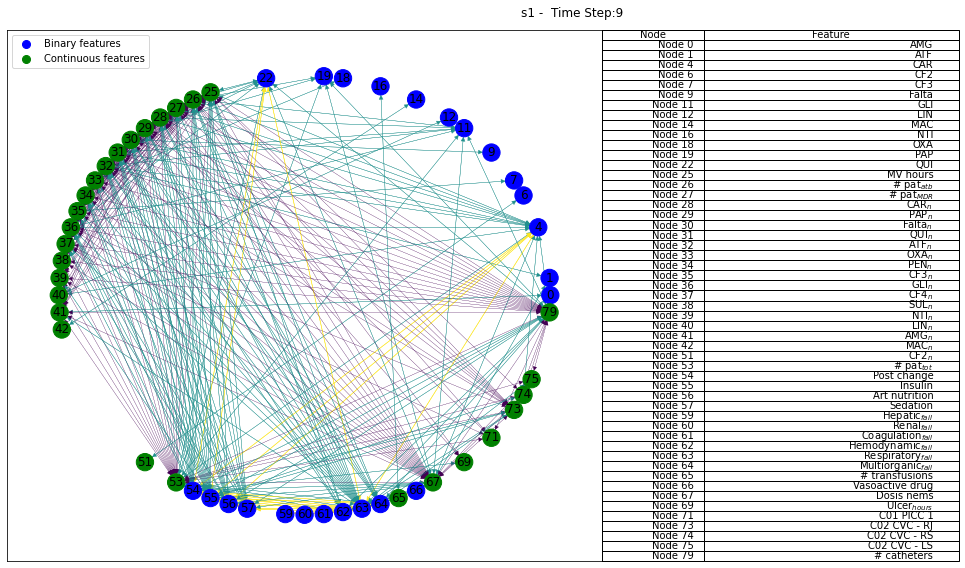

# of edges: 3160 - # of features: 80 - # of max edges: 440


<Figure size 432x288 with 0 Axes>

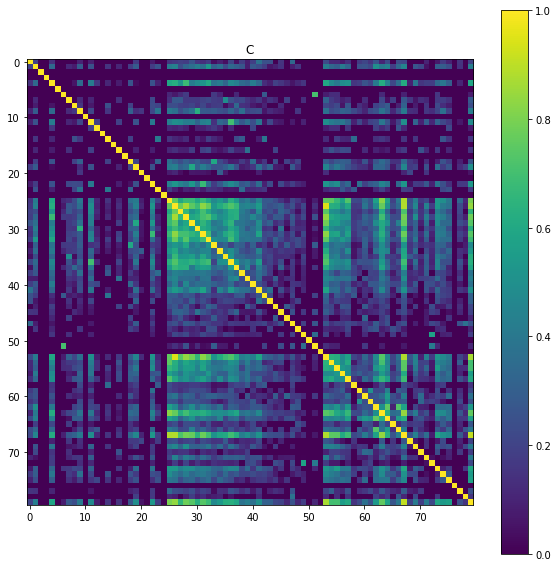

Shape A: (80, 80)
Shape A (1's except diagonal to 0): (80, 80)
1. Create a graph based on previous matrix (1's matrix)
(80, 80)
2. Get the incidence matrix of the previous graph
	shape B01: (3160, 80)
3. Compute C0 as incidence matrix T by covariance matrix by incidence matrix.
C0 shape: (3160, 3160)
4. Obtain the diagonal from the previous calculation
5. Sort the diagonal from smallest to largest, and select the smallest max_E's
6. Obtain a vector of 0's and 1's
7. Get B1_hat as B01 * diag(vec)
8. Obtain A as D - L


<Figure size 432x288 with 0 Axes>

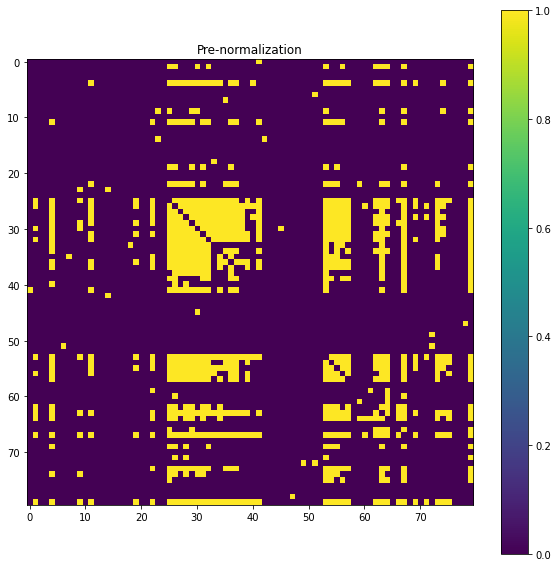

<Figure size 432x288 with 0 Axes>

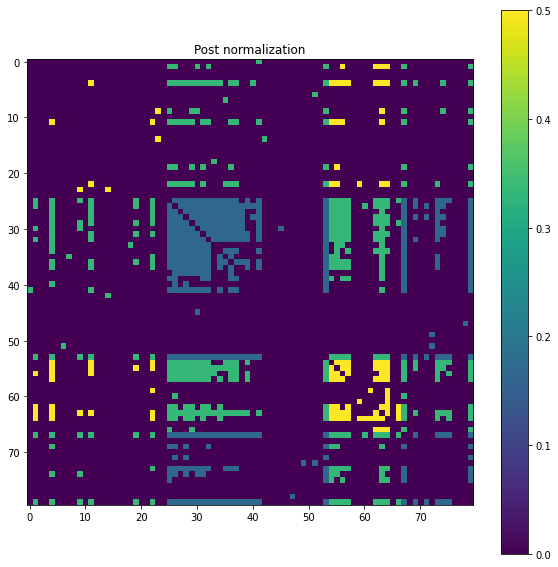

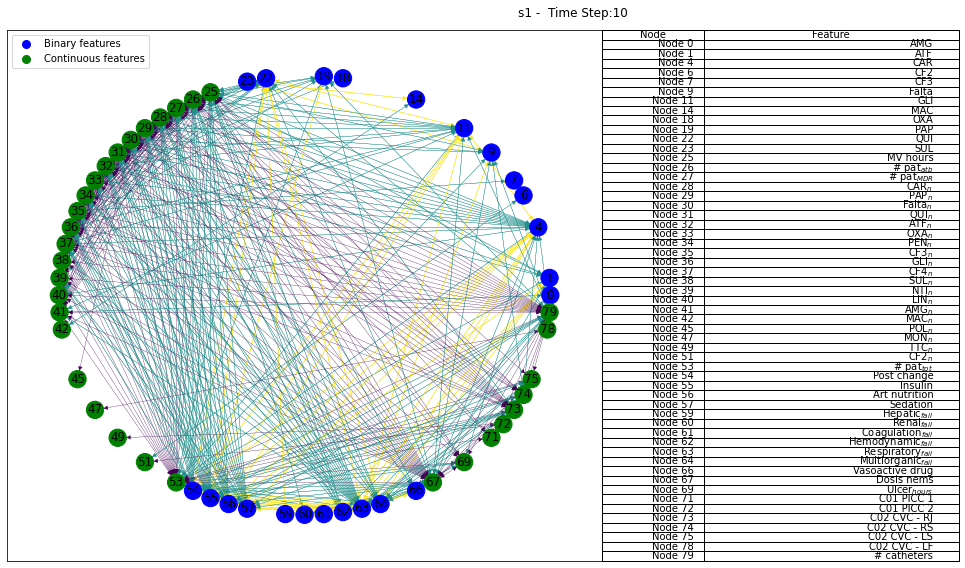

# of edges: 3160 - # of features: 80 - # of max edges: 482


<Figure size 432x288 with 0 Axes>

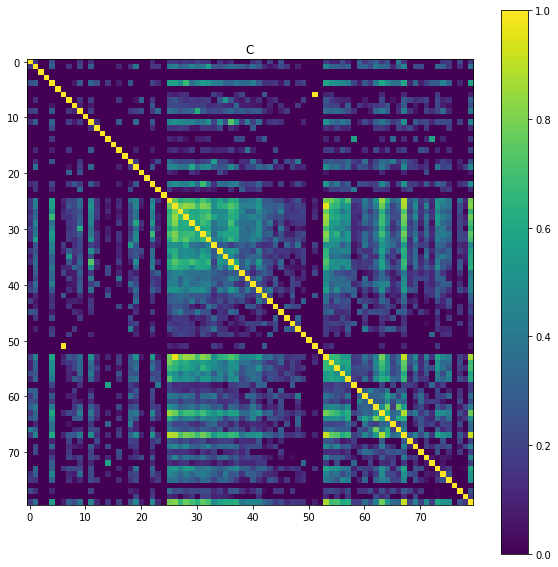

Shape A: (80, 80)
Shape A (1's except diagonal to 0): (80, 80)
1. Create a graph based on previous matrix (1's matrix)
(80, 80)
2. Get the incidence matrix of the previous graph
	shape B01: (3160, 80)
3. Compute C0 as incidence matrix T by covariance matrix by incidence matrix.
C0 shape: (3160, 3160)
4. Obtain the diagonal from the previous calculation
5. Sort the diagonal from smallest to largest, and select the smallest max_E's
6. Obtain a vector of 0's and 1's
7. Get B1_hat as B01 * diag(vec)
8. Obtain A as D - L


<Figure size 432x288 with 0 Axes>

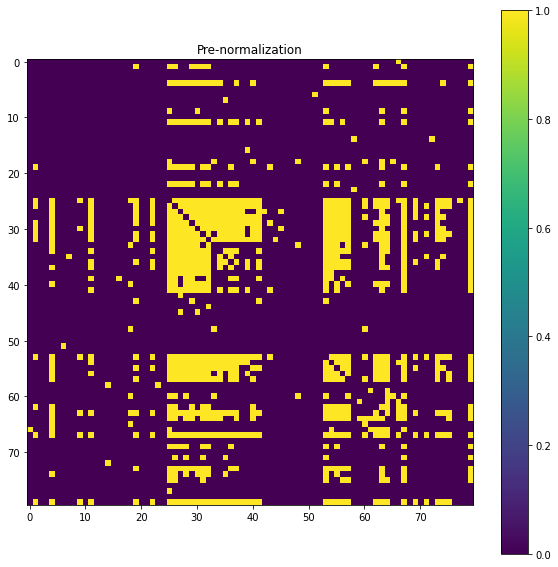

<Figure size 432x288 with 0 Axes>

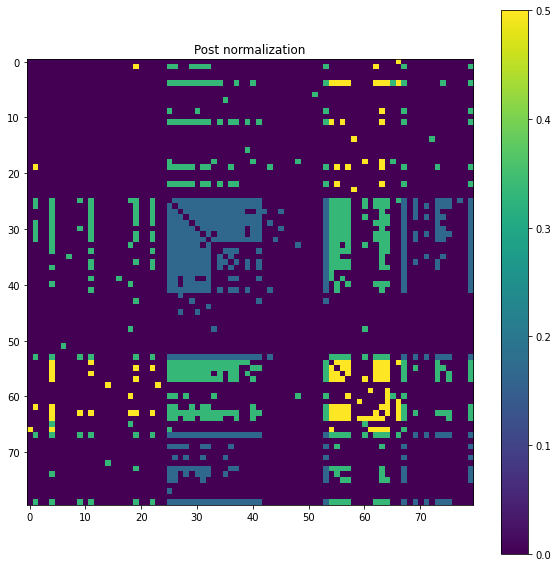

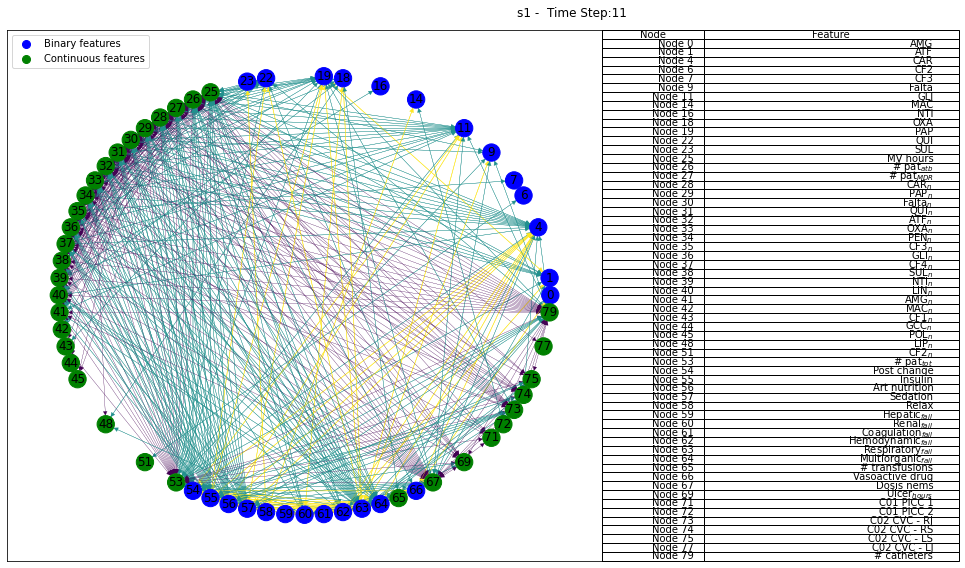

# of edges: 3160 - # of features: 80 - # of max edges: 524


<Figure size 432x288 with 0 Axes>

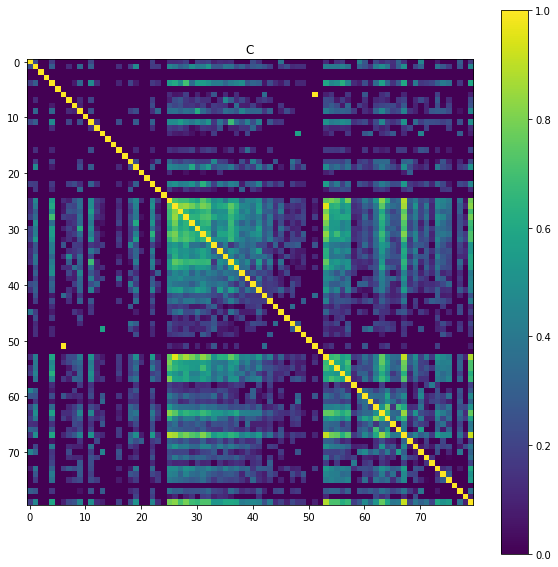

Shape A: (80, 80)
Shape A (1's except diagonal to 0): (80, 80)
1. Create a graph based on previous matrix (1's matrix)
(80, 80)
2. Get the incidence matrix of the previous graph
	shape B01: (3160, 80)
3. Compute C0 as incidence matrix T by covariance matrix by incidence matrix.
C0 shape: (3160, 3160)
4. Obtain the diagonal from the previous calculation
5. Sort the diagonal from smallest to largest, and select the smallest max_E's
6. Obtain a vector of 0's and 1's
7. Get B1_hat as B01 * diag(vec)
8. Obtain A as D - L


<Figure size 432x288 with 0 Axes>

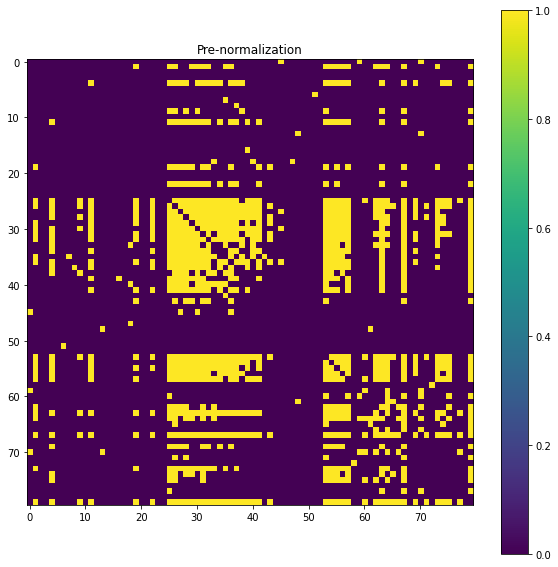

<Figure size 432x288 with 0 Axes>

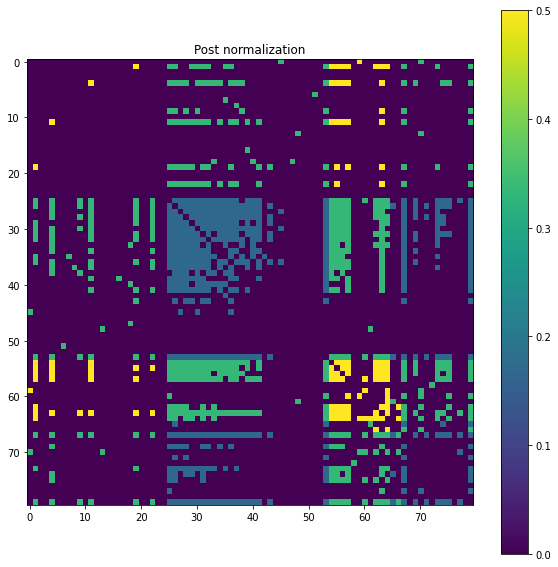

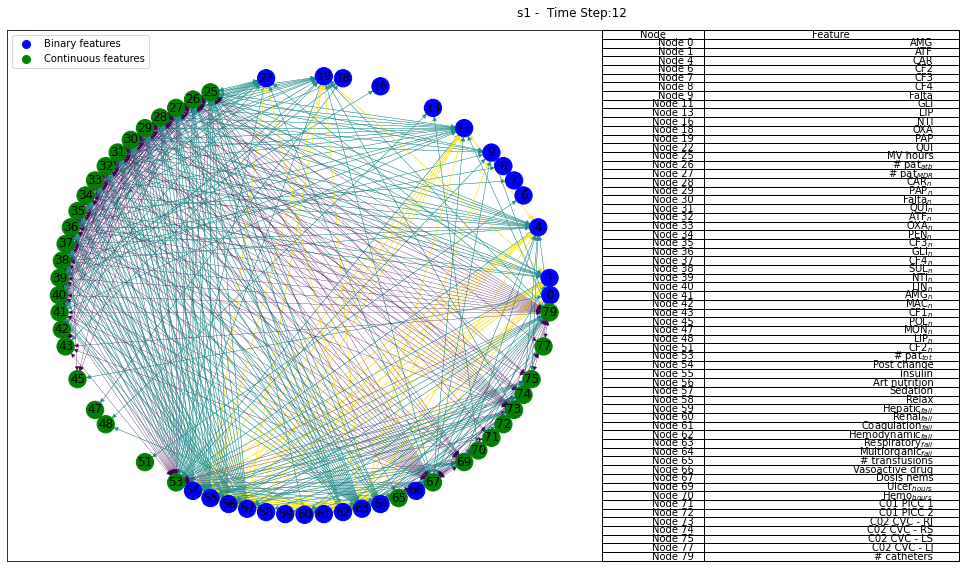

# of edges: 3160 - # of features: 80 - # of max edges: 398


<Figure size 432x288 with 0 Axes>

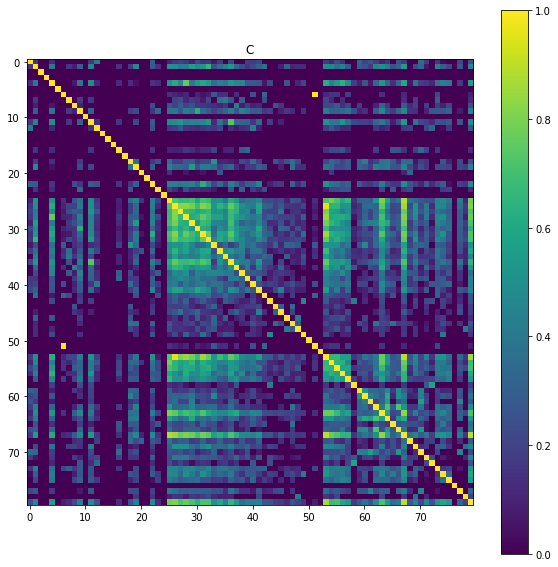

Shape A: (80, 80)
Shape A (1's except diagonal to 0): (80, 80)
1. Create a graph based on previous matrix (1's matrix)
(80, 80)
2. Get the incidence matrix of the previous graph
	shape B01: (3160, 80)
3. Compute C0 as incidence matrix T by covariance matrix by incidence matrix.
C0 shape: (3160, 3160)
4. Obtain the diagonal from the previous calculation
5. Sort the diagonal from smallest to largest, and select the smallest max_E's
6. Obtain a vector of 0's and 1's
7. Get B1_hat as B01 * diag(vec)
8. Obtain A as D - L


<Figure size 432x288 with 0 Axes>

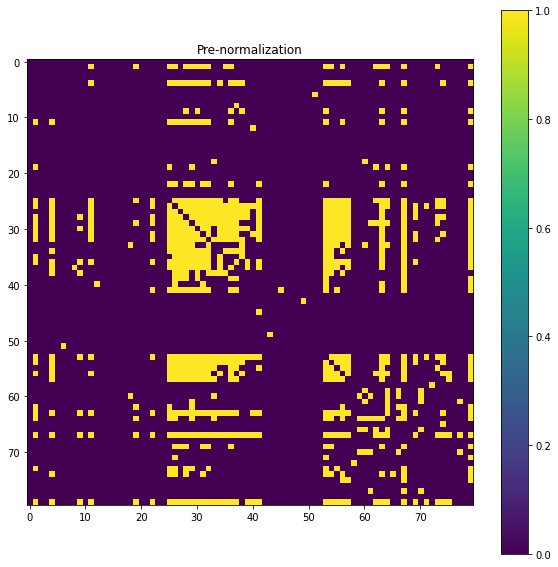

<Figure size 432x288 with 0 Axes>

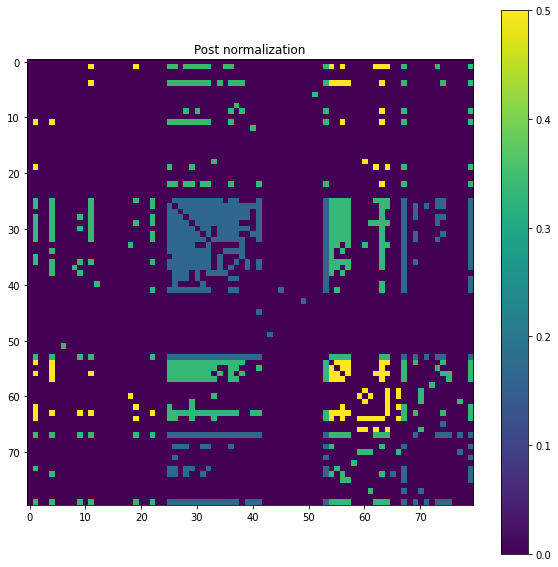

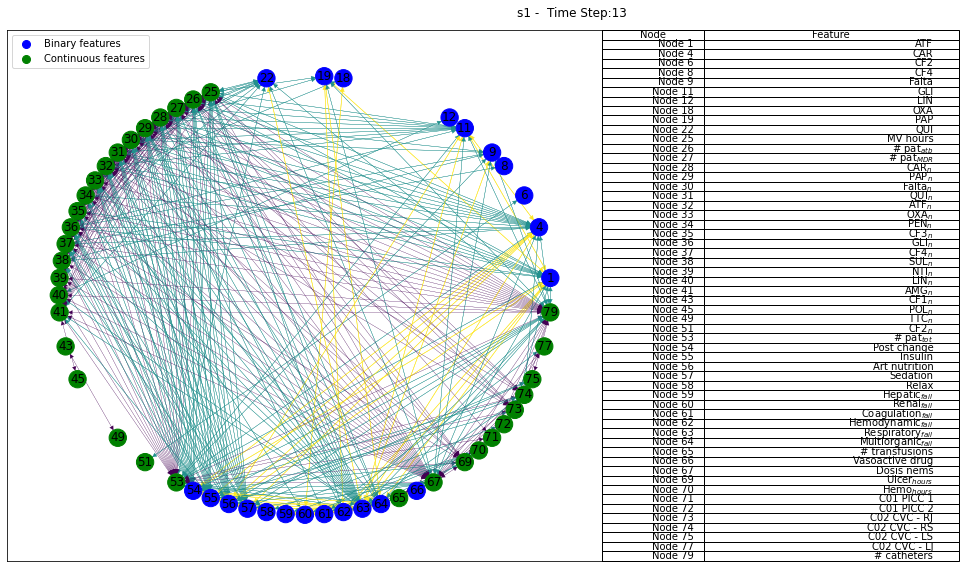

# of edges: 3160 - # of features: 80 - # of max edges: 165


<Figure size 432x288 with 0 Axes>

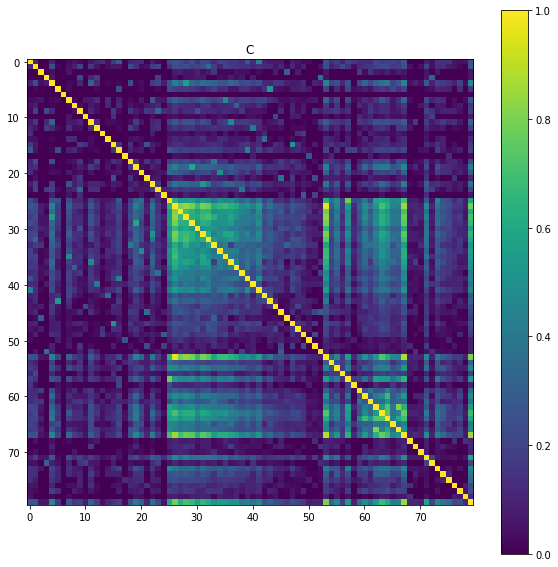

Shape A: (80, 80)
Shape A (1's except diagonal to 0): (80, 80)
1. Create a graph based on previous matrix (1's matrix)
(80, 80)
2. Get the incidence matrix of the previous graph
	shape B01: (3160, 80)
3. Compute C0 as incidence matrix T by covariance matrix by incidence matrix.
C0 shape: (3160, 3160)
4. Obtain the diagonal from the previous calculation
5. Sort the diagonal from smallest to largest, and select the smallest max_E's
6. Obtain a vector of 0's and 1's
7. Get B1_hat as B01 * diag(vec)
8. Obtain A as D - L


<Figure size 432x288 with 0 Axes>

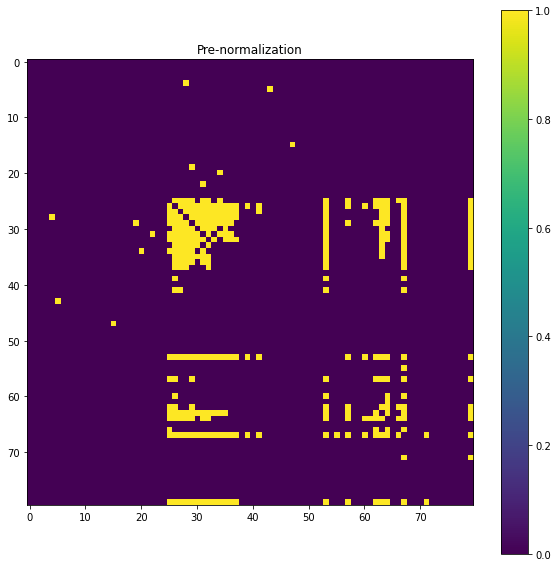

<Figure size 432x288 with 0 Axes>

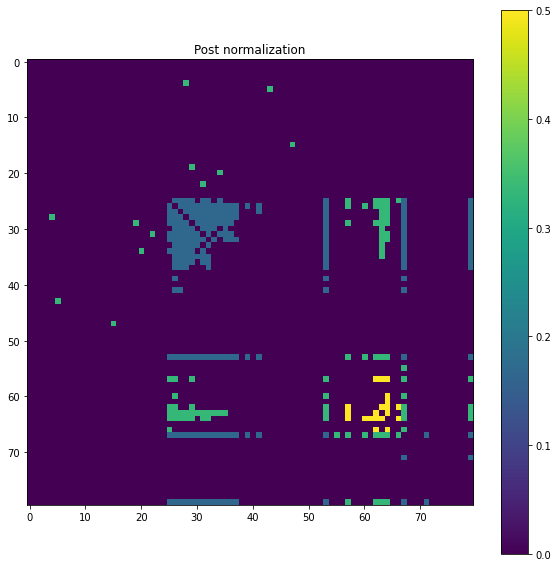

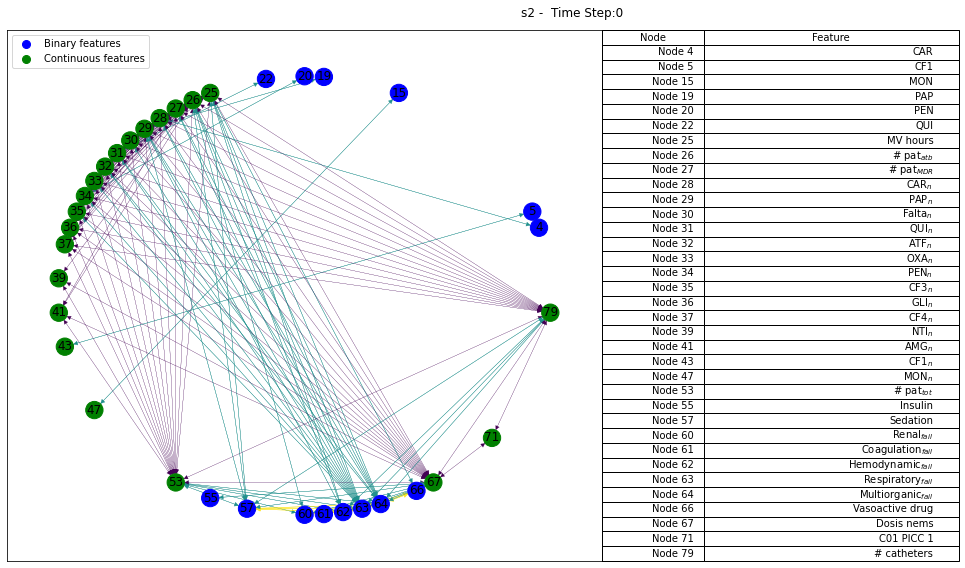

# of edges: 3160 - # of features: 80 - # of max edges: 94


<Figure size 432x288 with 0 Axes>

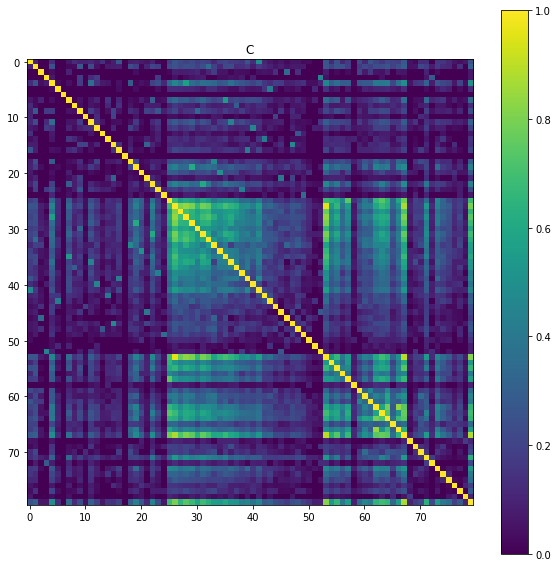

Shape A: (80, 80)
Shape A (1's except diagonal to 0): (80, 80)
1. Create a graph based on previous matrix (1's matrix)
(80, 80)
2. Get the incidence matrix of the previous graph
	shape B01: (3160, 80)
3. Compute C0 as incidence matrix T by covariance matrix by incidence matrix.
C0 shape: (3160, 3160)
4. Obtain the diagonal from the previous calculation
5. Sort the diagonal from smallest to largest, and select the smallest max_E's
6. Obtain a vector of 0's and 1's
7. Get B1_hat as B01 * diag(vec)
8. Obtain A as D - L


<Figure size 432x288 with 0 Axes>

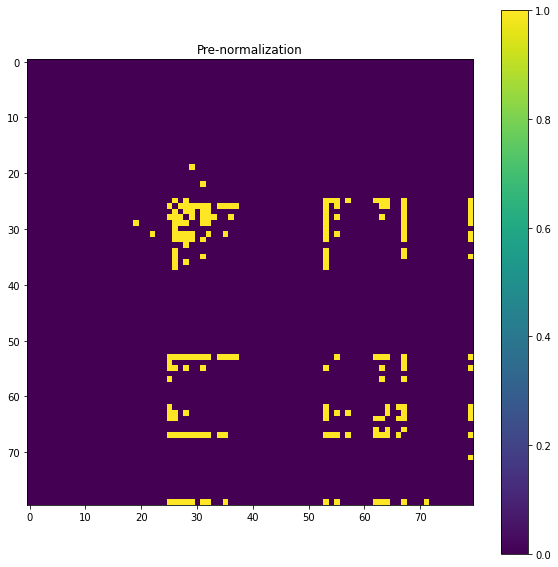

<Figure size 432x288 with 0 Axes>

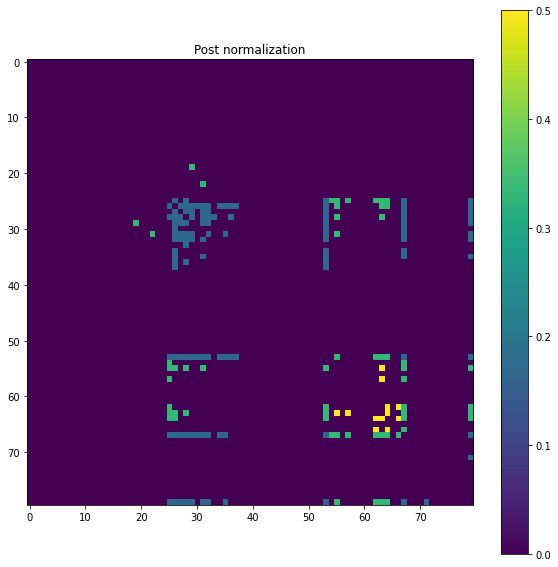

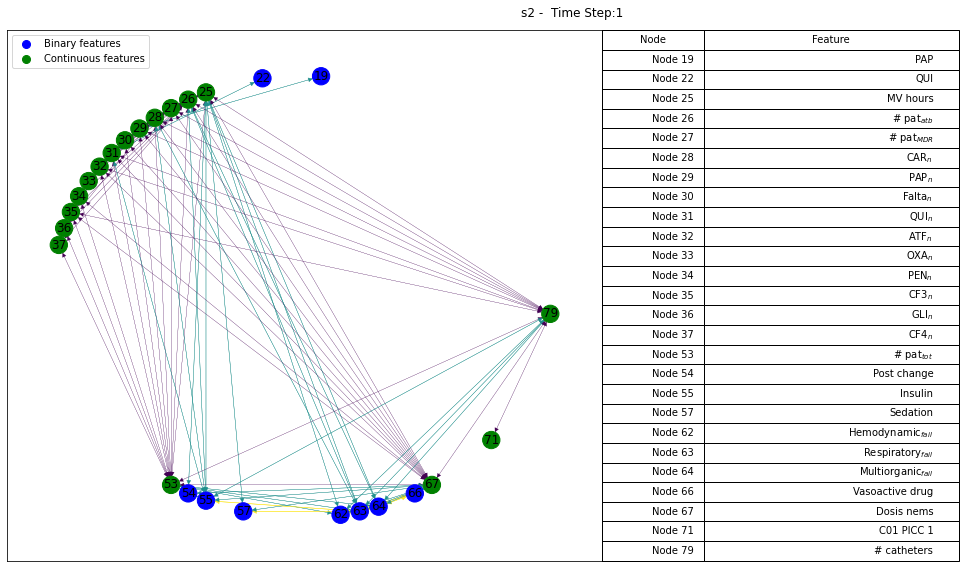

# of edges: 3160 - # of features: 80 - # of max edges: 114


<Figure size 432x288 with 0 Axes>

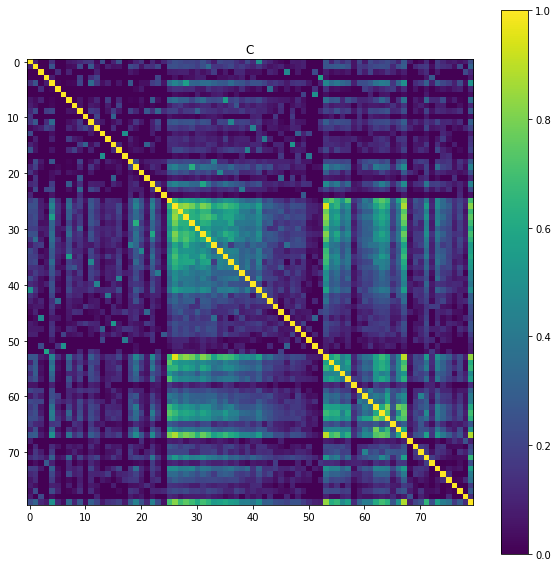

Shape A: (80, 80)
Shape A (1's except diagonal to 0): (80, 80)
1. Create a graph based on previous matrix (1's matrix)
(80, 80)
2. Get the incidence matrix of the previous graph
	shape B01: (3160, 80)
3. Compute C0 as incidence matrix T by covariance matrix by incidence matrix.
C0 shape: (3160, 3160)
4. Obtain the diagonal from the previous calculation
5. Sort the diagonal from smallest to largest, and select the smallest max_E's
6. Obtain a vector of 0's and 1's
7. Get B1_hat as B01 * diag(vec)
8. Obtain A as D - L


<Figure size 432x288 with 0 Axes>

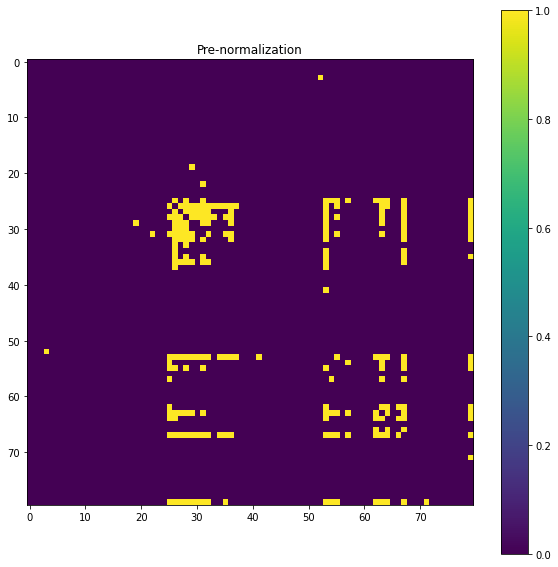

<Figure size 432x288 with 0 Axes>

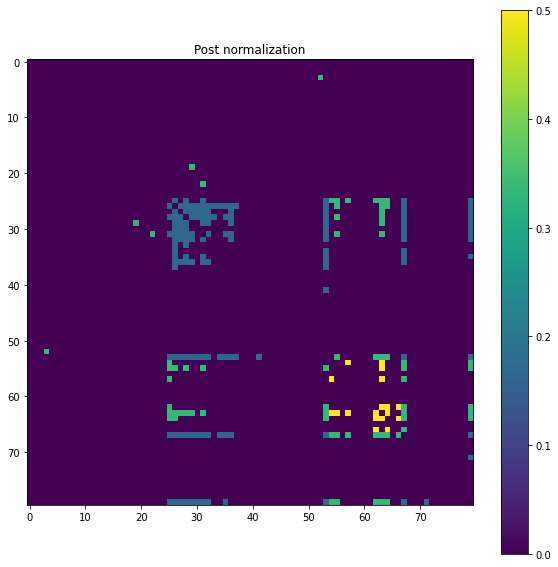

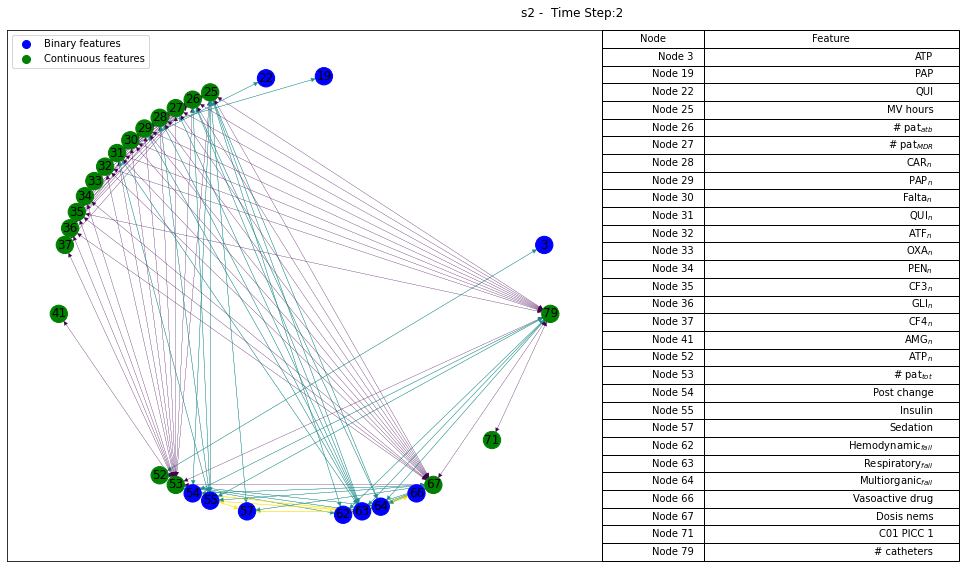

# of edges: 3160 - # of features: 80 - # of max edges: 72


<Figure size 432x288 with 0 Axes>

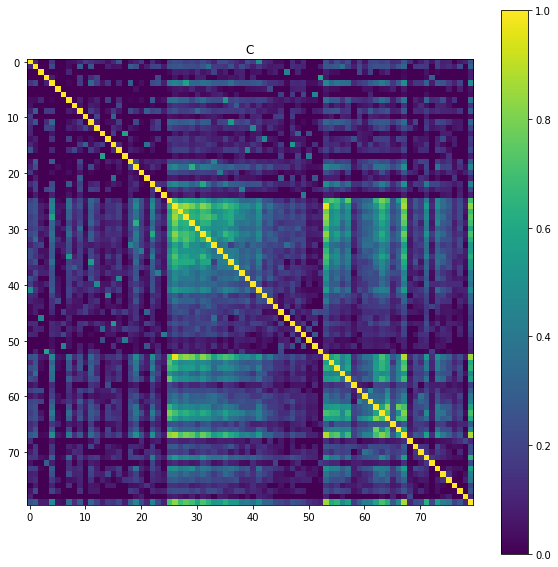

Shape A: (80, 80)
Shape A (1's except diagonal to 0): (80, 80)
1. Create a graph based on previous matrix (1's matrix)
(80, 80)
2. Get the incidence matrix of the previous graph
	shape B01: (3160, 80)
3. Compute C0 as incidence matrix T by covariance matrix by incidence matrix.
C0 shape: (3160, 3160)
4. Obtain the diagonal from the previous calculation
5. Sort the diagonal from smallest to largest, and select the smallest max_E's
6. Obtain a vector of 0's and 1's
7. Get B1_hat as B01 * diag(vec)
8. Obtain A as D - L


<Figure size 432x288 with 0 Axes>

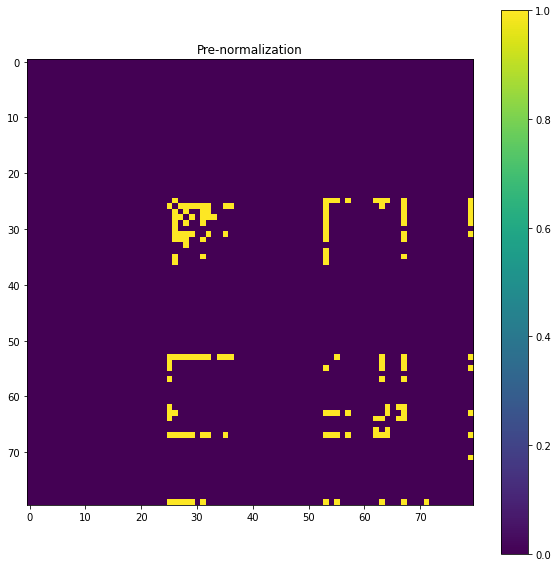

<Figure size 432x288 with 0 Axes>

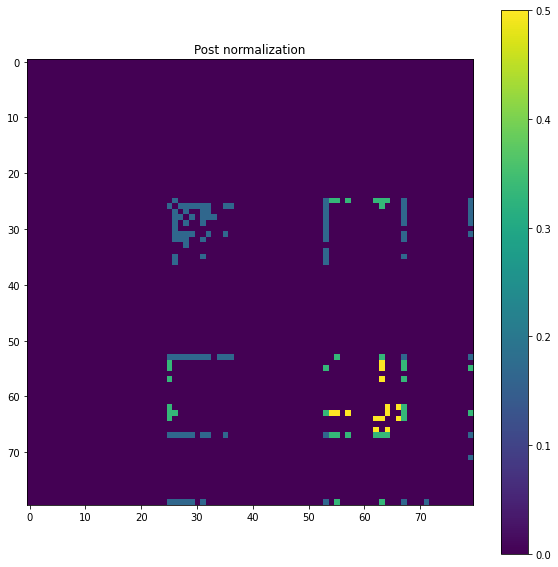

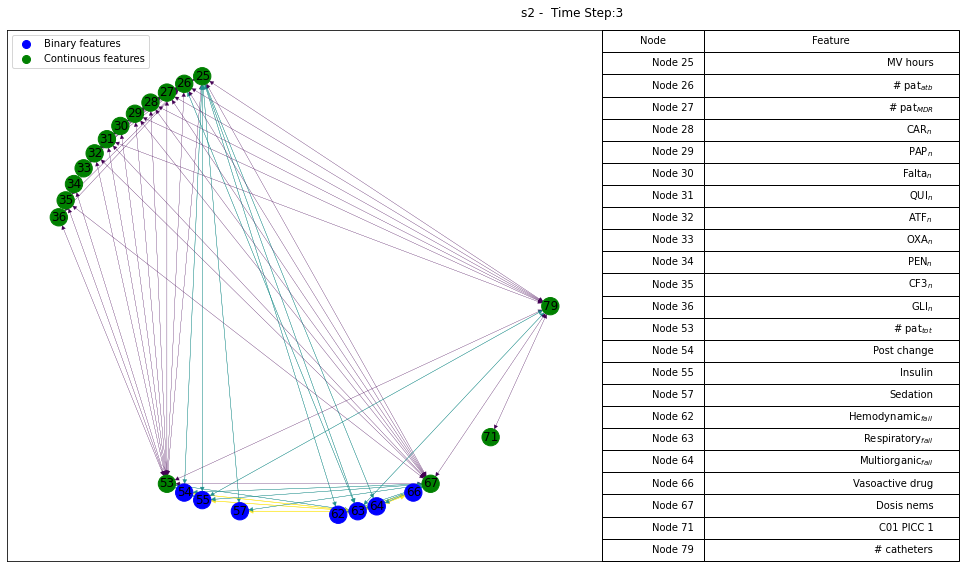

# of edges: 3160 - # of features: 80 - # of max edges: 130


<Figure size 432x288 with 0 Axes>

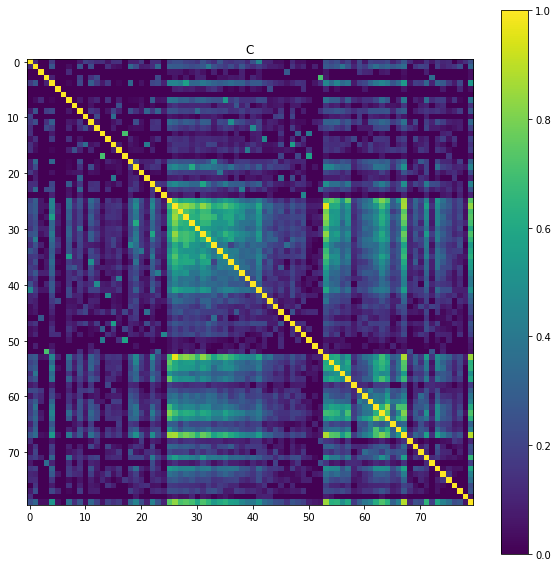

Shape A: (80, 80)
Shape A (1's except diagonal to 0): (80, 80)
1. Create a graph based on previous matrix (1's matrix)
(80, 80)
2. Get the incidence matrix of the previous graph
	shape B01: (3160, 80)
3. Compute C0 as incidence matrix T by covariance matrix by incidence matrix.
C0 shape: (3160, 3160)
4. Obtain the diagonal from the previous calculation
5. Sort the diagonal from smallest to largest, and select the smallest max_E's
6. Obtain a vector of 0's and 1's
7. Get B1_hat as B01 * diag(vec)
8. Obtain A as D - L


<Figure size 432x288 with 0 Axes>

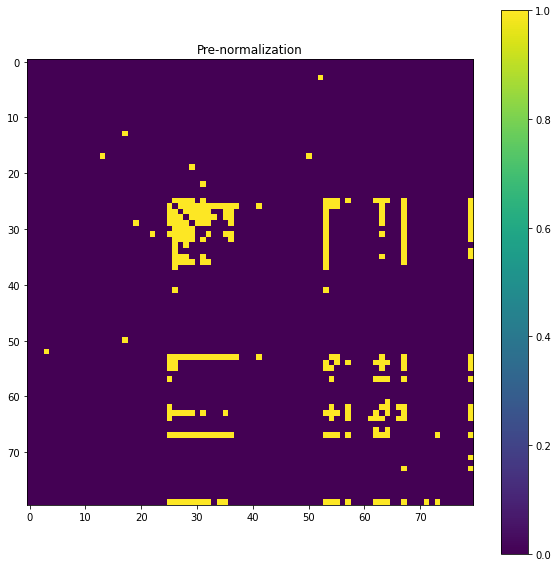

<Figure size 432x288 with 0 Axes>

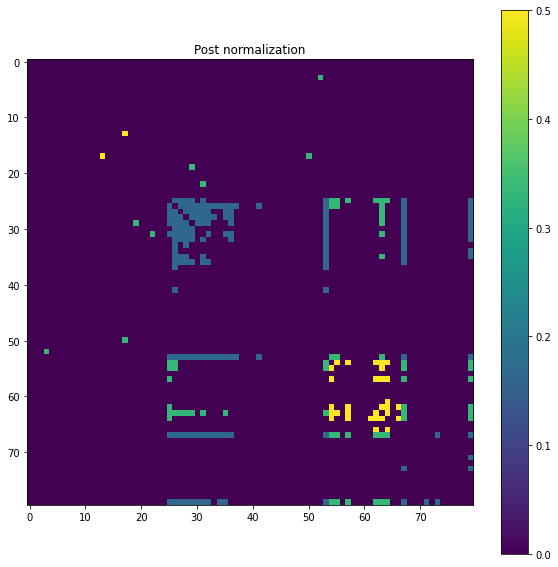

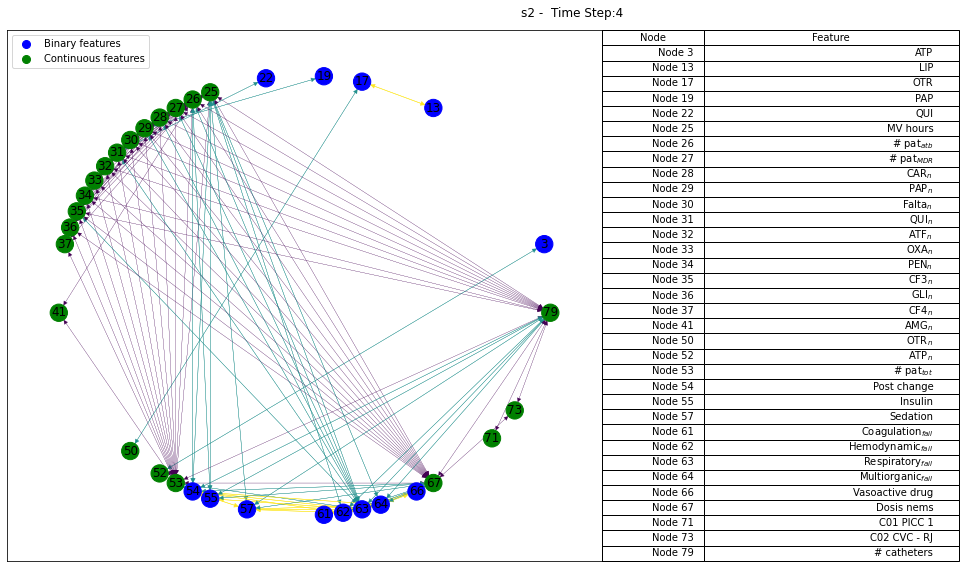

# of edges: 3160 - # of features: 80 - # of max edges: 110


<Figure size 432x288 with 0 Axes>

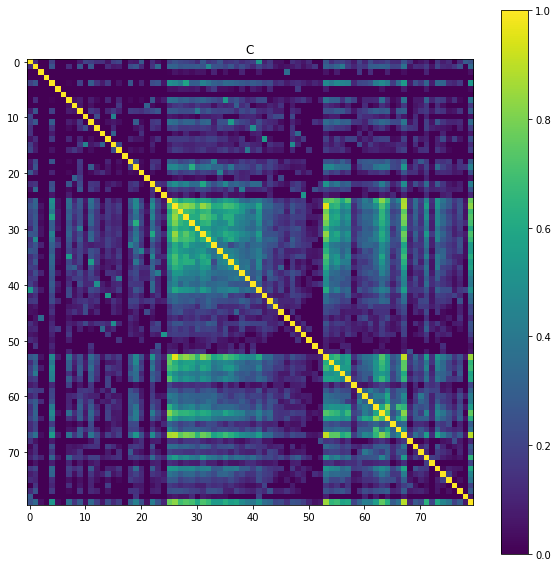

Shape A: (80, 80)
Shape A (1's except diagonal to 0): (80, 80)
1. Create a graph based on previous matrix (1's matrix)
(80, 80)
2. Get the incidence matrix of the previous graph
	shape B01: (3160, 80)
3. Compute C0 as incidence matrix T by covariance matrix by incidence matrix.
C0 shape: (3160, 3160)
4. Obtain the diagonal from the previous calculation
5. Sort the diagonal from smallest to largest, and select the smallest max_E's
6. Obtain a vector of 0's and 1's
7. Get B1_hat as B01 * diag(vec)
8. Obtain A as D - L


<Figure size 432x288 with 0 Axes>

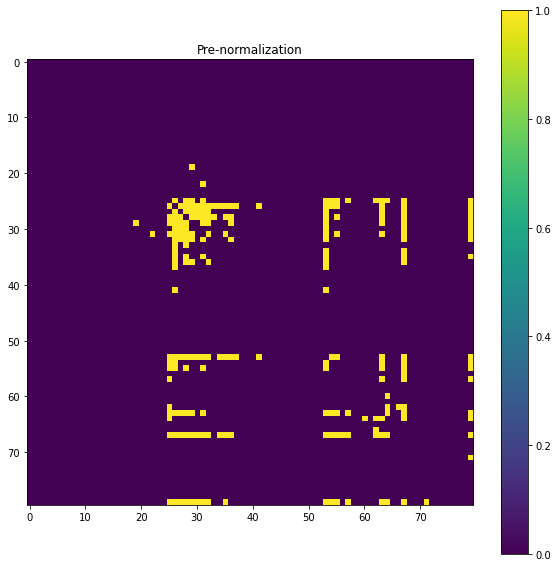

<Figure size 432x288 with 0 Axes>

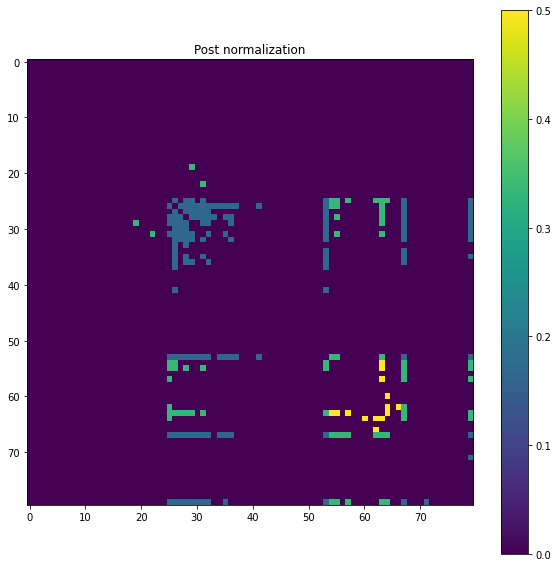

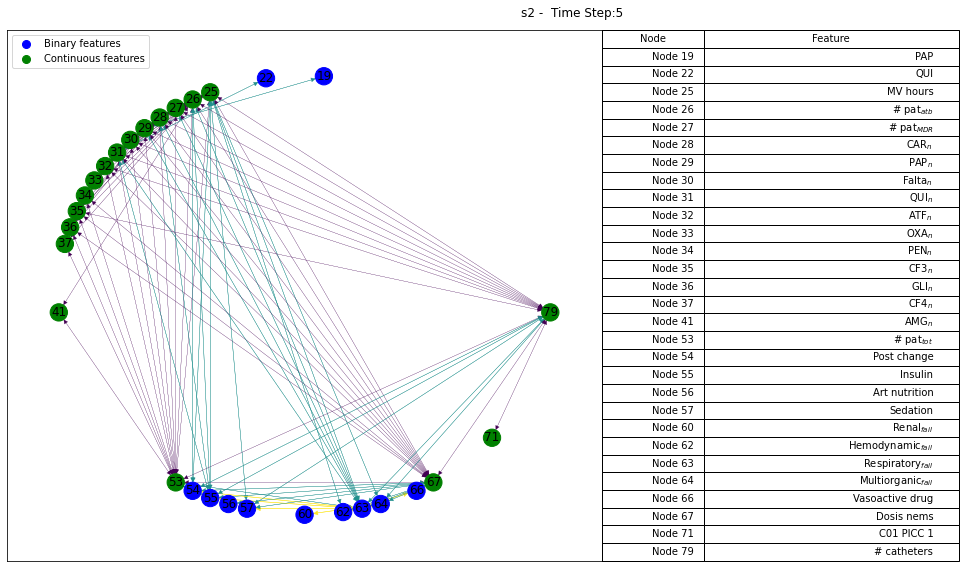

# of edges: 3160 - # of features: 80 - # of max edges: 150


<Figure size 432x288 with 0 Axes>

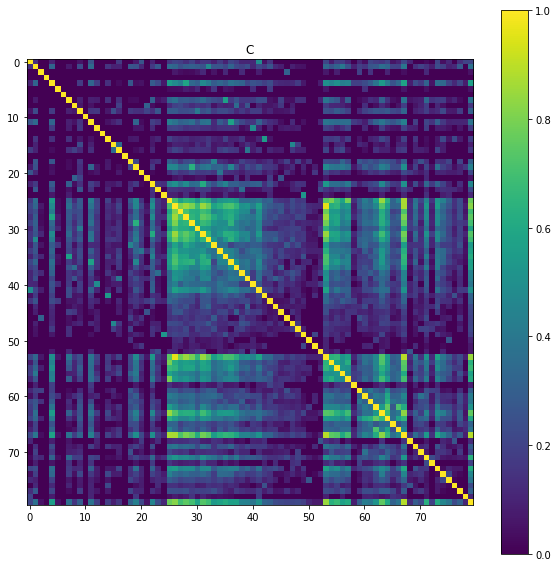

Shape A: (80, 80)
Shape A (1's except diagonal to 0): (80, 80)
1. Create a graph based on previous matrix (1's matrix)
(80, 80)
2. Get the incidence matrix of the previous graph
	shape B01: (3160, 80)
3. Compute C0 as incidence matrix T by covariance matrix by incidence matrix.
C0 shape: (3160, 3160)
4. Obtain the diagonal from the previous calculation
5. Sort the diagonal from smallest to largest, and select the smallest max_E's
6. Obtain a vector of 0's and 1's
7. Get B1_hat as B01 * diag(vec)
8. Obtain A as D - L


<Figure size 432x288 with 0 Axes>

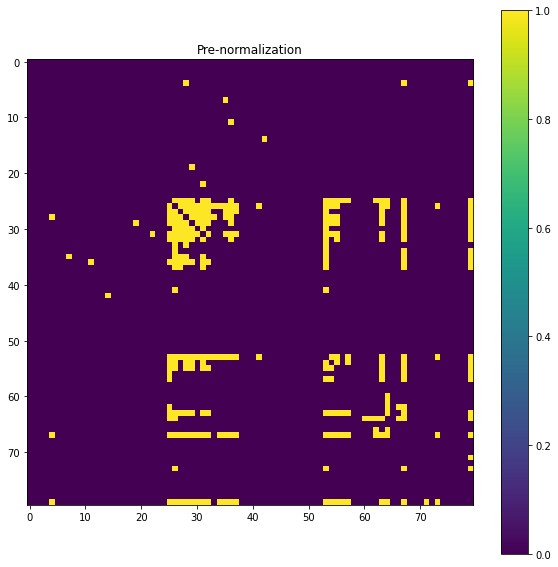

<Figure size 432x288 with 0 Axes>

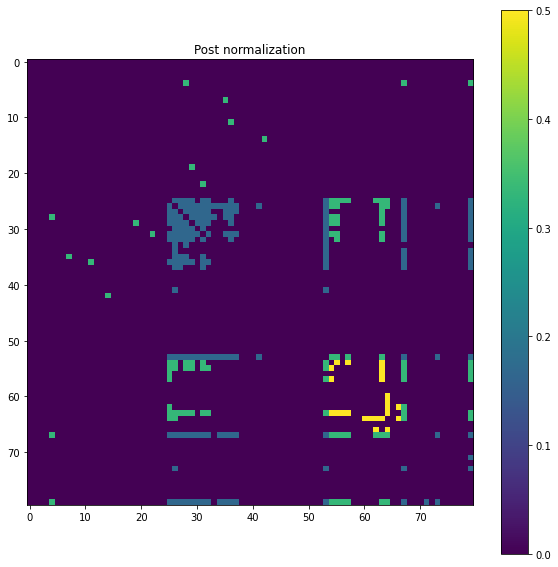

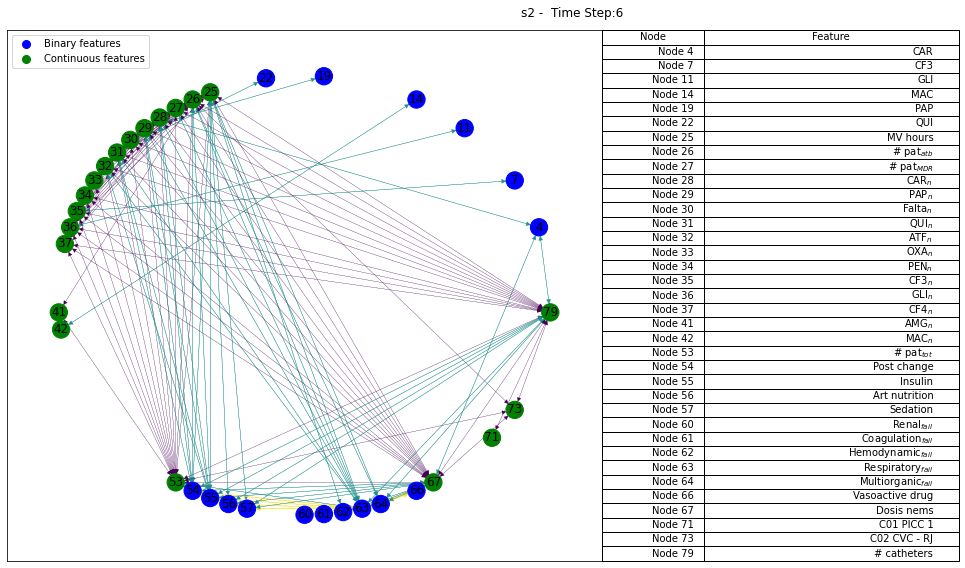

# of edges: 3160 - # of features: 80 - # of max edges: 384


<Figure size 432x288 with 0 Axes>

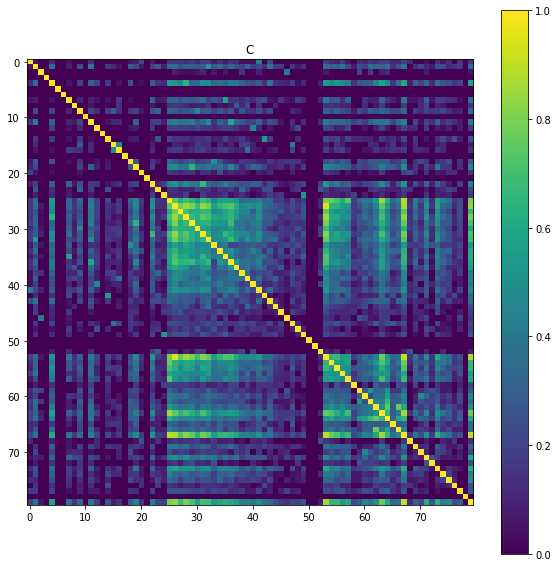

Shape A: (80, 80)
Shape A (1's except diagonal to 0): (80, 80)
1. Create a graph based on previous matrix (1's matrix)
(80, 80)
2. Get the incidence matrix of the previous graph
	shape B01: (3160, 80)
3. Compute C0 as incidence matrix T by covariance matrix by incidence matrix.
C0 shape: (3160, 3160)
4. Obtain the diagonal from the previous calculation
5. Sort the diagonal from smallest to largest, and select the smallest max_E's
6. Obtain a vector of 0's and 1's
7. Get B1_hat as B01 * diag(vec)
8. Obtain A as D - L


<Figure size 432x288 with 0 Axes>

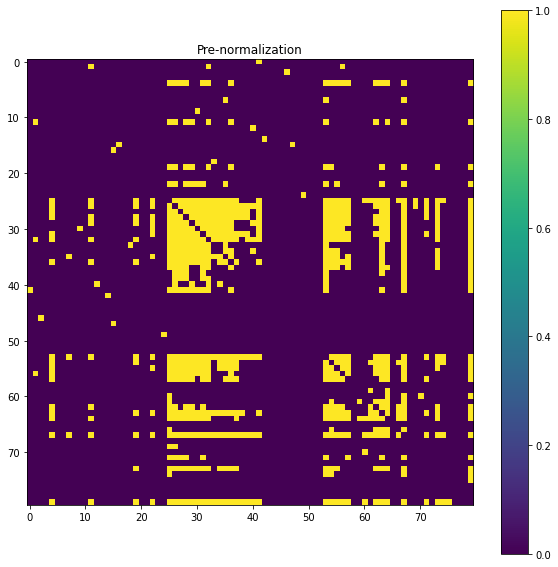

<Figure size 432x288 with 0 Axes>

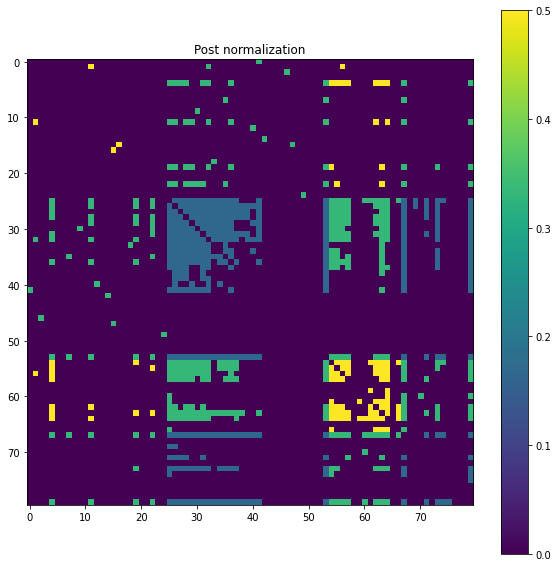

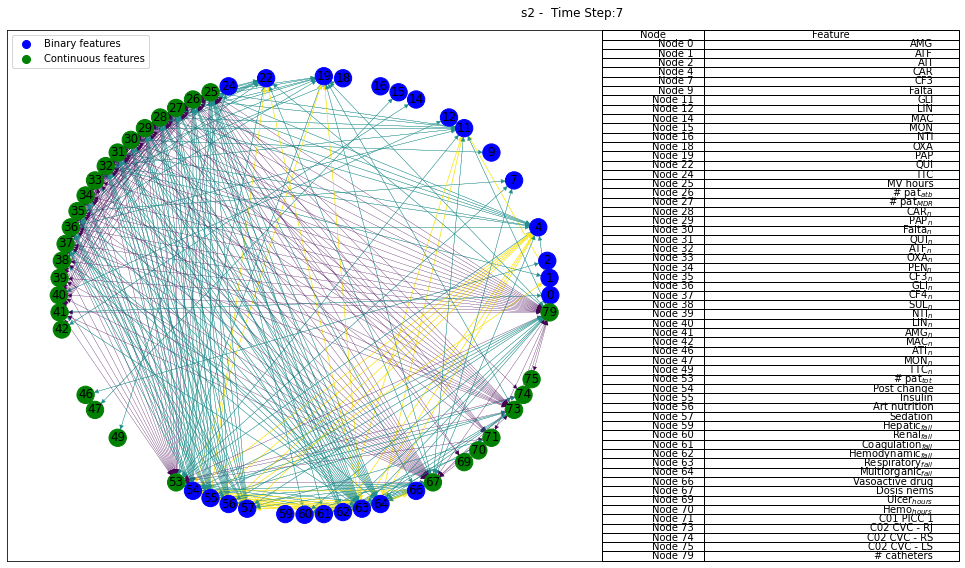

# of edges: 3160 - # of features: 80 - # of max edges: 388


<Figure size 432x288 with 0 Axes>

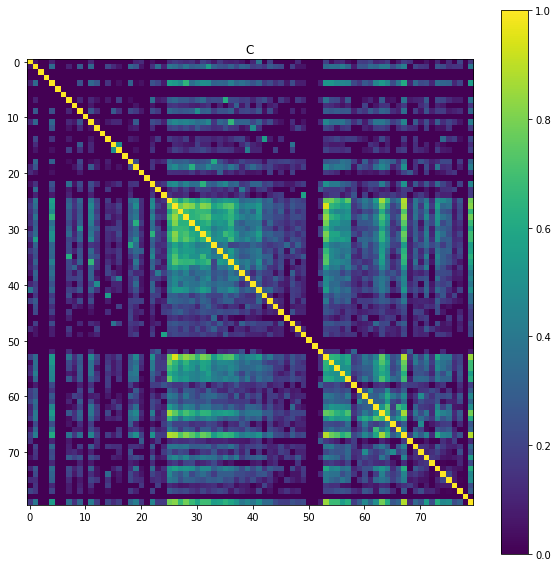

Shape A: (80, 80)
Shape A (1's except diagonal to 0): (80, 80)
1. Create a graph based on previous matrix (1's matrix)
(80, 80)
2. Get the incidence matrix of the previous graph
	shape B01: (3160, 80)
3. Compute C0 as incidence matrix T by covariance matrix by incidence matrix.
C0 shape: (3160, 3160)
4. Obtain the diagonal from the previous calculation
5. Sort the diagonal from smallest to largest, and select the smallest max_E's
6. Obtain a vector of 0's and 1's
7. Get B1_hat as B01 * diag(vec)
8. Obtain A as D - L


<Figure size 432x288 with 0 Axes>

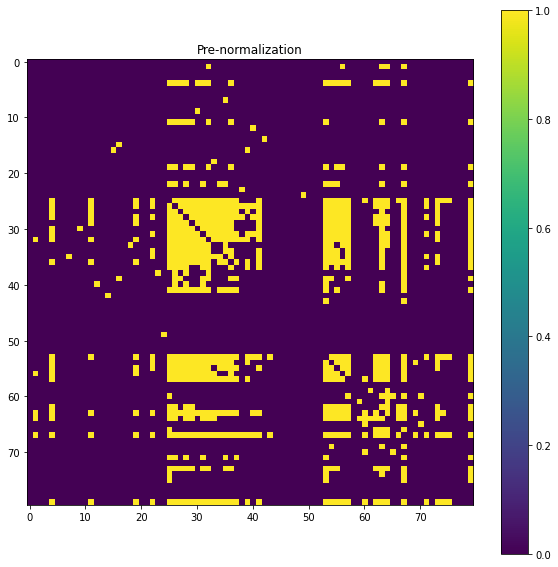

<Figure size 432x288 with 0 Axes>

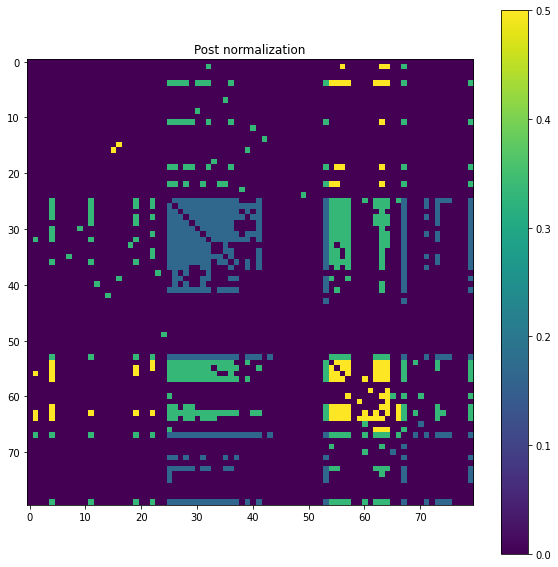

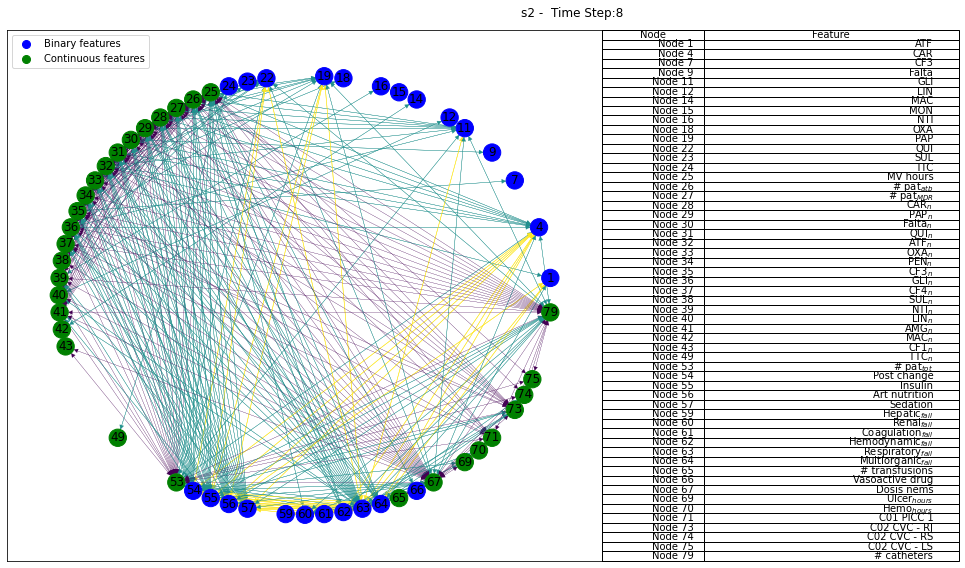

# of edges: 3160 - # of features: 80 - # of max edges: 360


<Figure size 432x288 with 0 Axes>

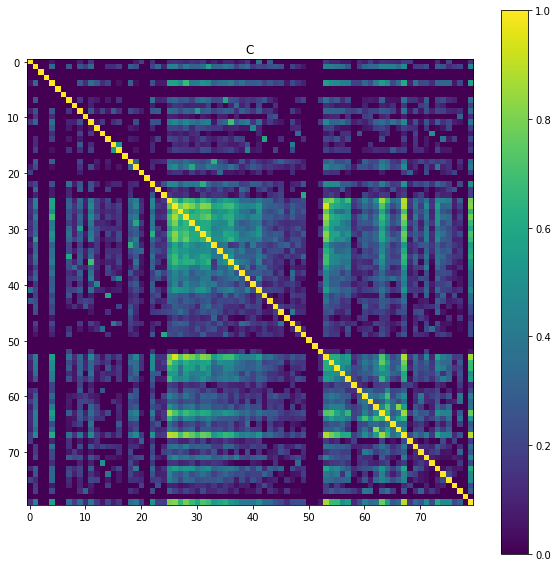

Shape A: (80, 80)
Shape A (1's except diagonal to 0): (80, 80)
1. Create a graph based on previous matrix (1's matrix)
(80, 80)
2. Get the incidence matrix of the previous graph
	shape B01: (3160, 80)
3. Compute C0 as incidence matrix T by covariance matrix by incidence matrix.
C0 shape: (3160, 3160)
4. Obtain the diagonal from the previous calculation
5. Sort the diagonal from smallest to largest, and select the smallest max_E's
6. Obtain a vector of 0's and 1's
7. Get B1_hat as B01 * diag(vec)
8. Obtain A as D - L


<Figure size 432x288 with 0 Axes>

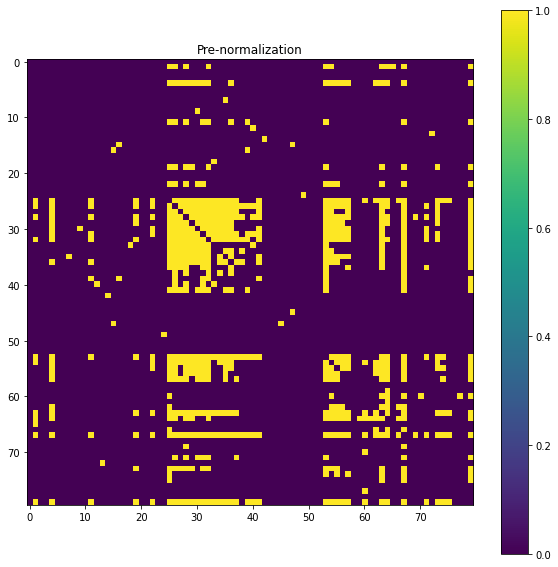

<Figure size 432x288 with 0 Axes>

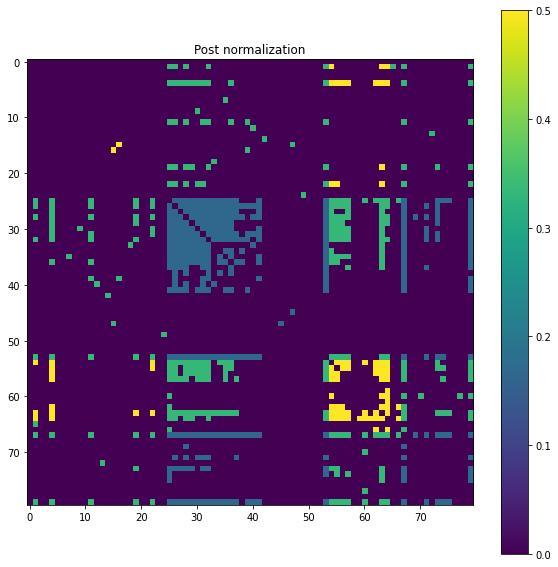

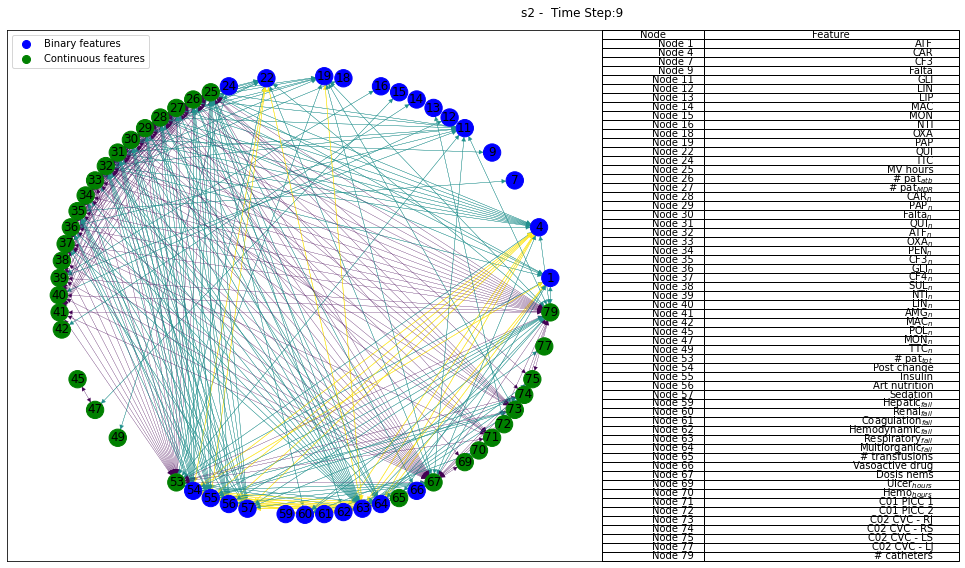

# of edges: 3160 - # of features: 80 - # of max edges: 482


<Figure size 432x288 with 0 Axes>

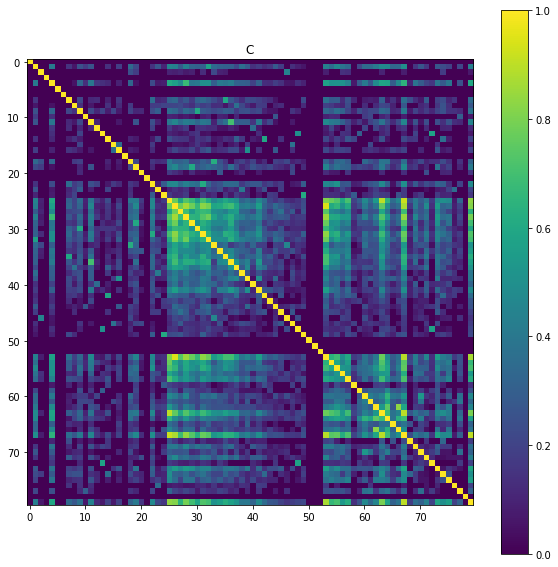

Shape A: (80, 80)
Shape A (1's except diagonal to 0): (80, 80)
1. Create a graph based on previous matrix (1's matrix)
(80, 80)
2. Get the incidence matrix of the previous graph
	shape B01: (3160, 80)
3. Compute C0 as incidence matrix T by covariance matrix by incidence matrix.
C0 shape: (3160, 3160)
4. Obtain the diagonal from the previous calculation
5. Sort the diagonal from smallest to largest, and select the smallest max_E's
6. Obtain a vector of 0's and 1's
7. Get B1_hat as B01 * diag(vec)
8. Obtain A as D - L


<Figure size 432x288 with 0 Axes>

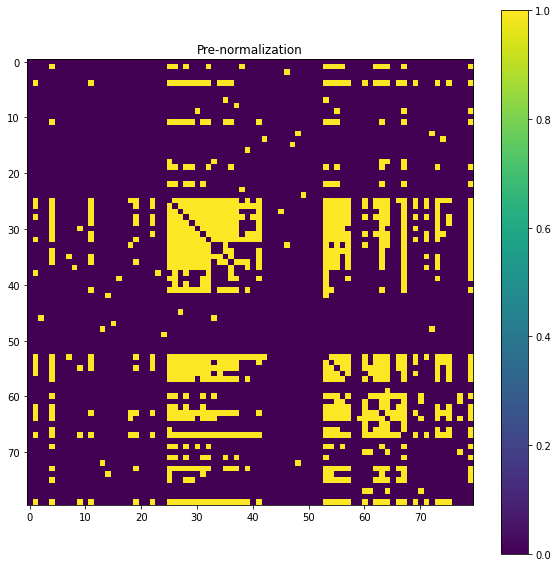

<Figure size 432x288 with 0 Axes>

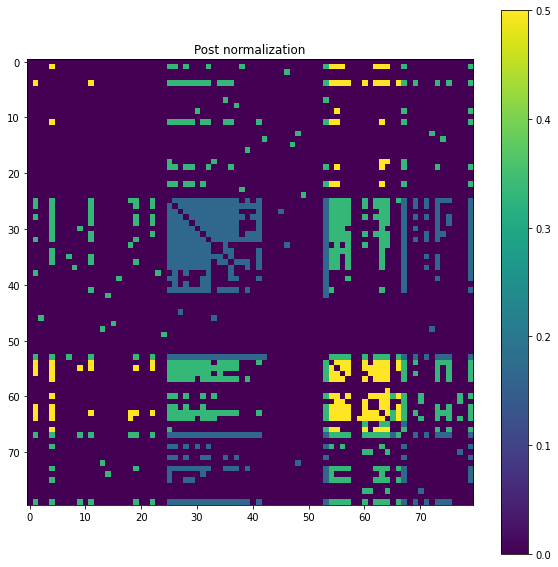

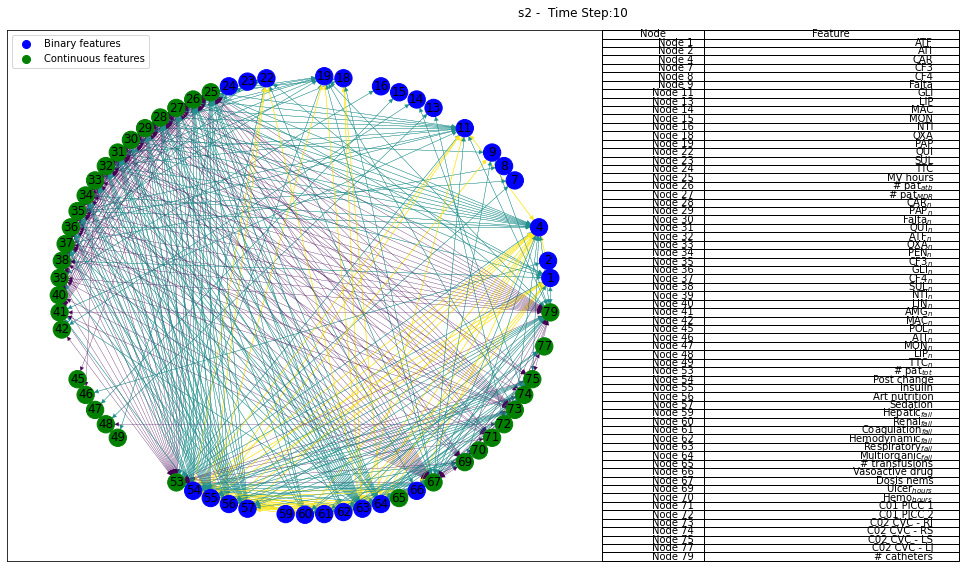

# of edges: 3160 - # of features: 80 - # of max edges: 514


<Figure size 432x288 with 0 Axes>

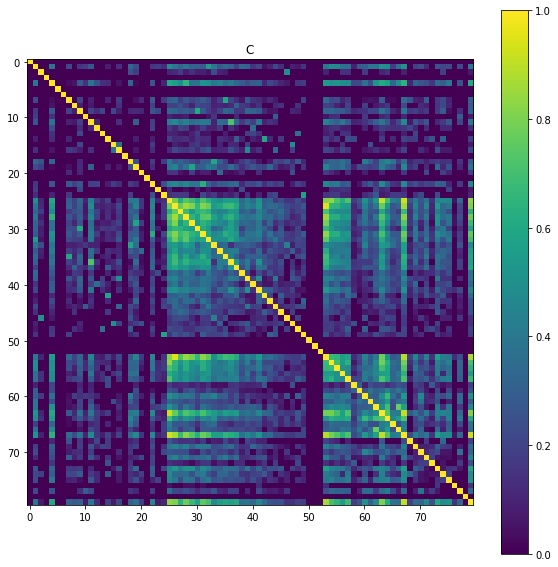

Shape A: (80, 80)
Shape A (1's except diagonal to 0): (80, 80)
1. Create a graph based on previous matrix (1's matrix)
(80, 80)
2. Get the incidence matrix of the previous graph
	shape B01: (3160, 80)
3. Compute C0 as incidence matrix T by covariance matrix by incidence matrix.
C0 shape: (3160, 3160)
4. Obtain the diagonal from the previous calculation
5. Sort the diagonal from smallest to largest, and select the smallest max_E's
6. Obtain a vector of 0's and 1's
7. Get B1_hat as B01 * diag(vec)
8. Obtain A as D - L


<Figure size 432x288 with 0 Axes>

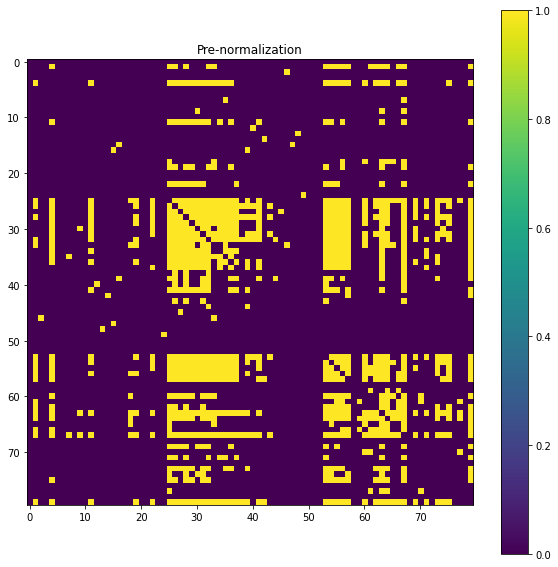

<Figure size 432x288 with 0 Axes>

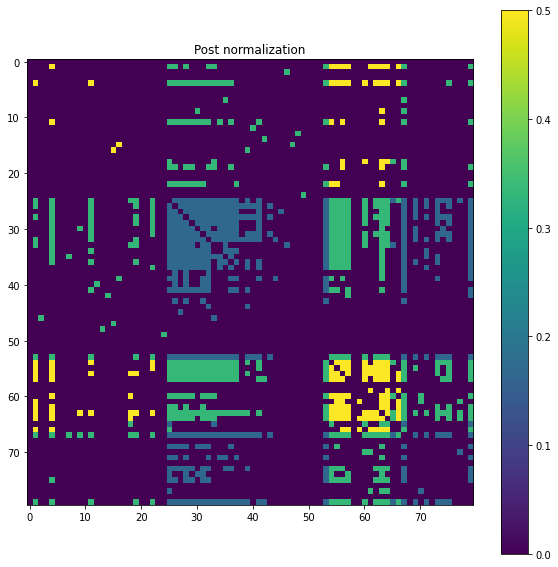

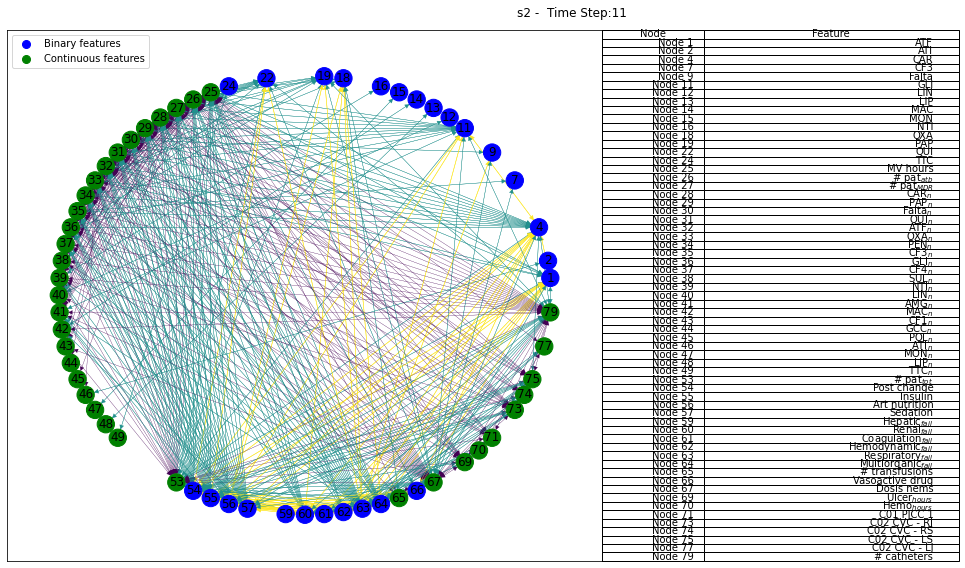

# of edges: 3160 - # of features: 80 - # of max edges: 502


<Figure size 432x288 with 0 Axes>

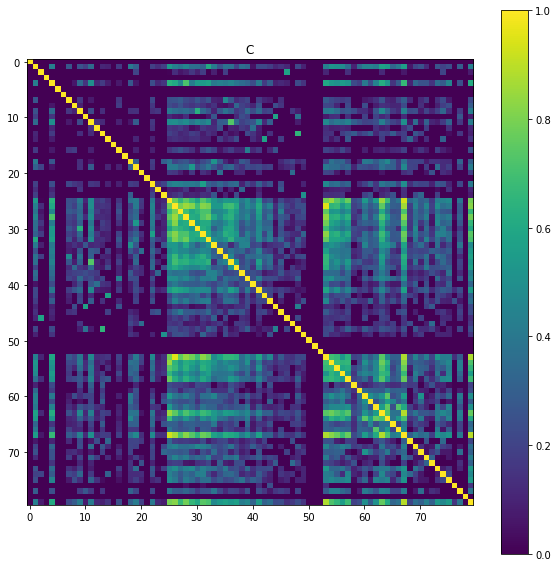

Shape A: (80, 80)
Shape A (1's except diagonal to 0): (80, 80)
1. Create a graph based on previous matrix (1's matrix)
(80, 80)
2. Get the incidence matrix of the previous graph
	shape B01: (3160, 80)
3. Compute C0 as incidence matrix T by covariance matrix by incidence matrix.
C0 shape: (3160, 3160)
4. Obtain the diagonal from the previous calculation
5. Sort the diagonal from smallest to largest, and select the smallest max_E's
6. Obtain a vector of 0's and 1's
7. Get B1_hat as B01 * diag(vec)
8. Obtain A as D - L


<Figure size 432x288 with 0 Axes>

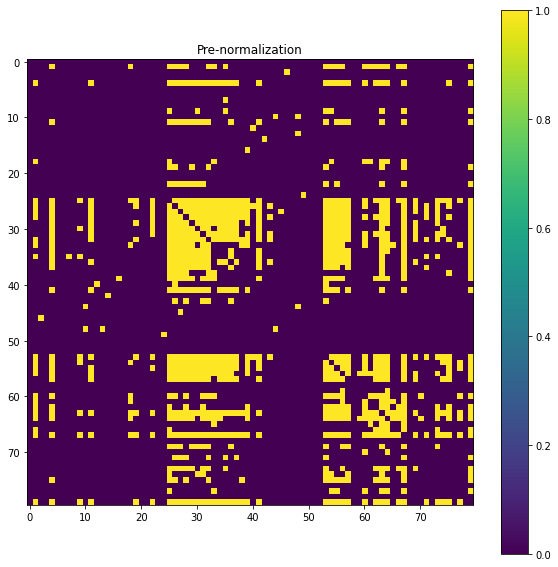

<Figure size 432x288 with 0 Axes>

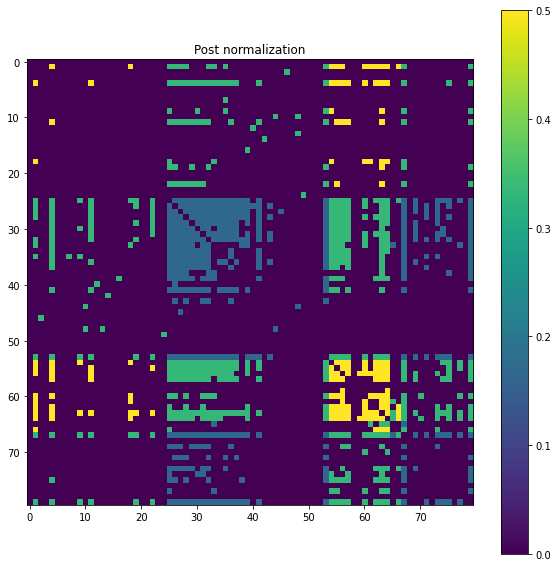

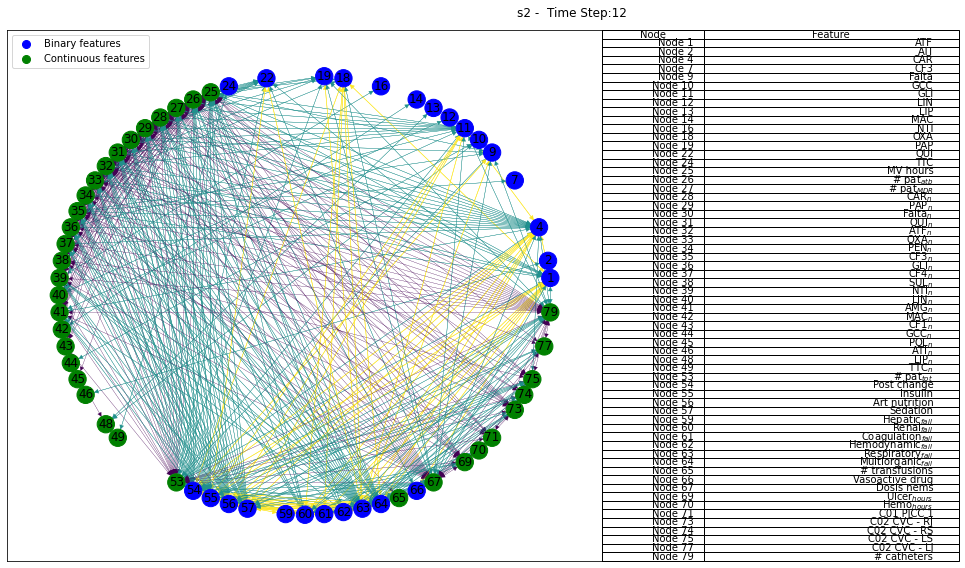

# of edges: 3160 - # of features: 80 - # of max edges: 432


<Figure size 432x288 with 0 Axes>

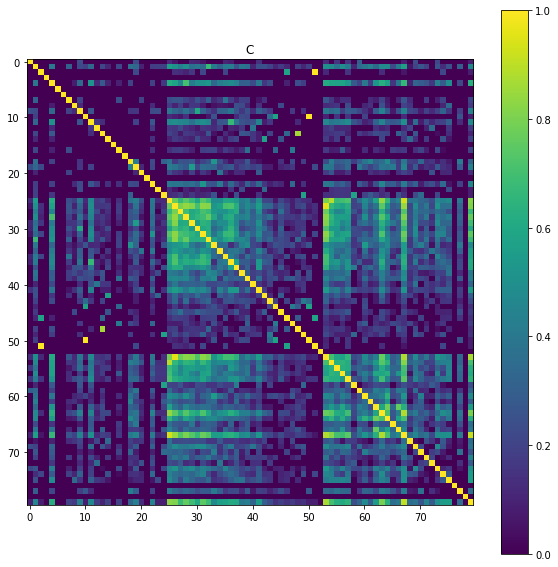

Shape A: (80, 80)
Shape A (1's except diagonal to 0): (80, 80)
1. Create a graph based on previous matrix (1's matrix)
(80, 80)
2. Get the incidence matrix of the previous graph
	shape B01: (3160, 80)
3. Compute C0 as incidence matrix T by covariance matrix by incidence matrix.
C0 shape: (3160, 3160)
4. Obtain the diagonal from the previous calculation
5. Sort the diagonal from smallest to largest, and select the smallest max_E's
6. Obtain a vector of 0's and 1's
7. Get B1_hat as B01 * diag(vec)
8. Obtain A as D - L


<Figure size 432x288 with 0 Axes>

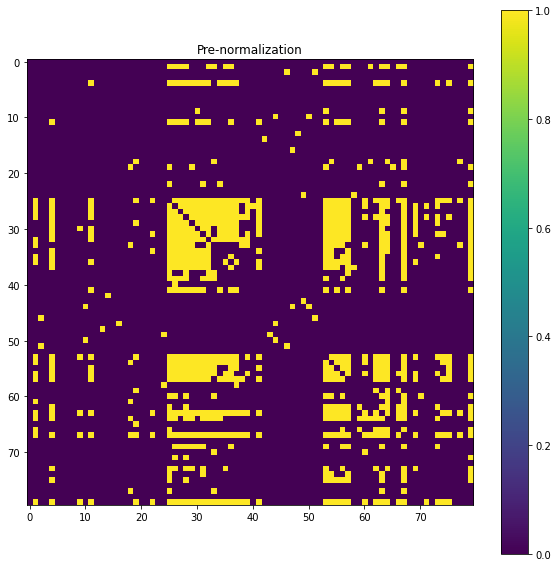

<Figure size 432x288 with 0 Axes>

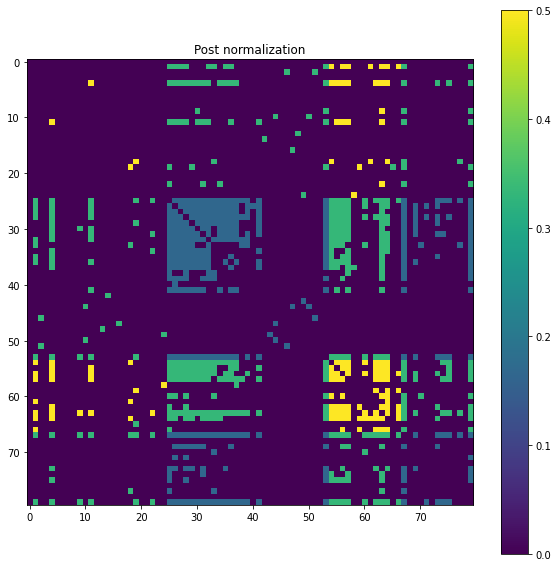

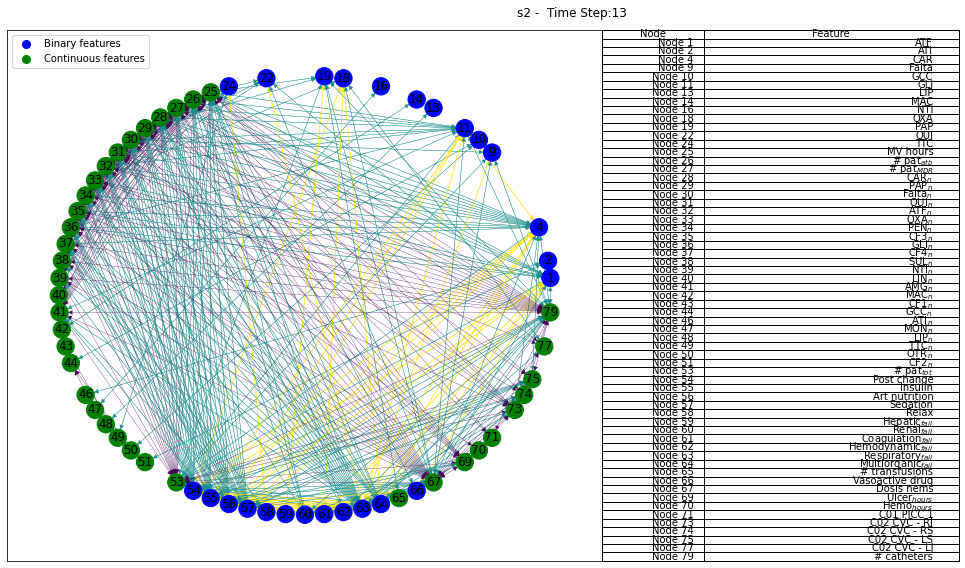

# of edges: 3160 - # of features: 80 - # of max edges: 283


<Figure size 432x288 with 0 Axes>

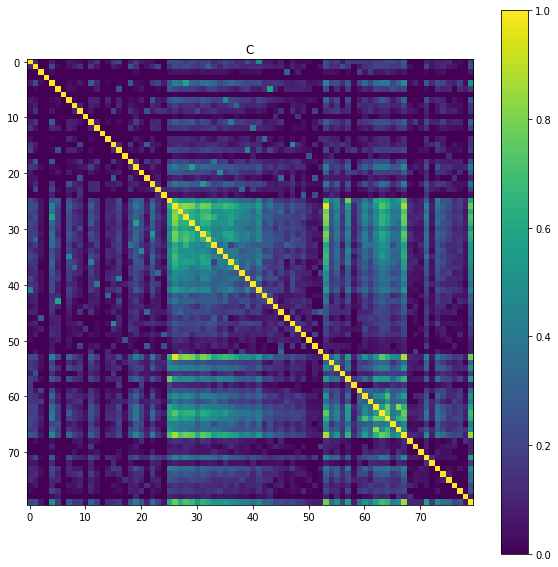

Shape A: (80, 80)
Shape A (1's except diagonal to 0): (80, 80)
1. Create a graph based on previous matrix (1's matrix)
(80, 80)
2. Get the incidence matrix of the previous graph
	shape B01: (3160, 80)
3. Compute C0 as incidence matrix T by covariance matrix by incidence matrix.
C0 shape: (3160, 3160)
4. Obtain the diagonal from the previous calculation
5. Sort the diagonal from smallest to largest, and select the smallest max_E's
6. Obtain a vector of 0's and 1's
7. Get B1_hat as B01 * diag(vec)
8. Obtain A as D - L


<Figure size 432x288 with 0 Axes>

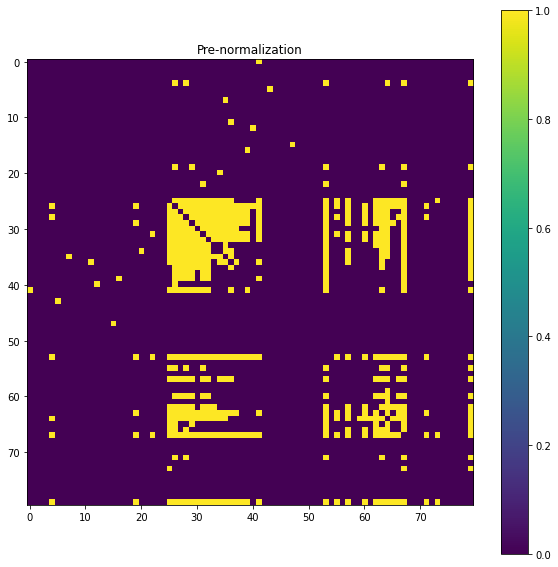

<Figure size 432x288 with 0 Axes>

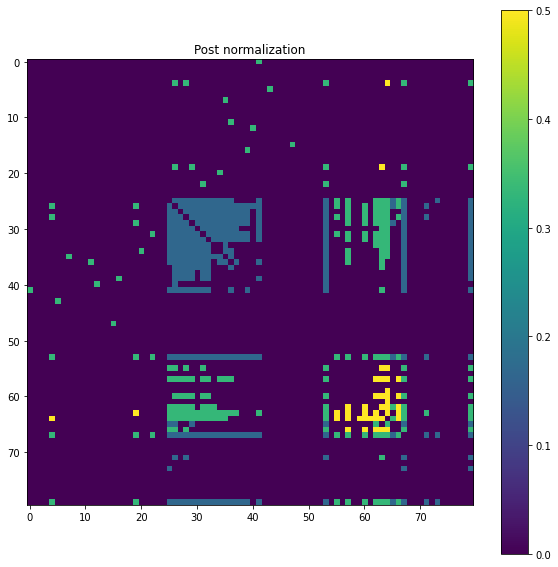

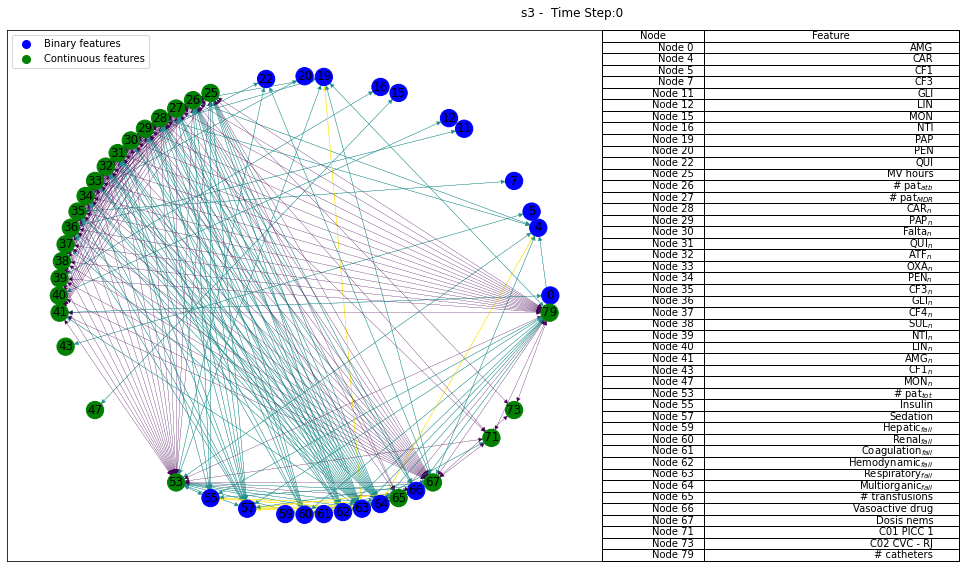

# of edges: 3160 - # of features: 80 - # of max edges: 98


<Figure size 432x288 with 0 Axes>

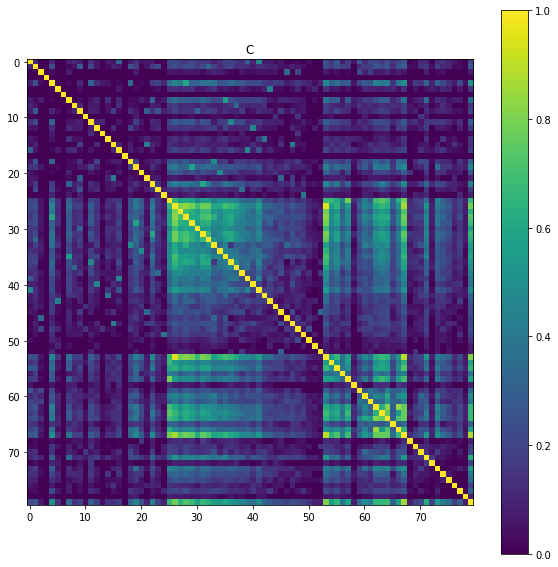

Shape A: (80, 80)
Shape A (1's except diagonal to 0): (80, 80)
1. Create a graph based on previous matrix (1's matrix)
(80, 80)
2. Get the incidence matrix of the previous graph
	shape B01: (3160, 80)
3. Compute C0 as incidence matrix T by covariance matrix by incidence matrix.
C0 shape: (3160, 3160)
4. Obtain the diagonal from the previous calculation
5. Sort the diagonal from smallest to largest, and select the smallest max_E's
6. Obtain a vector of 0's and 1's
7. Get B1_hat as B01 * diag(vec)
8. Obtain A as D - L


<Figure size 432x288 with 0 Axes>

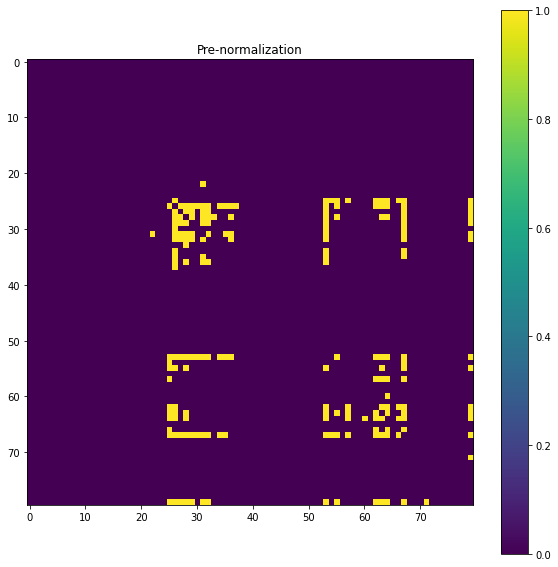

<Figure size 432x288 with 0 Axes>

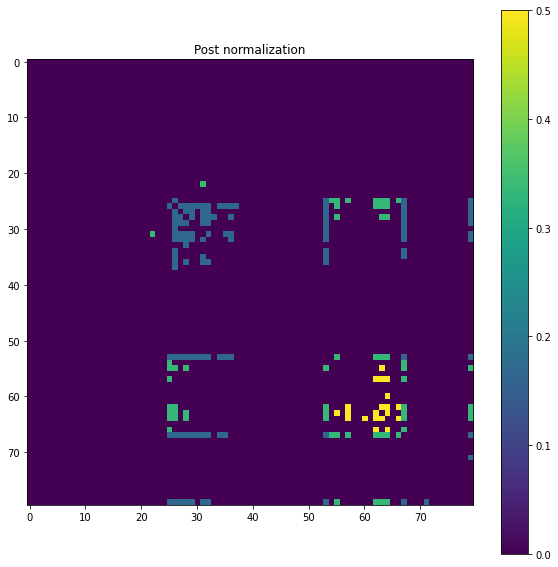

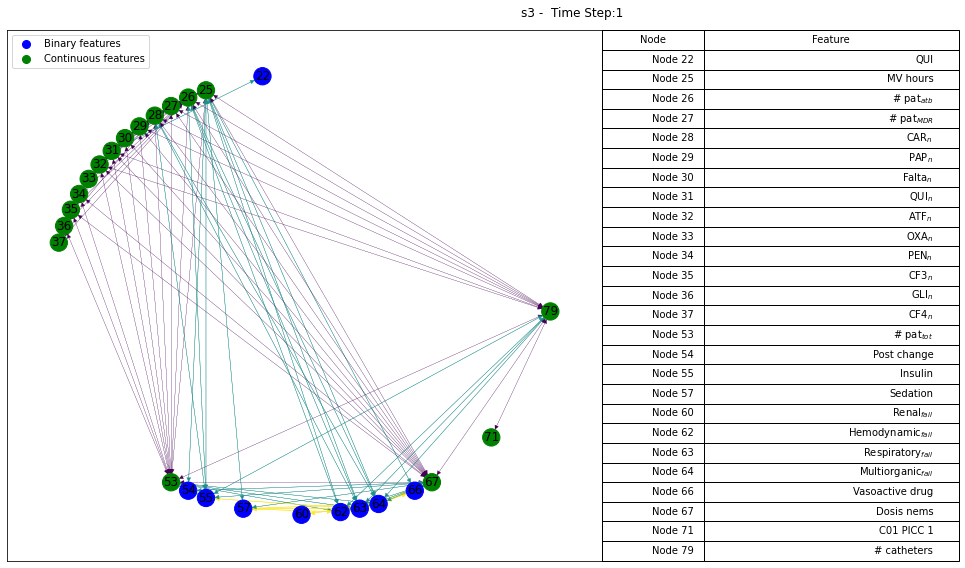

# of edges: 3160 - # of features: 80 - # of max edges: 110


<Figure size 432x288 with 0 Axes>

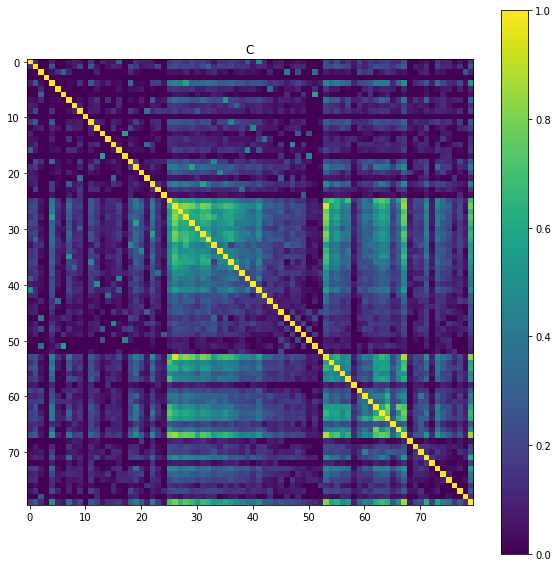

Shape A: (80, 80)
Shape A (1's except diagonal to 0): (80, 80)
1. Create a graph based on previous matrix (1's matrix)
(80, 80)
2. Get the incidence matrix of the previous graph
	shape B01: (3160, 80)
3. Compute C0 as incidence matrix T by covariance matrix by incidence matrix.
C0 shape: (3160, 3160)
4. Obtain the diagonal from the previous calculation
5. Sort the diagonal from smallest to largest, and select the smallest max_E's
6. Obtain a vector of 0's and 1's
7. Get B1_hat as B01 * diag(vec)
8. Obtain A as D - L


<Figure size 432x288 with 0 Axes>

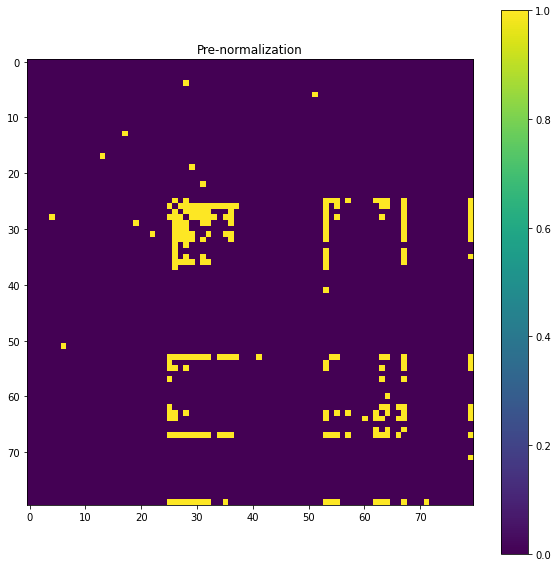

<Figure size 432x288 with 0 Axes>

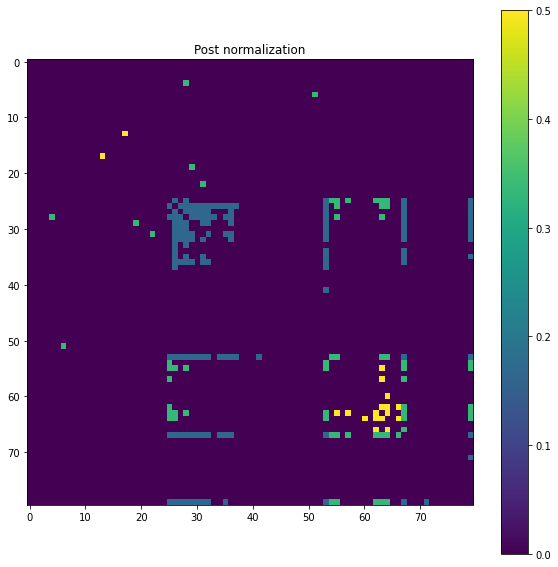

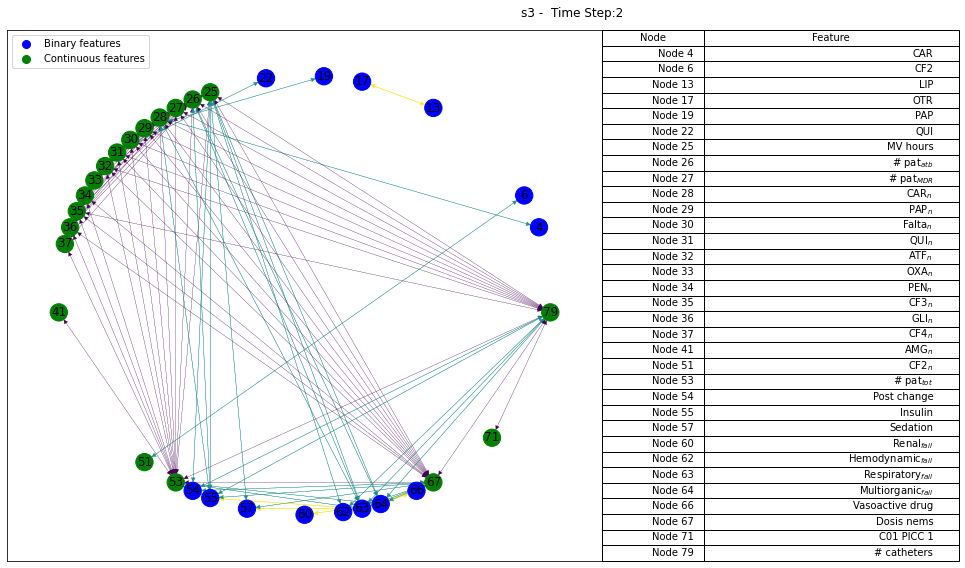

# of edges: 3160 - # of features: 80 - # of max edges: 176


<Figure size 432x288 with 0 Axes>

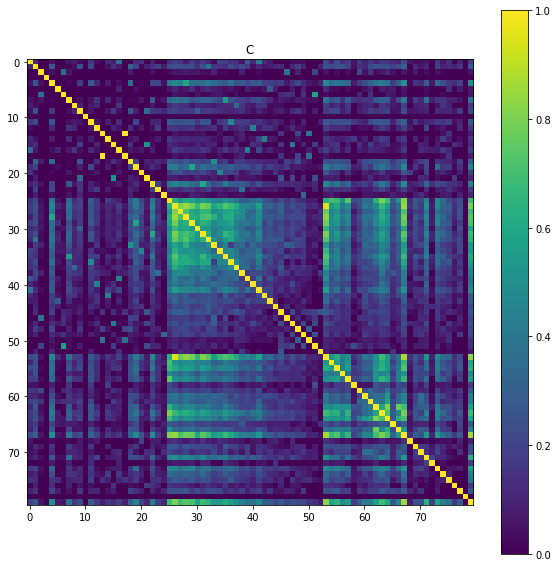

Shape A: (80, 80)
Shape A (1's except diagonal to 0): (80, 80)
1. Create a graph based on previous matrix (1's matrix)
(80, 80)
2. Get the incidence matrix of the previous graph
	shape B01: (3160, 80)
3. Compute C0 as incidence matrix T by covariance matrix by incidence matrix.
C0 shape: (3160, 3160)
4. Obtain the diagonal from the previous calculation
5. Sort the diagonal from smallest to largest, and select the smallest max_E's
6. Obtain a vector of 0's and 1's
7. Get B1_hat as B01 * diag(vec)
8. Obtain A as D - L


<Figure size 432x288 with 0 Axes>

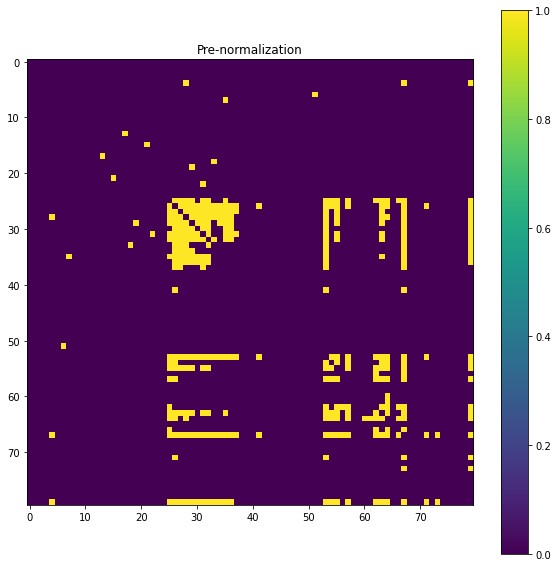

<Figure size 432x288 with 0 Axes>

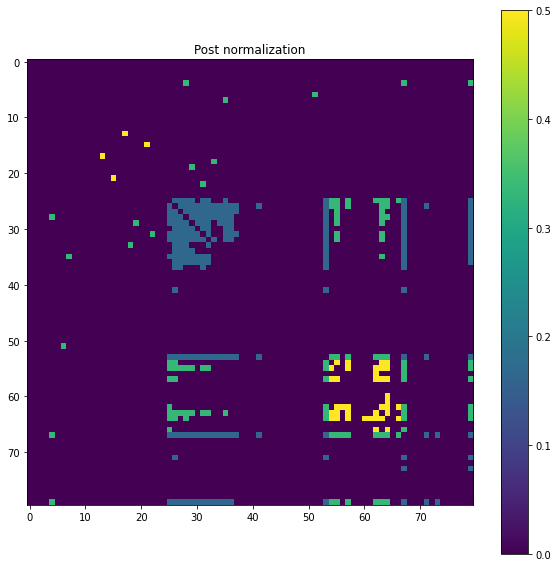

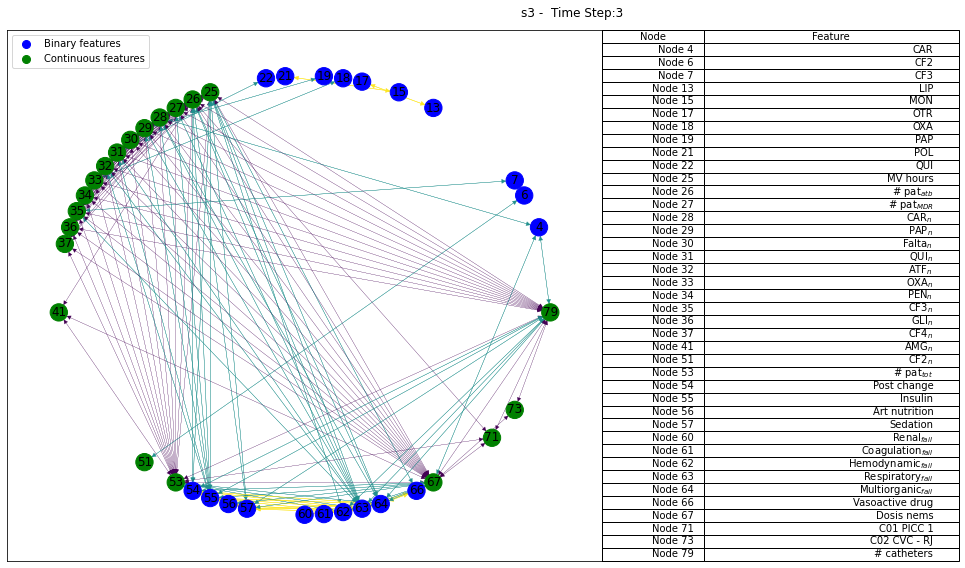

# of edges: 3160 - # of features: 80 - # of max edges: 200


<Figure size 432x288 with 0 Axes>

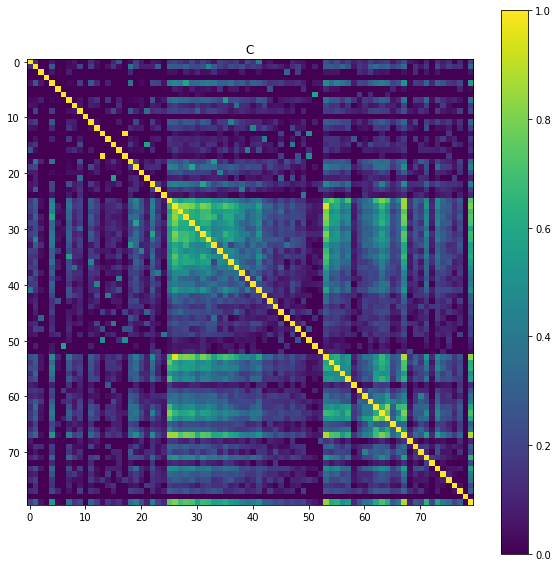

Shape A: (80, 80)
Shape A (1's except diagonal to 0): (80, 80)
1. Create a graph based on previous matrix (1's matrix)
(80, 80)
2. Get the incidence matrix of the previous graph
	shape B01: (3160, 80)
3. Compute C0 as incidence matrix T by covariance matrix by incidence matrix.
C0 shape: (3160, 3160)
4. Obtain the diagonal from the previous calculation
5. Sort the diagonal from smallest to largest, and select the smallest max_E's
6. Obtain a vector of 0's and 1's
7. Get B1_hat as B01 * diag(vec)
8. Obtain A as D - L


<Figure size 432x288 with 0 Axes>

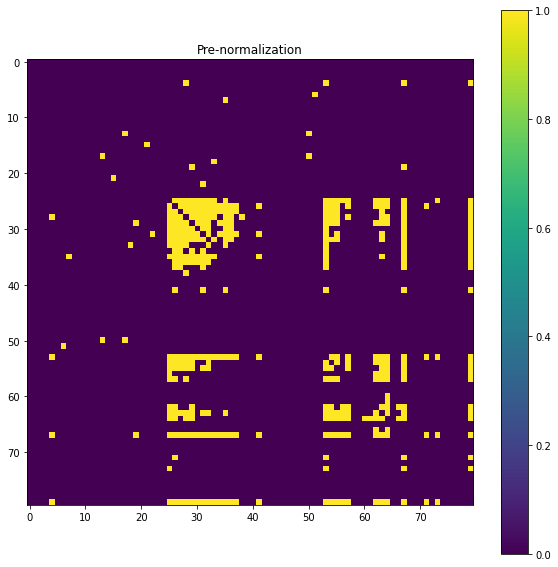

<Figure size 432x288 with 0 Axes>

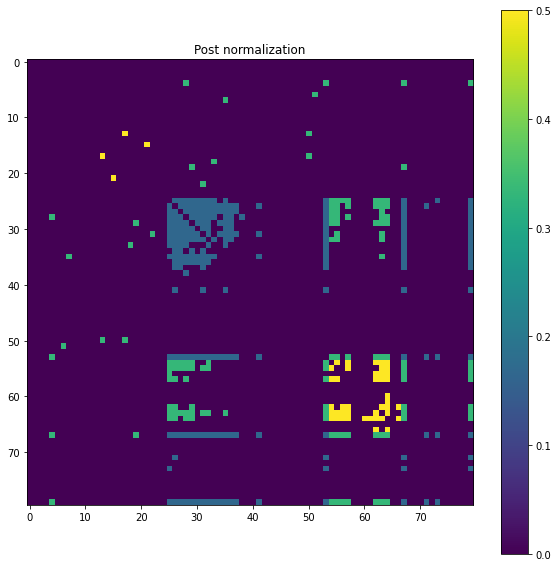

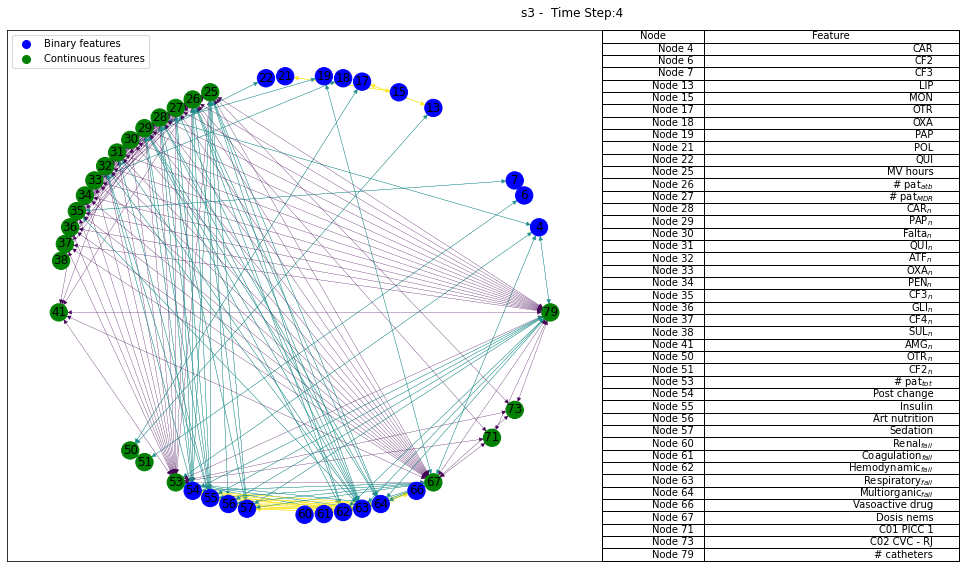

# of edges: 3160 - # of features: 80 - # of max edges: 204


<Figure size 432x288 with 0 Axes>

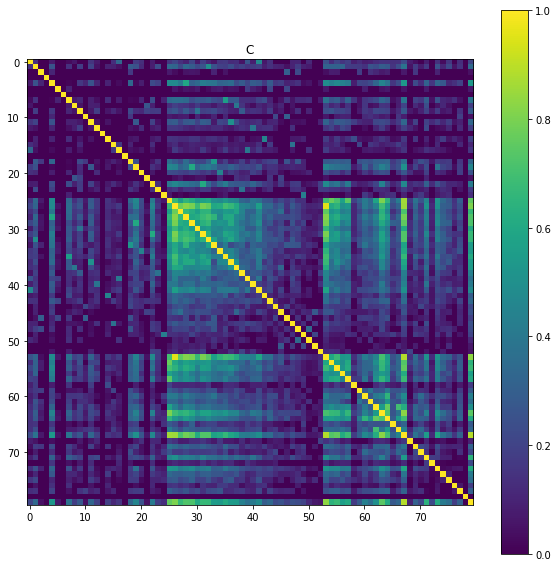

Shape A: (80, 80)
Shape A (1's except diagonal to 0): (80, 80)
1. Create a graph based on previous matrix (1's matrix)
(80, 80)
2. Get the incidence matrix of the previous graph
	shape B01: (3160, 80)
3. Compute C0 as incidence matrix T by covariance matrix by incidence matrix.
C0 shape: (3160, 3160)
4. Obtain the diagonal from the previous calculation
5. Sort the diagonal from smallest to largest, and select the smallest max_E's
6. Obtain a vector of 0's and 1's
7. Get B1_hat as B01 * diag(vec)
8. Obtain A as D - L


<Figure size 432x288 with 0 Axes>

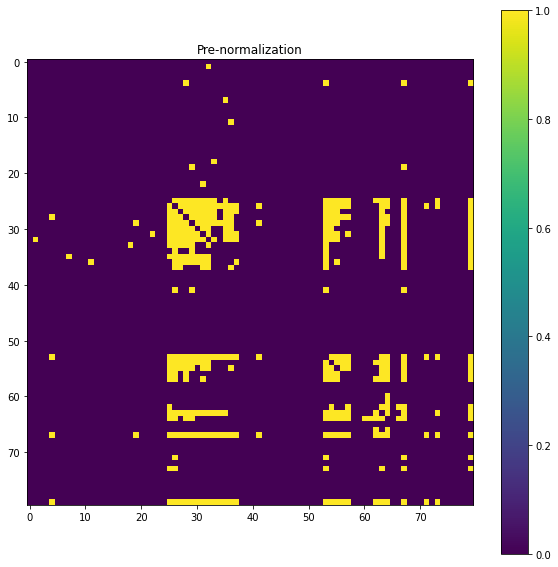

<Figure size 432x288 with 0 Axes>

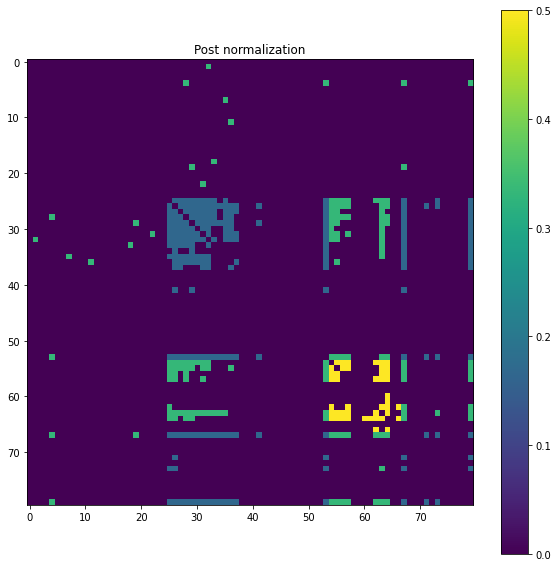

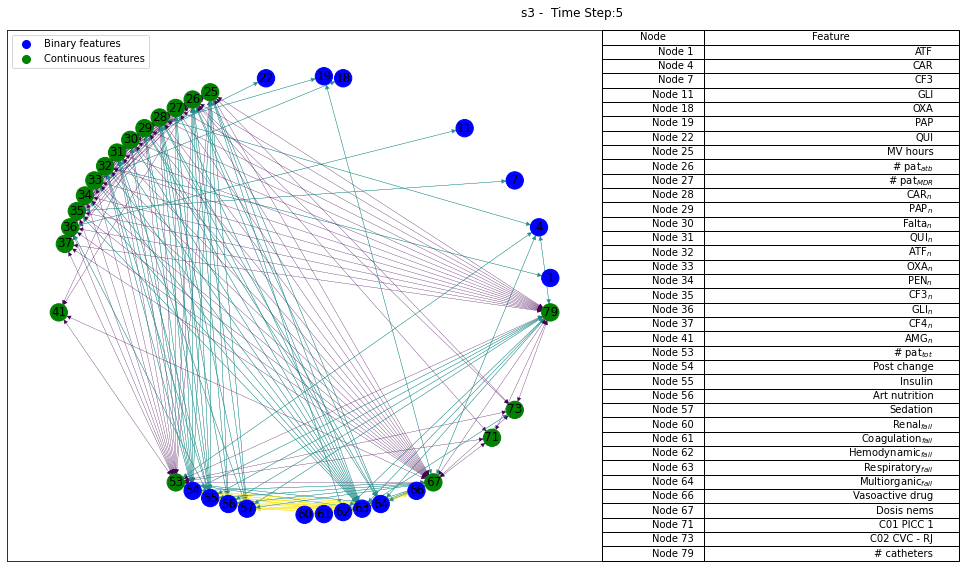

# of edges: 3160 - # of features: 80 - # of max edges: 254


<Figure size 432x288 with 0 Axes>

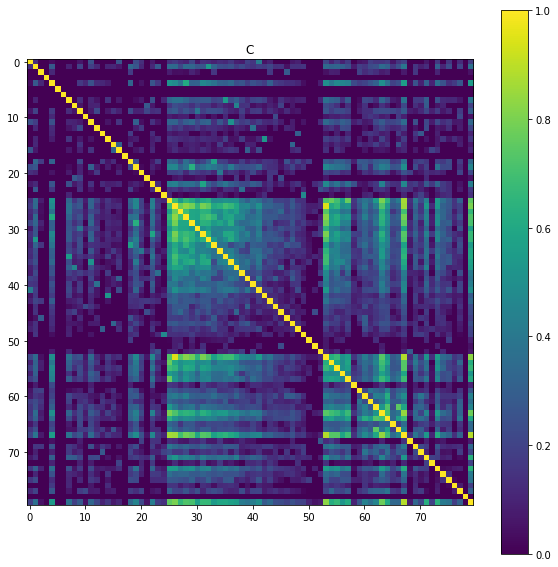

Shape A: (80, 80)
Shape A (1's except diagonal to 0): (80, 80)
1. Create a graph based on previous matrix (1's matrix)
(80, 80)
2. Get the incidence matrix of the previous graph
	shape B01: (3160, 80)
3. Compute C0 as incidence matrix T by covariance matrix by incidence matrix.
C0 shape: (3160, 3160)
4. Obtain the diagonal from the previous calculation
5. Sort the diagonal from smallest to largest, and select the smallest max_E's
6. Obtain a vector of 0's and 1's
7. Get B1_hat as B01 * diag(vec)
8. Obtain A as D - L


<Figure size 432x288 with 0 Axes>

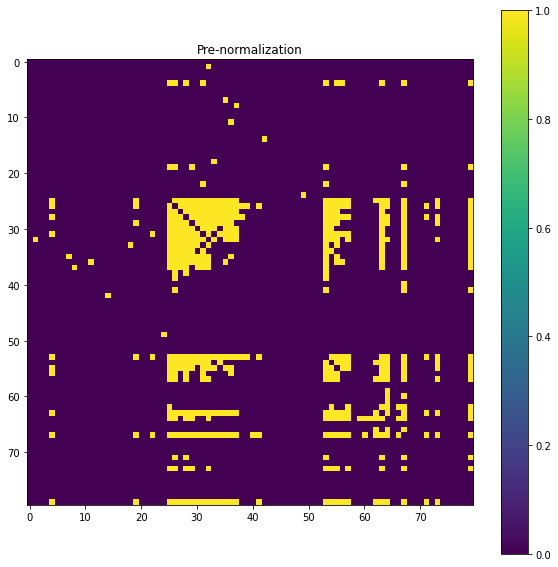

<Figure size 432x288 with 0 Axes>

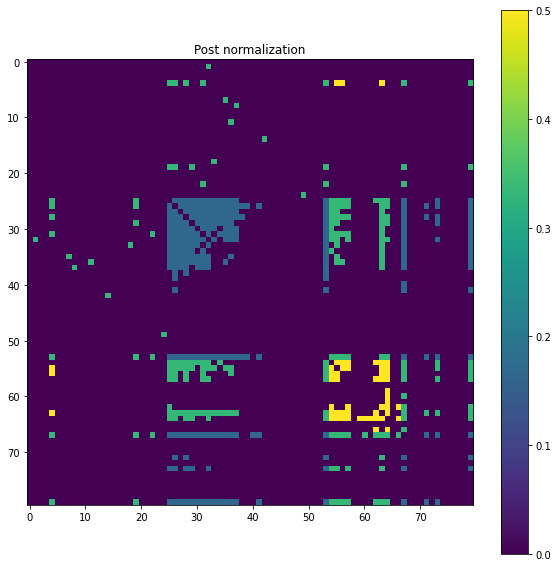

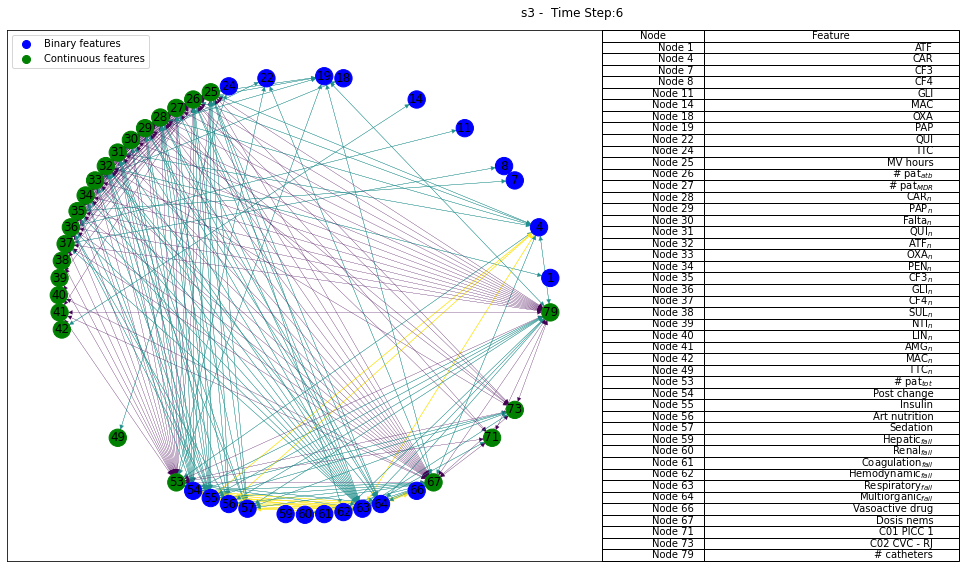

# of edges: 3160 - # of features: 80 - # of max edges: 204


<Figure size 432x288 with 0 Axes>

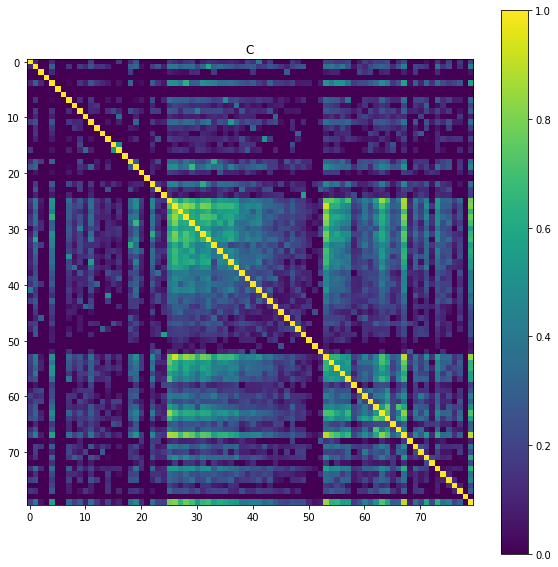

Shape A: (80, 80)
Shape A (1's except diagonal to 0): (80, 80)
1. Create a graph based on previous matrix (1's matrix)
(80, 80)
2. Get the incidence matrix of the previous graph
	shape B01: (3160, 80)
3. Compute C0 as incidence matrix T by covariance matrix by incidence matrix.
C0 shape: (3160, 3160)
4. Obtain the diagonal from the previous calculation
5. Sort the diagonal from smallest to largest, and select the smallest max_E's
6. Obtain a vector of 0's and 1's
7. Get B1_hat as B01 * diag(vec)
8. Obtain A as D - L


<Figure size 432x288 with 0 Axes>

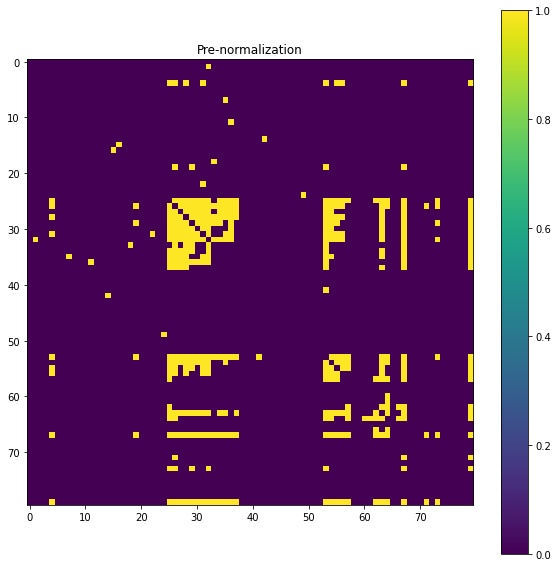

<Figure size 432x288 with 0 Axes>

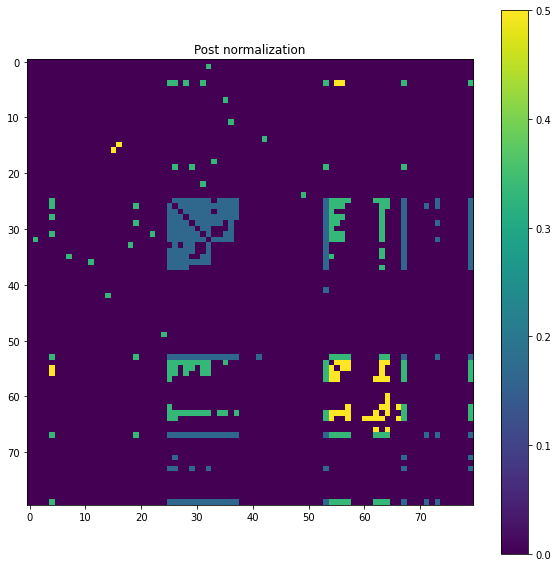

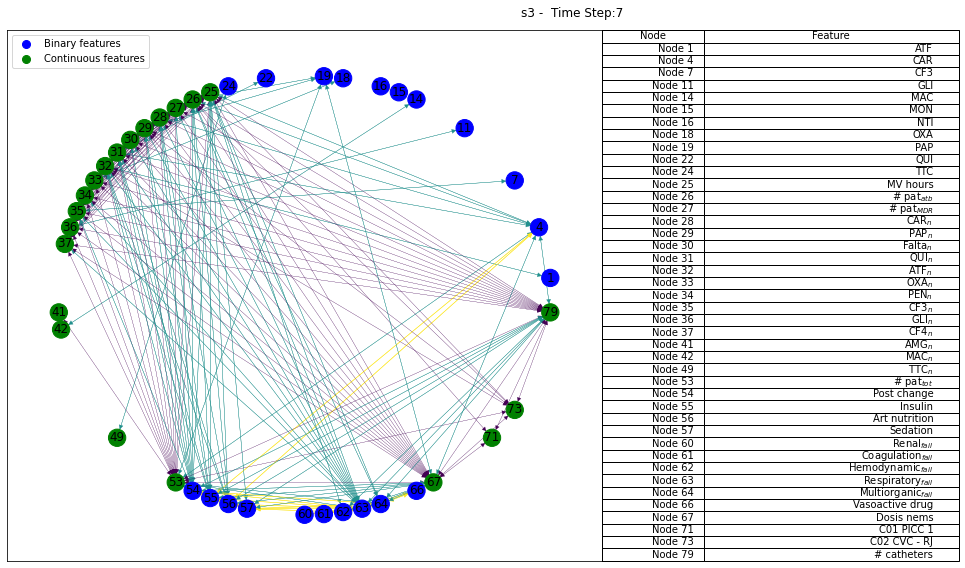

# of edges: 3160 - # of features: 80 - # of max edges: 302


<Figure size 432x288 with 0 Axes>

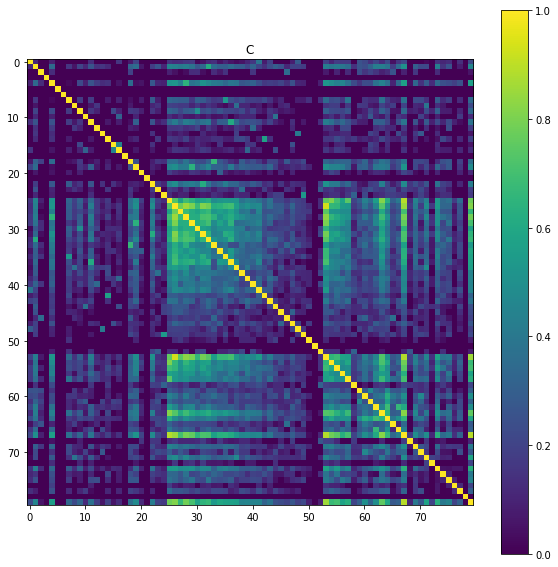

Shape A: (80, 80)
Shape A (1's except diagonal to 0): (80, 80)
1. Create a graph based on previous matrix (1's matrix)
(80, 80)
2. Get the incidence matrix of the previous graph
	shape B01: (3160, 80)
3. Compute C0 as incidence matrix T by covariance matrix by incidence matrix.
C0 shape: (3160, 3160)
4. Obtain the diagonal from the previous calculation
5. Sort the diagonal from smallest to largest, and select the smallest max_E's
6. Obtain a vector of 0's and 1's
7. Get B1_hat as B01 * diag(vec)
8. Obtain A as D - L


<Figure size 432x288 with 0 Axes>

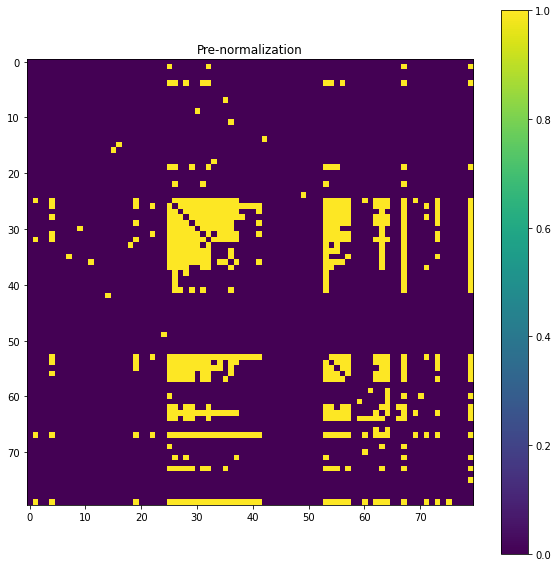

<Figure size 432x288 with 0 Axes>

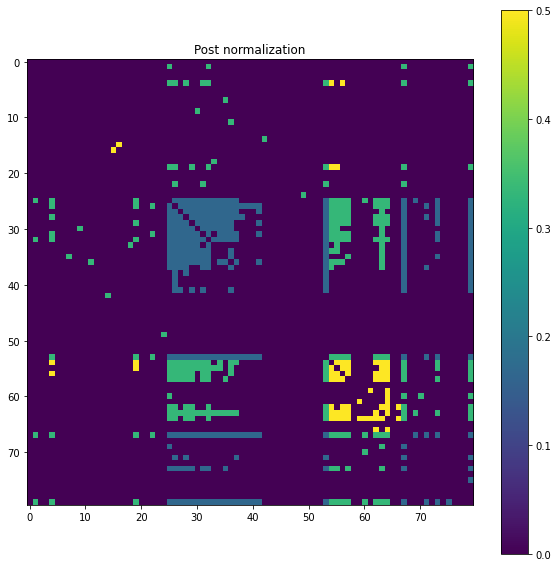

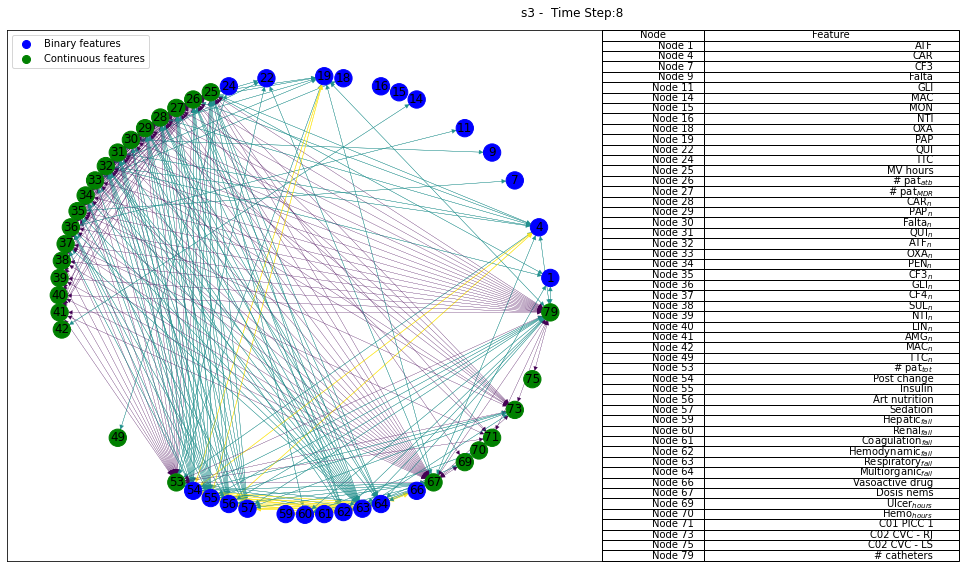

# of edges: 3160 - # of features: 80 - # of max edges: 164


<Figure size 432x288 with 0 Axes>

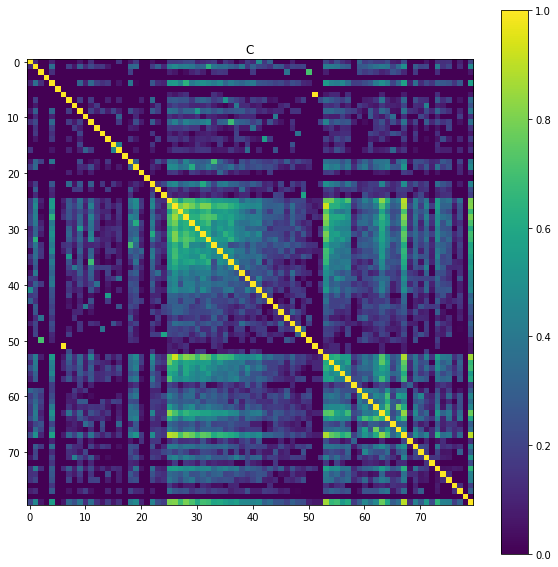

Shape A: (80, 80)
Shape A (1's except diagonal to 0): (80, 80)
1. Create a graph based on previous matrix (1's matrix)
(80, 80)
2. Get the incidence matrix of the previous graph
	shape B01: (3160, 80)
3. Compute C0 as incidence matrix T by covariance matrix by incidence matrix.
C0 shape: (3160, 3160)
4. Obtain the diagonal from the previous calculation
5. Sort the diagonal from smallest to largest, and select the smallest max_E's
6. Obtain a vector of 0's and 1's
7. Get B1_hat as B01 * diag(vec)
8. Obtain A as D - L


<Figure size 432x288 with 0 Axes>

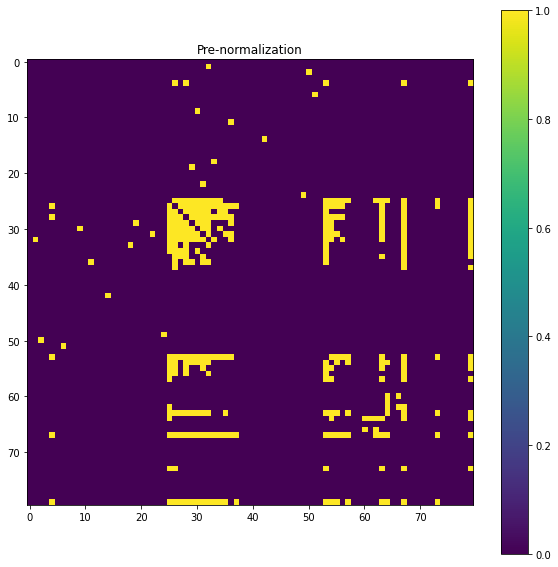

<Figure size 432x288 with 0 Axes>

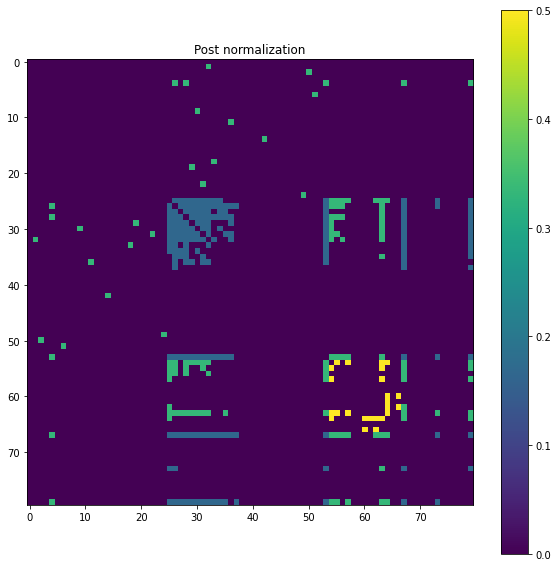

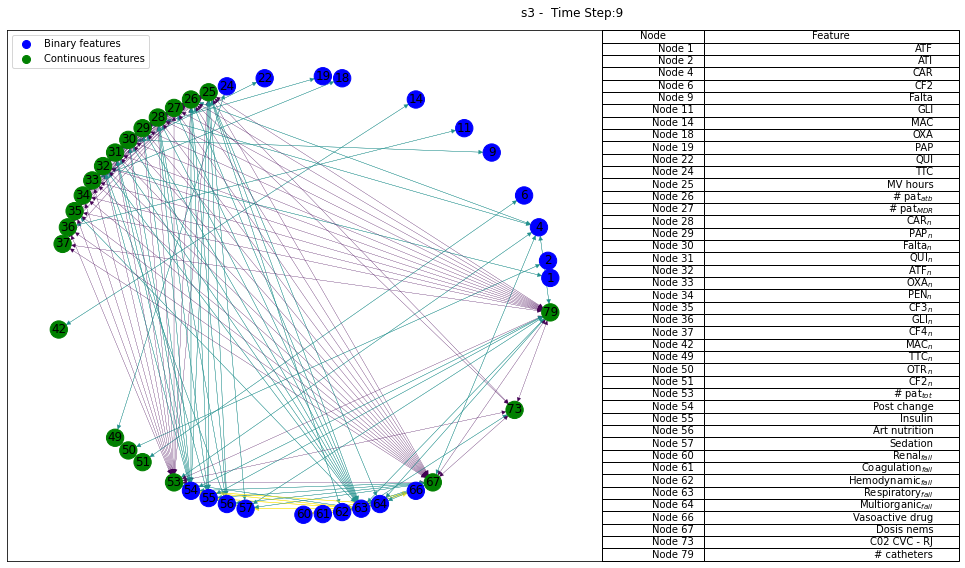

# of edges: 3160 - # of features: 80 - # of max edges: 242


<Figure size 432x288 with 0 Axes>

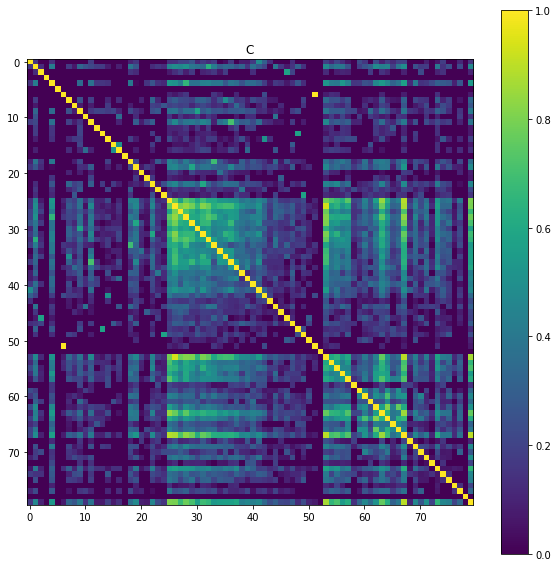

Shape A: (80, 80)
Shape A (1's except diagonal to 0): (80, 80)
1. Create a graph based on previous matrix (1's matrix)
(80, 80)
2. Get the incidence matrix of the previous graph
	shape B01: (3160, 80)
3. Compute C0 as incidence matrix T by covariance matrix by incidence matrix.
C0 shape: (3160, 3160)
4. Obtain the diagonal from the previous calculation
5. Sort the diagonal from smallest to largest, and select the smallest max_E's
6. Obtain a vector of 0's and 1's
7. Get B1_hat as B01 * diag(vec)
8. Obtain A as D - L


<Figure size 432x288 with 0 Axes>

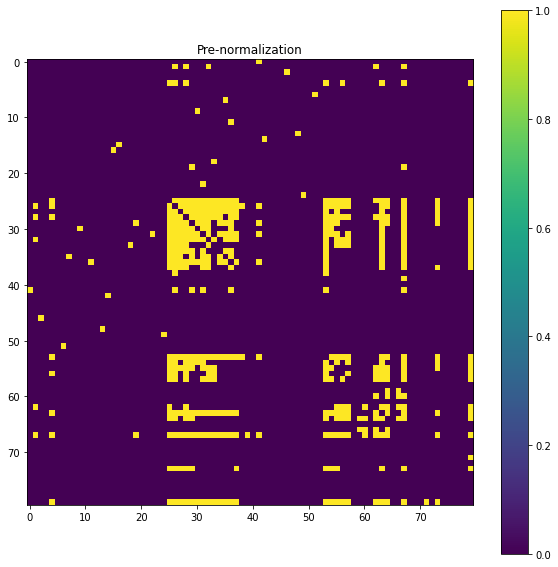

<Figure size 432x288 with 0 Axes>

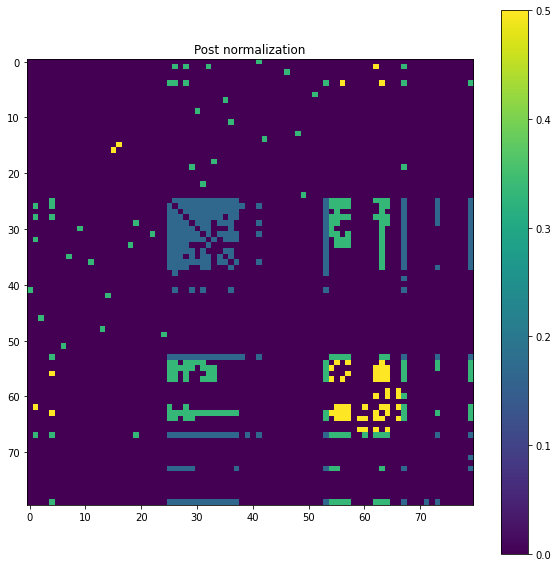

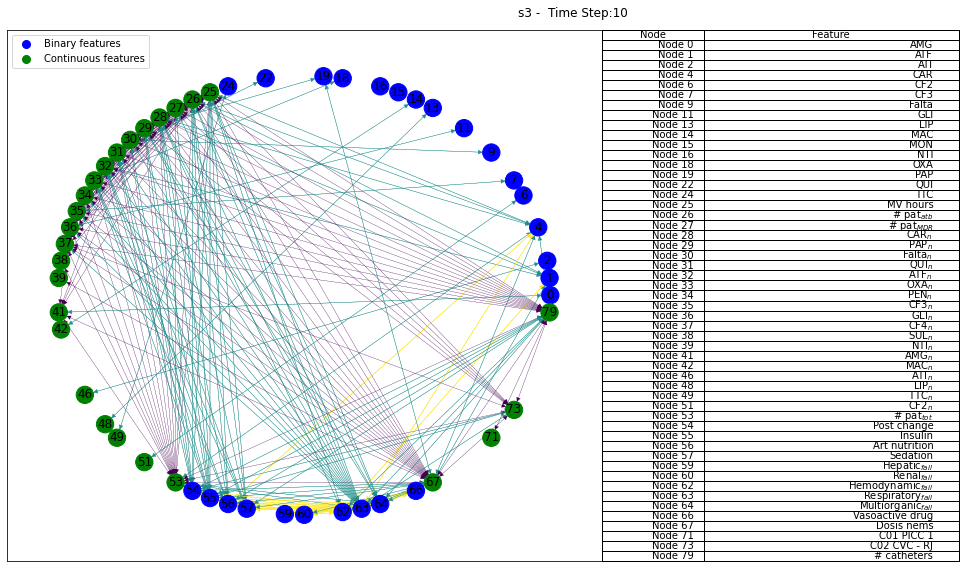

# of edges: 3160 - # of features: 80 - # of max edges: 350


<Figure size 432x288 with 0 Axes>

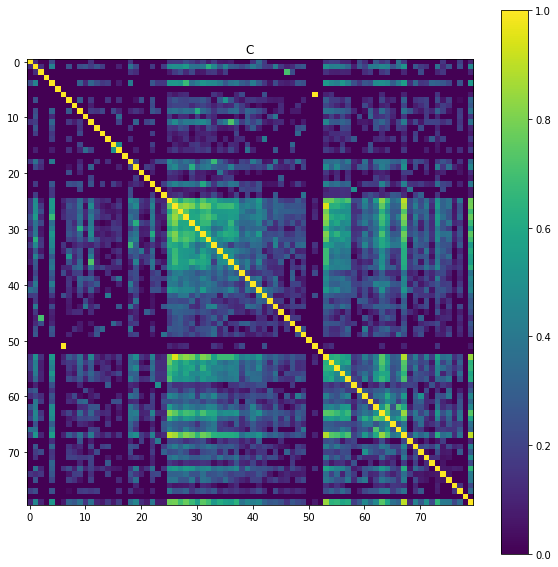

Shape A: (80, 80)
Shape A (1's except diagonal to 0): (80, 80)
1. Create a graph based on previous matrix (1's matrix)
(80, 80)
2. Get the incidence matrix of the previous graph
	shape B01: (3160, 80)
3. Compute C0 as incidence matrix T by covariance matrix by incidence matrix.
C0 shape: (3160, 3160)
4. Obtain the diagonal from the previous calculation
5. Sort the diagonal from smallest to largest, and select the smallest max_E's
6. Obtain a vector of 0's and 1's
7. Get B1_hat as B01 * diag(vec)
8. Obtain A as D - L


<Figure size 432x288 with 0 Axes>

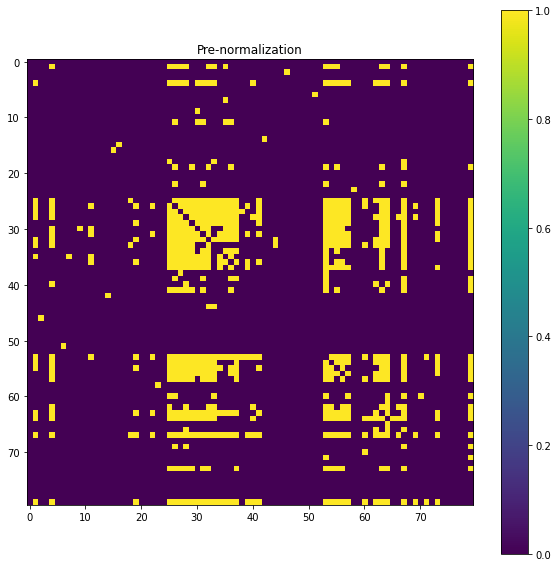

<Figure size 432x288 with 0 Axes>

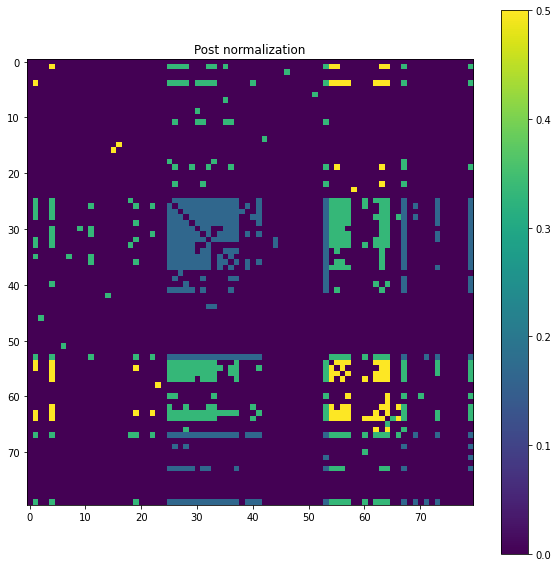

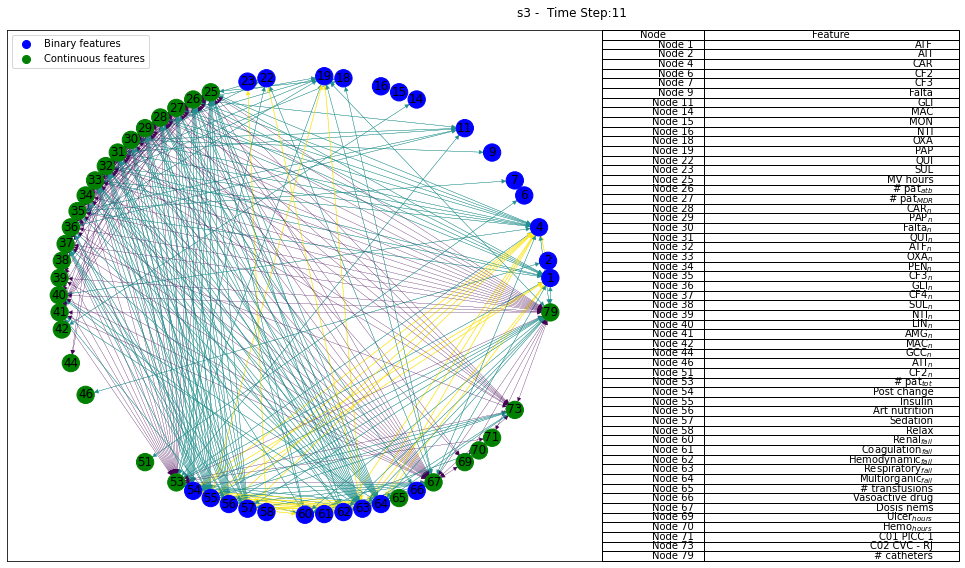

# of edges: 3160 - # of features: 80 - # of max edges: 343


<Figure size 432x288 with 0 Axes>

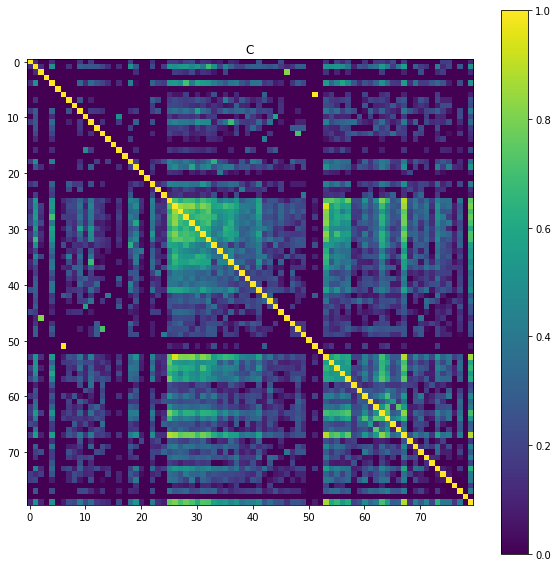

Shape A: (80, 80)
Shape A (1's except diagonal to 0): (80, 80)
1. Create a graph based on previous matrix (1's matrix)
(80, 80)
2. Get the incidence matrix of the previous graph
	shape B01: (3160, 80)
3. Compute C0 as incidence matrix T by covariance matrix by incidence matrix.
C0 shape: (3160, 3160)
4. Obtain the diagonal from the previous calculation
5. Sort the diagonal from smallest to largest, and select the smallest max_E's
6. Obtain a vector of 0's and 1's
7. Get B1_hat as B01 * diag(vec)
8. Obtain A as D - L


<Figure size 432x288 with 0 Axes>

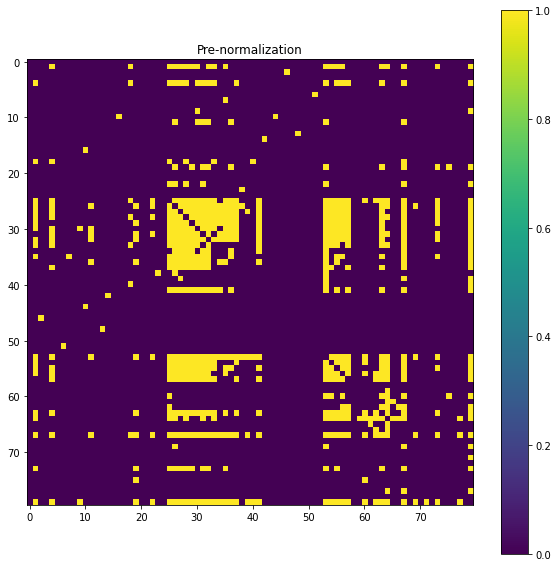

<Figure size 432x288 with 0 Axes>

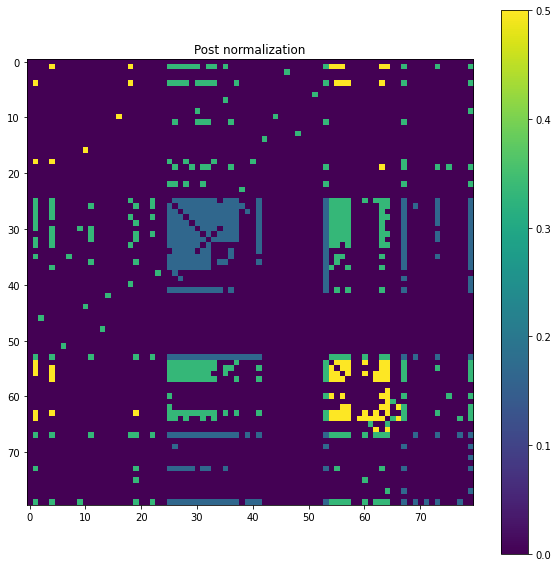

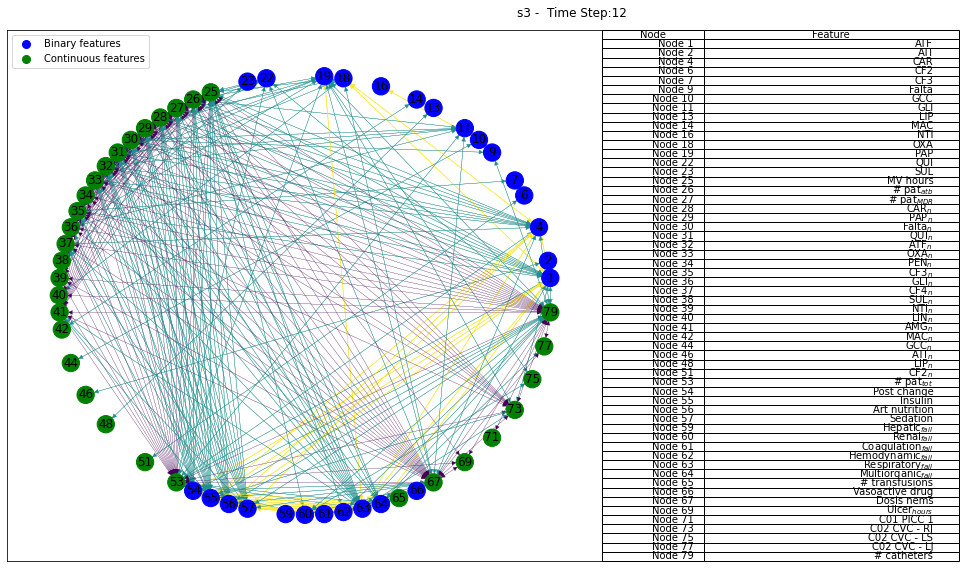

# of edges: 3160 - # of features: 80 - # of max edges: 301


<Figure size 432x288 with 0 Axes>

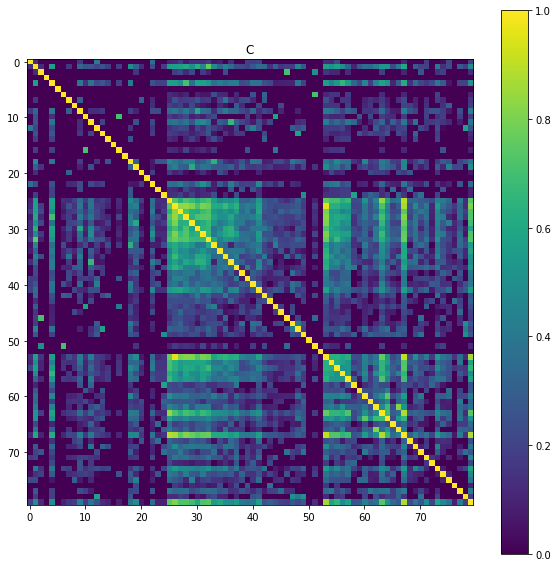

Shape A: (80, 80)
Shape A (1's except diagonal to 0): (80, 80)
1. Create a graph based on previous matrix (1's matrix)
(80, 80)
2. Get the incidence matrix of the previous graph
	shape B01: (3160, 80)
3. Compute C0 as incidence matrix T by covariance matrix by incidence matrix.
C0 shape: (3160, 3160)
4. Obtain the diagonal from the previous calculation
5. Sort the diagonal from smallest to largest, and select the smallest max_E's
6. Obtain a vector of 0's and 1's
7. Get B1_hat as B01 * diag(vec)
8. Obtain A as D - L


<Figure size 432x288 with 0 Axes>

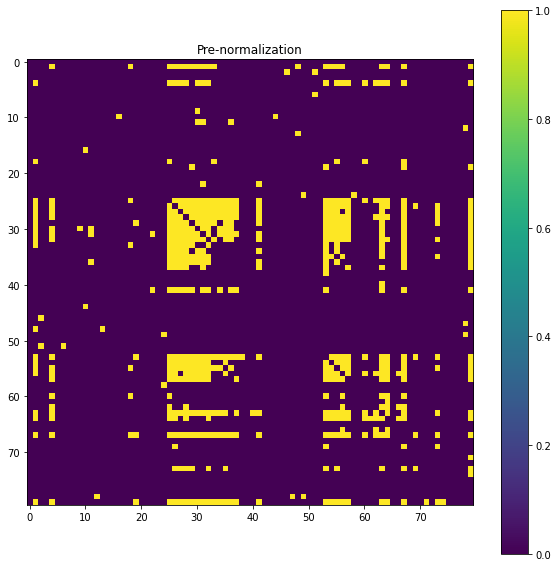

<Figure size 432x288 with 0 Axes>

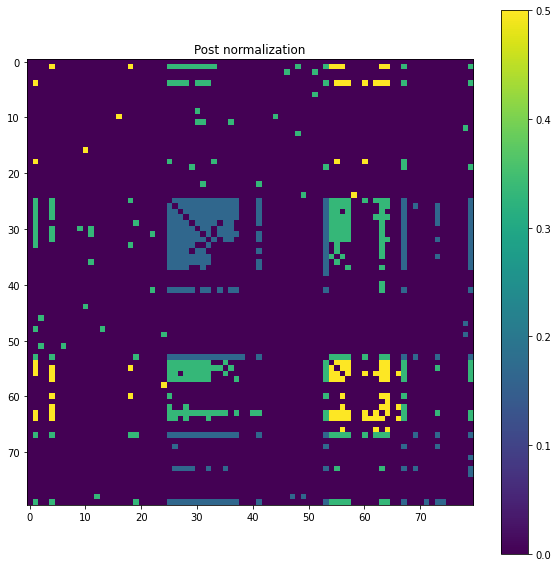

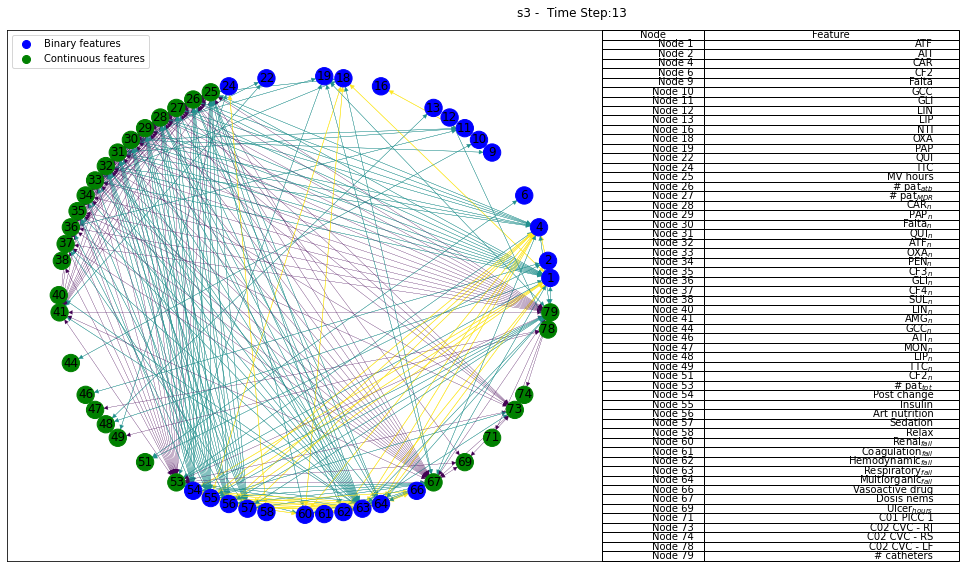

In [7]:
debug_plot_figures = True

for fold in range(len(folders)):
    X_train = np.load("../../DATA/" + folders[fold] + "/X_train_tensor_" + norm + ".npy")
    for nt in range(numberOfTimeStep):
        # Load Data
        x = X_train[:, nt, :]
        
        # Find indices of rows that contain the value 666
        rows_to_remove = np.where((x == 666).any(axis=1))[0]
        
        # Remove rows that contain the value 666
        x = np.delete(x, rows_to_remove, axis=0).T
        
        # Number of features (nodes)
        f = x.shape[0]
        
        # Number of edges
        E = int((f * (f - 1)) / 2)
        max_E = max_E_arr[c][nt]
        print("# of edges:", E, "-", "# of features:", f, "-", "# of max edges:", max_E)
        
        # Identity matrix
        I = np.eye(f)

        C = x @ x.T
        
        # Calculate the standard deviations of the variables
        std_deviations = np.sqrt(np.diag(C))
        
        # Normalize the covariance matrix
        C_norm = C / np.outer(std_deviations, std_deviations)
        C_norm = np.nan_to_num(C_norm)
        C = C_norm
        
        np.fill_diagonal(C, 1)
        
        if debug_plot_figures:
            %matplotlib inline
            plt.figure()
            fig, ax = plt.subplots(1, 1, figsize=(10, 10))
            img = ax.imshow(C)
            fig.colorbar(img)
            plt.title("C")
            plt.show()

        # Create a matrix of ones
        A = np.ones((f, f))
        print("Shape A:", A.shape)
        
        # Set diagonal elements to 0
        np.fill_diagonal(A, 0)
        print("Shape A (1's except diagonal to 0):", A.shape)

        print("=================================================================")
        
        # Create an undirected graph from matrix A
        print("1. Create a graph based on previous matrix (1's matrix)")
        print(A.shape)
        G = nx.from_numpy_matrix(A, create_using=nx.Graph)
        
        # Get the incidence matrix of the graph
        print("2. Get the incidence matrix of the previous graph")
        B01 = nx.incidence_matrix(G, oriented=True).todense()
        print("\tshape B01:", B01.T.shape)
        
        print("3. Compute C0 as incidence matrix T by covariance matrix by incidence matrix.")
        C0 = B01.T * np.array(C) * B01
        print("C0 shape:", C0.shape)
        
        print("4. Obtain the diagonal from the previous calculation")
        diag = np.diag(C0)
        
        print("5. Sort the diagonal from smallest to largest, and select the smallest max_E's")
        # Sort the diagonal elements and get the indices of the sorting
        sort_idxs = np.argsort(diag)
        diag_sort = diag[sort_idxs]
        
        print("6. Obtain a vector of 0's and 1's")
        vec = np.zeros(len(diag))
        vec[sort_idxs[:max_E]] = 1
        
        print("7. Get B1_hat as B01 * diag(vec)")
        B1_hat = B01 * np.diag(vec)
        
        print("8. Obtain A as D - L")
        L_hat = B1_hat * B1_hat.T
        D_hat = np.diag(np.sum(L_hat, axis=1))  # Calculate the diagonal degree matrix
        A_hat = D_hat - L_hat
        np.fill_diagonal(A_hat, 0)

        if debug_plot_figures:
            %matplotlib inline
            plt.figure()
            fig, ax = plt.subplots(1, 1, figsize=(10, 10))
            img = ax.imshow(A_hat)
            fig.colorbar(img)
            plt.title("Pre-normalization")
            plt.show()

        # RENORMALIZE LINKS BASED ON THE NATURE OF THE VARIABLES
        for i in range(f):
            for j in range(f):
                # Numerical variables
                if (keys[i] not in binary) & (keys[j] not in binary):
                    A_hat[i, j] = A_hat[i, j] * (1/6)
                # Discrete variables
                elif (keys[i] in binary) & (keys[j] in binary):   
                    A_hat[i, j] = A_hat[i, j] * (1/2)
                # Binary-continuous or continuous-binary variables
                elif ((keys[i] in binary) & (keys[j] not in binary)) or ((keys[i] not in binary) & (keys[j] in binary)):  
                    A_hat[i, j] = A_hat[i, j] * (1/3)

        if debug_plot_figures:
            %matplotlib inline
            plt.figure()
            fig, ax = plt.subplots(1, 1, figsize=(10, 10))
            img = ax.imshow(A_hat)
            fig.colorbar(img)
            plt.title("Post normalization")
            plt.show()

            # Create a NetworkX graph from the adjacency matrix
            G = nx.from_numpy_matrix(np.array(A_hat), create_using=nx.DiGraph)
            
            # Determine the position of the nodes
            pos = nx.circular_layout(G)
            
            # Get nodes with at least one edge
            nodes_with_edges = [node for node, degree in G.degree() if degree > 0]
            
            # Create a subgraph with only the nodes that have edges
            G_sub = G.subgraph(nodes_with_edges)
            
            # Get the attributes of the edges in the subgraph
            edges, weights = zip(*nx.get_edge_attributes(G_sub, 'weight').items())

            options = {
                "edgelist": edges,
                "edge_color": weights,
                "width": np.array(weights) * 1,
                "alpha": 1,
            }

            # Determine the color of the nodes according to the type of variable
            node_colors = ['blue' if keys[node] in binary else 'green' for node in G_sub.nodes()]
            %matplotlib inline
            # Set up the figure
            fig2, ax2 = plt.subplots(figsize=(16, 8))

            # Draw the subgraph
            nx.draw_networkx(G_sub, pos, node_color=node_colors, **options, ax=ax2)

            # Get the names of the nodes represented
            node_labels = {node: keys[node] for node in G_sub.nodes()}
            
            # Create the table
            table_data = [(f"Node {node}", node_name) for node, node_name in node_labels.items()]
            table = ax2.table(cellText=table_data, loc='center right', colWidths=[0.1, 0.25], 
                              colLabels=['Node', 'Feature'], fontsize=12, bbox=[1, 0, 0.6, 1])

            # Add legend
            legend_labels = {'blue': 'Binary features', 'green': 'Continuous features'}
            legend_handles = [plt.Line2D([0], [0], marker='o', color=color, label=label, markersize=8, linestyle='') for color, label in legend_labels.items()]
            plt.legend(handles=legend_handles, loc='upper left')

            fig2.suptitle(folders[fold] + " - " + " Time Step:" + str(nt))    
            plt.tight_layout()
            plt.show()
        
        pd.DataFrame(A_hat, columns=keys, index=keys).to_csv("./estimatedGraphs/smoothness/" + folders[fold] + "/X_train_TS_" + str(nt) + "_" + norm + "_th_" + str(threshold_val) + ".csv", index=False)


#### B) Same graph for all time steps

In [8]:
threshold_val = 0.975
max_E_arr = [324, 260, 253]

# threshold_val = 0.85
# max_E_arr = [761, 748, 724]

# threshold_val = 0.725
# max_E_arr = [1055, 1000, 982]

# threshold_val = 0.6
# max_E_arr = [1312, 1241, 1240]

# of edges: 3160 - # of features: 80 - # of max edges: 324
Shape A: (80, 80)
Shape A (1's except diagonal to 0): (80, 80)
1. Create a graph based on the previous matrix (1's matrix)
(80, 80)
2. Get the incidence matrix of the previous graph
	shape B01: (3160, 80)
3. Compute C0 as incidence matrix T by covariance matrix by incidence matrix.
C0 shape: (3160, 3160)
4. Obtain the diagonal from the previous calculation
5. Sort the diagonal from smallest to largest, and select the smallest max_E's
6. Obtain a vector of 0's and 1's
7. Get B1_hat as B01 * diag(vec)
8. Obtain A as D - L


<Figure size 432x288 with 0 Axes>

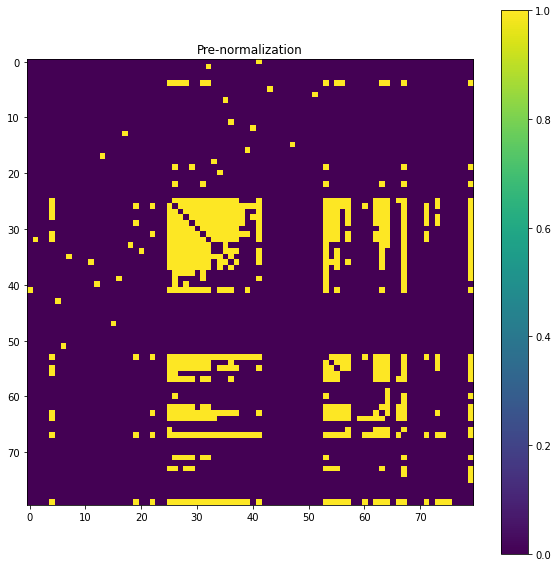

<Figure size 432x288 with 0 Axes>

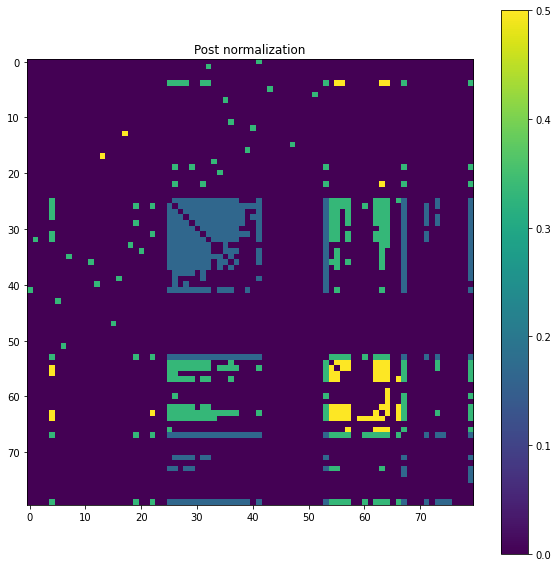

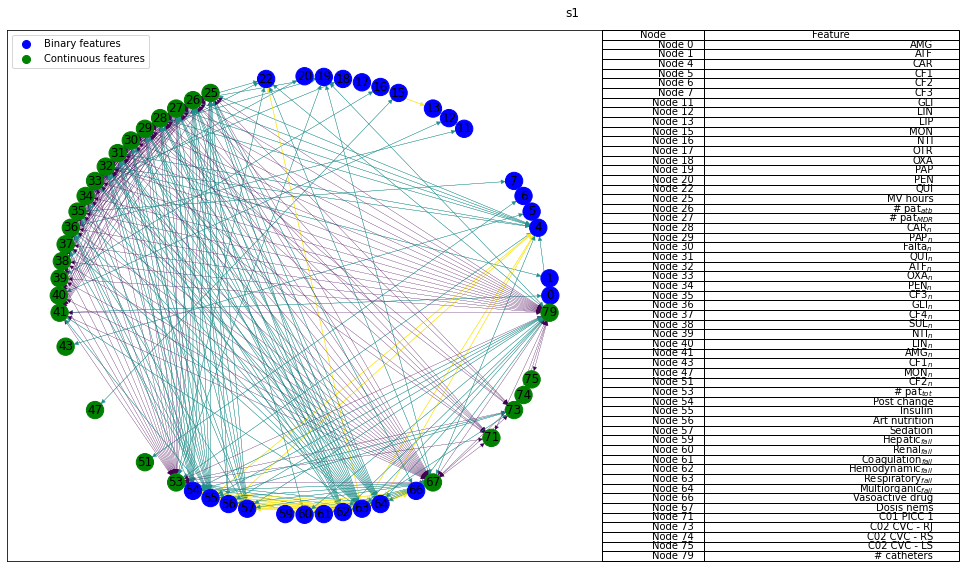

# of edges: 3160 - # of features: 80 - # of max edges: 260
Shape A: (80, 80)
Shape A (1's except diagonal to 0): (80, 80)
1. Create a graph based on the previous matrix (1's matrix)
(80, 80)
2. Get the incidence matrix of the previous graph
	shape B01: (3160, 80)
3. Compute C0 as incidence matrix T by covariance matrix by incidence matrix.
C0 shape: (3160, 3160)
4. Obtain the diagonal from the previous calculation
5. Sort the diagonal from smallest to largest, and select the smallest max_E's
6. Obtain a vector of 0's and 1's
7. Get B1_hat as B01 * diag(vec)
8. Obtain A as D - L


<Figure size 432x288 with 0 Axes>

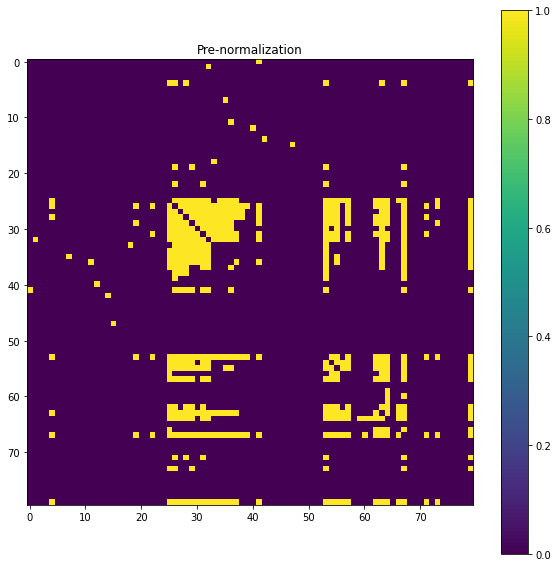

<Figure size 432x288 with 0 Axes>

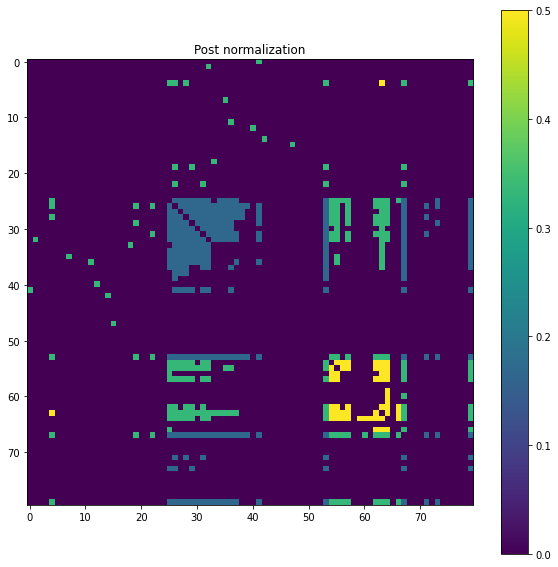

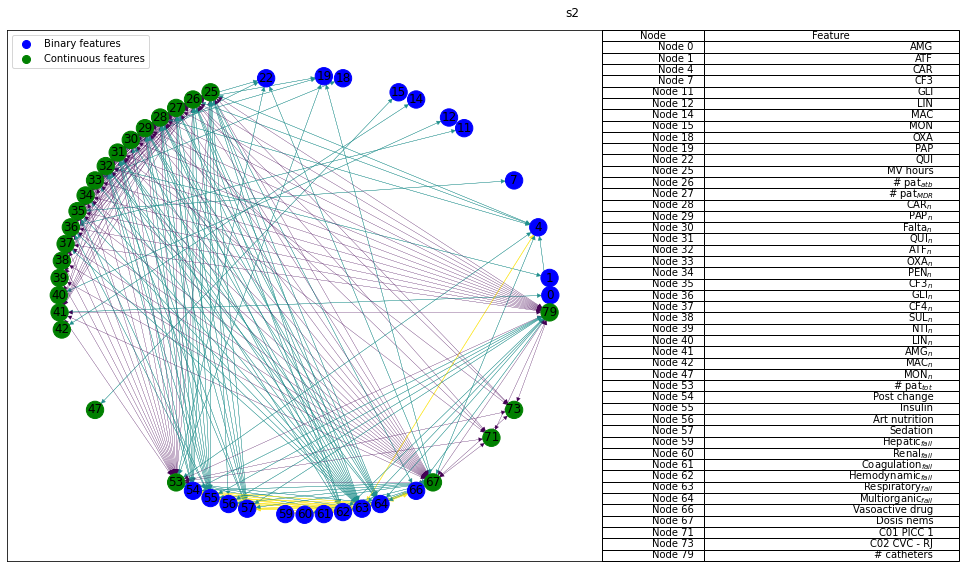

# of edges: 3160 - # of features: 80 - # of max edges: 253
Shape A: (80, 80)
Shape A (1's except diagonal to 0): (80, 80)
1. Create a graph based on the previous matrix (1's matrix)
(80, 80)
2. Get the incidence matrix of the previous graph
	shape B01: (3160, 80)
3. Compute C0 as incidence matrix T by covariance matrix by incidence matrix.
C0 shape: (3160, 3160)
4. Obtain the diagonal from the previous calculation
5. Sort the diagonal from smallest to largest, and select the smallest max_E's
6. Obtain a vector of 0's and 1's
7. Get B1_hat as B01 * diag(vec)
8. Obtain A as D - L


<Figure size 432x288 with 0 Axes>

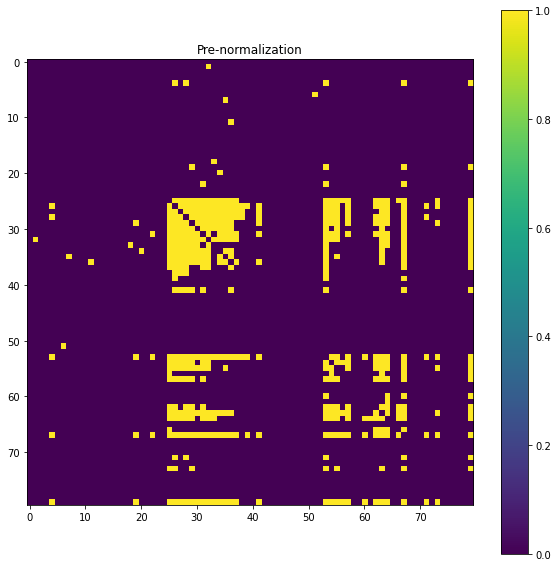

<Figure size 432x288 with 0 Axes>

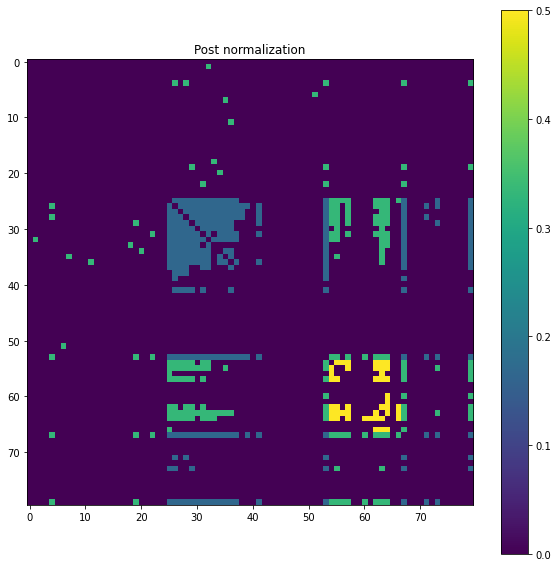

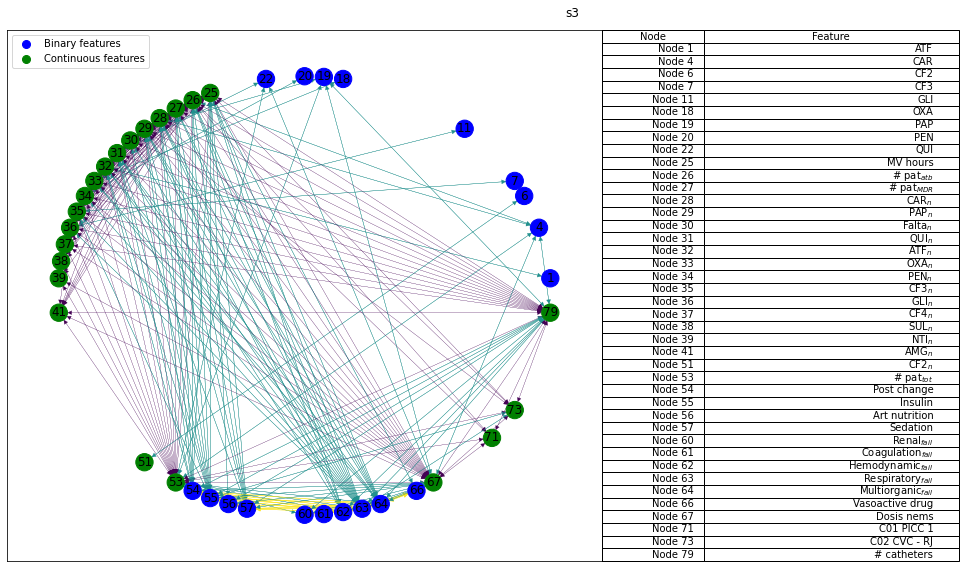

In [9]:
debug_plot_figures = True 

for fold in range(len(folders)):
    X_train = np.load("../../DATA/" + folders[fold] + "/X_train_tensor_" + norm + ".npy")
    x = np.reshape(X_train, (X_train.shape[0] * X_train.shape[1], X_train.shape[2]))
    
    # Find rows that have all values equal to 666
    rows_to_remove = np.where((x == 666).all(axis=1))[0]
    
    # Remove rows that meet the condition
    x_filter = np.delete(x, rows_to_remove, axis=0)
    x = x_filter.T
    
    # Number of features (nodes)
    f = x.shape[0]
    
    # Number of edges
    E = int((f * (f - 1)) / 2)
    max_E = max_E_arr[c]
    
    print("# of edges:", E, "-", "# of features:", f, "-", "# of max edges:", max_E)
    
    # Identity matrix
    I = np.eye(f)

    C = x @ x.T
    
    # Calculate the standard deviations of the variables
    std_deviations = np.sqrt(np.diag(C))
    
    # Normalize the covariance matrix
    C_norm = C / np.outer(std_deviations, std_deviations)
    C_norm = np.nan_to_num(C_norm)
    C = C_norm
    
    np.fill_diagonal(C, 1)

    # Create a matrix of ones
    A = np.ones((f, f))
    print("Shape A:", A.shape)
    
    # Set diagonal elements to 0
    np.fill_diagonal(A, 0)
    print("Shape A (1's except diagonal to 0):", A.shape)

    print("=================================================================")
    
    # Create an undirected graph from matrix A
    print("1. Create a graph based on the previous matrix (1's matrix)")
    print(A.shape)
    G = nx.from_numpy_matrix(A, create_using=nx.Graph)
    
    # Get the incidence matrix of the graph
    print("2. Get the incidence matrix of the previous graph")
    B01 = nx.incidence_matrix(G, oriented=True).todense()
    print("\tshape B01:", B01.T.shape)
    
    print("3. Compute C0 as incidence matrix T by covariance matrix by incidence matrix.")
    C0 = B01.T * np.array(C) * B01
    print("C0 shape:", C0.shape)
    
    print("4. Obtain the diagonal from the previous calculation")
    diag = np.diag(C0)
    
    print("5. Sort the diagonal from smallest to largest, and select the smallest max_E's")
    # Sort the diagonal elements and get the indices of the sorting
    sort_idxs = np.argsort(diag)
    diag_sort = diag[sort_idxs]
    
    print("6. Obtain a vector of 0's and 1's")
    vec = np.zeros(len(diag))
    vec[sort_idxs[:max_E]] = 1
    
    print("7. Get B1_hat as B01 * diag(vec)")
    B1_hat = B01 * np.diag(vec)
    
    print("8. Obtain A as D - L")
    L_hat = B1_hat * B1_hat.T
    D_hat = np.diag(np.sum(L_hat, axis=1))  # Calculate the diagonal degree matrix
    A_hat = D_hat - L_hat
    np.fill_diagonal(A_hat, 0)

    if debug_plot_figures:
        %matplotlib inline
        plt.figure()
        fig, ax = plt.subplots(1, 1, figsize=(10, 10))
        img = ax.imshow(A_hat)
        fig.colorbar(img)
        plt.title("Pre-normalization")
        plt.show()

    # NORMALIZE THE LINKS BASED ON THE NATURE OF THE VARIABLES
    for i in range(f):
        for j in range(f):
            # Numerical variables
            if (keys[i] not in binary) & (keys[j] not in binary):
                A_hat[i, j] = A_hat[i, j] * (1/6)
            # Discrete variables
            elif (keys[i] in binary) & (keys[j] in binary):   
                A_hat[i, j] = A_hat[i, j] * (1/2)
            # Binary-continuous or continuous-binary variables
            elif ((keys[i] in binary) & (keys[j] not in binary)) or ((keys[i] not in binary) & (keys[j] in binary)):  
                A_hat[i, j] = A_hat[i, j] * (1/3)

    if debug_plot_figures:
        %matplotlib inline
        plt.figure()
        fig, ax = plt.subplots(1, 1, figsize=(10, 10))
        img = ax.imshow(A_hat)
        fig.colorbar(img)
        plt.title("Post normalization")
        plt.show()

        # Create a NetworkX graph from the adjacency matrix
        G = nx.from_numpy_matrix(np.array(A_hat), create_using=nx.DiGraph)
        
        # Determine the position of the nodes
        pos = nx.circular_layout(G)
        
        # Get nodes with at least one edge
        nodes_with_edges = [node for node, degree in G.degree() if degree > 0]
        
        # Create a subgraph with only the nodes that have edges
        G_sub = G.subgraph(nodes_with_edges)
        
        # Get the attributes of the edges in the subgraph
        edges, weights = zip(*nx.get_edge_attributes(G_sub, 'weight').items())

        options = {
            "edgelist": edges,
            "edge_color": weights,
            "width": np.array(weights) * 1,
            "alpha": 1,
        }

        # Determine the color of the nodes according to the type of variable
        node_colors = ['blue' if keys[node] in binary else 'green' for node in G_sub.nodes()]
        %matplotlib inline
        # Set up the figure
        fig2, ax2 = plt.subplots(figsize=(16, 8))

        # Draw the subgraph
        nx.draw_networkx(G_sub, pos, node_color=node_colors, **options, ax=ax2)

        # Get the names of the nodes represented
        node_labels = {node: keys[node] for node in G_sub.nodes()}
        
        # Create the table
        table_data = [(f"Node {node}", node_name) for node, node_name in node_labels.items()]
        table = ax2.table(cellText=table_data, loc='center right', colWidths=[0.1, 0.25], 
                          colLabels=['Node', 'Feature'], fontsize=12, bbox=[1, 0, 0.6, 1])

        # Add legend
        legend_labels = {'blue': 'Binary features', 'green': 'Continuous features'}
        legend_handles = [plt.Line2D([0], [0], marker='o', color=color, label=label, markersize=8, linestyle='') for color, label in legend_labels.items()]
        plt.legend(handles=legend_handles, loc='upper left')

        fig2.suptitle(folders[fold])    
        plt.tight_layout()
        plt.show()
    
    pd.DataFrame(A_hat, columns=keys, index=keys).to_csv("./estimatedGraphs/smoothness/" + folders[fold] + "/X_train_allMTS_" + norm + "_th_" + str(threshold_val) + ".csv", index=False)